## Investigating genes involved in mucosal healing in MUC6 and MUC5AC cells

In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import sys
import os
from collections import Counter
import gseapy

import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import to_hex
import ast

import gseapy

In [2]:
import random

In [3]:
sc.logging.print_header()

scanpy==1.8.0 anndata==0.8.0 umap==0.4.6 numpy==1.20.1 scipy==1.6.1 pandas==1.3.0 scikit-learn==0.24.1 statsmodels==0.12.2 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3


In [4]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42

In [5]:
gene_set_names = gseapy.get_library_name(organism='Human')
print(gene_set_names)

['ARCHS4_Cell-lines', 'ARCHS4_IDG_Coexp', 'ARCHS4_Kinases_Coexp', 'ARCHS4_TFs_Coexp', 'ARCHS4_Tissues', 'Achilles_fitness_decrease', 'Achilles_fitness_increase', 'Aging_Perturbations_from_GEO_down', 'Aging_Perturbations_from_GEO_up', 'Allen_Brain_Atlas_10x_scRNA_2021', 'Allen_Brain_Atlas_down', 'Allen_Brain_Atlas_up', 'Azimuth_2023', 'Azimuth_Cell_Types_2021', 'BioCarta_2013', 'BioCarta_2015', 'BioCarta_2016', 'BioPlanet_2019', 'BioPlex_2017', 'CCLE_Proteomics_2020', 'CORUM', 'COVID-19_Related_Gene_Sets', 'COVID-19_Related_Gene_Sets_2021', 'Cancer_Cell_Line_Encyclopedia', 'CellMarker_Augmented_2021', 'ChEA_2013', 'ChEA_2015', 'ChEA_2016', 'ChEA_2022', 'Chromosome_Location', 'Chromosome_Location_hg19', 'ClinVar_2019', 'DSigDB', 'Data_Acquisition_Method_Most_Popular_Genes', 'DepMap_WG_CRISPR_Screens_Broad_CellLines_2019', 'DepMap_WG_CRISPR_Screens_Sanger_CellLines_2019', 'Descartes_Cell_Types_and_Tissue_2021', 'Diabetes_Perturbations_GEO_2022', 'DisGeNET', 'Disease_Perturbations_from_GEO

In [6]:
full_adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/pooled_healthy_disease.plus_additional_epi.18485genes.with_fineannot.nodoublets.20230322.h5ad')

In [7]:
full_adata.obs = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/pooled_healthy_disease.plus_additional_epi.18485genes.with_fineannot.nodoublets.20230322.csv',index_col=0)

/home/jovyan/my-conda-envs/standard_plot_gsea/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3437: DtypeWarning: Columns (3,5,6,8,9,11,12,14,62,63,64,65,66,67,70,73,75,82,83,84,86,92,93,95,100,101,102,105,106,108,109,111,112,113,114,115,117,119,123,124,125,126,127,128,129,130,131,132,133) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [8]:
full_adata

AnnData object with n_obs × n_vars = 1596203 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_s

In [9]:
full_muc6 = full_adata[full_adata.obs.level_3_annot.isin(['Mucous_gland_neck'])].copy()

In [10]:
full_muc6

AnnData object with n_obs × n_vars = 19058 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

In [11]:
full_muc5ac = full_adata[full_adata.obs.level_3_annot.isin(['Surface_foveolar'])].copy()

In [12]:
full_muc5ac

AnnData object with n_obs × n_vars = 15656 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

In [13]:
df = full_muc5ac.obs

In [14]:
df.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/DEG/counts/all_muc5ac_cells_rawcounts_20230613.csv')

In [15]:
del full_muc5ac.obs

In [16]:
full_muc5ac.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/pooled_compartments/all_muc5ac_cells_rawcounts_20230613.h5ad')

In [17]:
full_muc5ac.obs = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/DEG/counts/all_muc5ac_cells_rawcounts_20230613.csv',index_col=0)

/home/jovyan/my-conda-envs/standard_plot_gsea/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3437: DtypeWarning: Columns (62,63,64,65,66,67,70,84,100,101,102,105,112,113,114,115,117,119,123,124,125,126,127,128,129,130,131,132,133) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [18]:
full_muc6.X.max()

18131.0

In [19]:
full_muc5ac.X.max()

4137.0

In [20]:
sc.pp.normalize_per_cell(full_muc6, counts_per_cell_after=1e4)
sc.pp.log1p(full_muc6)

In [21]:
sc.pp.normalize_per_cell(full_muc5ac, counts_per_cell_after=1e4)
sc.pp.log1p(full_muc5ac)

In [22]:
sc.pp.neighbors(full_muc6, use_rep="X_scANVI")
sc.tl.umap(full_muc6)

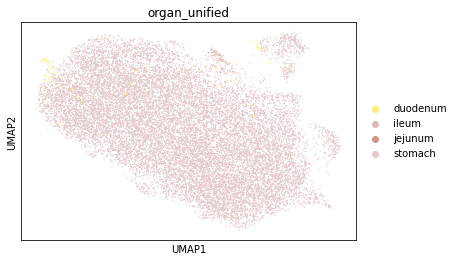

In [23]:
sc.pl.umap(full_muc6,color='organ_unified')

In [24]:
sc.pp.neighbors(full_muc5ac, use_rep="X_scANVI")
sc.tl.umap(full_muc5ac)

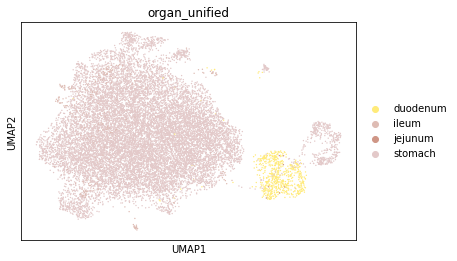

In [25]:
sc.pl.umap(full_muc5ac,color='organ_unified')

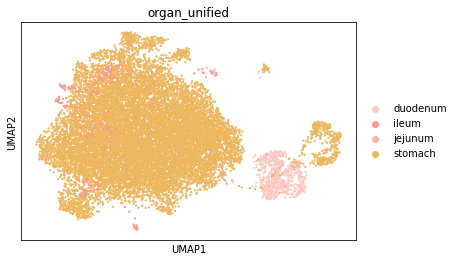

In [26]:
sc.pl.umap(full_muc5ac,color='organ_unified',palette={
  'stomach': '#edb75f',
  'duodenum': '#fec8c1',
  'jejunum': '#feb2a8',
  'ileum': '#fc9a8d'},size=20)

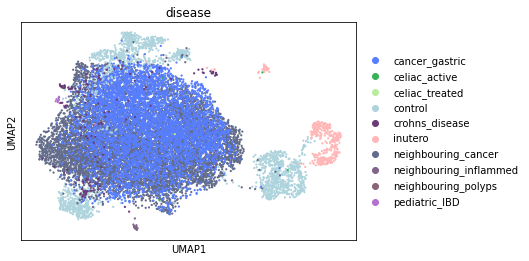

In [27]:
sc.pl.umap(full_muc5ac,color='disease',palette = {'control': '#ADD3DD',
  'inutero': '#ffb7b7',
  'cancer_gastric': '#577eff',
  'crohns_disease': '#693C78',
  'pediatric_IBD': '#B670CD',
  'ulcerative_colitis': '#8934B1',
  'cancer_colorectal': '#1131bf',
  'preterm': '#f48154',
  'celiac_active': '#38B257',
  'celiac_treated': '#b8ed9d',
    'neighbouring_cancer': '#636c8a',
  'neighbouring_polyps': '#8a6375',
  'neighbouring_inflammed': '#82638a'               },size=20)


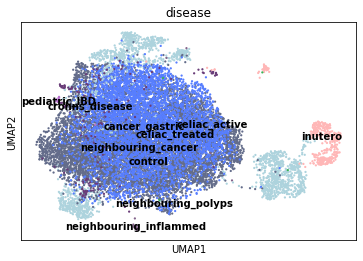

In [28]:
sc.pl.umap(full_muc5ac,color='disease',palette = {'control': '#ADD3DD',
  'inutero': '#ffb7b7',
  'cancer_gastric': '#577eff',
  'crohns_disease': '#693C78',
  'pediatric_IBD': '#B670CD',
  'ulcerative_colitis': '#8934B1',
  'cancer_colorectal': '#1131bf',
  'preterm': '#f48154',
  'celiac_active': '#38B257',
  'celiac_treated': '#b8ed9d',
    'neighbouring_cancer': '#636c8a',
  'neighbouring_polyps': '#8a6375',
  'neighbouring_inflammed': '#82638a'               },size=20,legend_loc='on data')


In [29]:
full_muc5ac.obs['organ_disease']= full_muc5ac.obs['organ_unified'].astype(str)+'_'+full_muc5ac.obs['disease'].astype(str)
full_muc5ac.obs.organ_disease.value_counts()

stomach_neighbouring_cancer     8048
stomach_cancer_gastric          5121
stomach_control                 1144
duodenum_control                 633
stomach_inutero                  394
ileum_crohns_disease             157
ileum_control                     91
ileum_neighbouring_inflammed      30
ileum_pediatric_IBD               14
jejunum_control                    8
duodenum_inutero                   7
duodenum_celiac_active             4
ileum_neighbouring_cancer          2
ileum_neighbouring_polyps          1
ileum_inutero                      1
duodenum_celiac_treated            1
Name: organ_disease, dtype: int64

In [30]:
full_muc5ac.obs['organ_disease'] = full_muc5ac.obs['organ_disease'].astype('category')

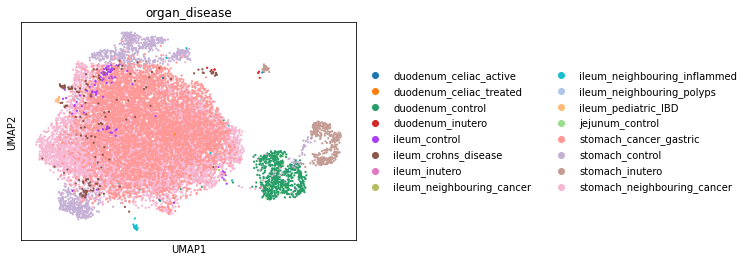

In [31]:
sc.pl.umap(full_muc5ac,color='organ_disease',size=20)

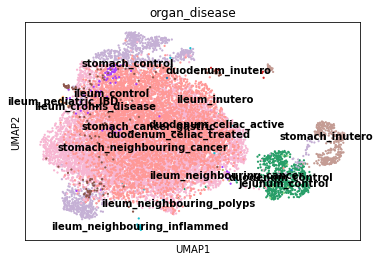

In [32]:
sc.pl.umap(full_muc5ac,color='organ_disease',size=20,legend_loc='on data')

In [33]:
full_muc5ac.obs.organ_disease.value_counts()

stomach_neighbouring_cancer     8048
stomach_cancer_gastric          5121
stomach_control                 1144
duodenum_control                 633
stomach_inutero                  394
ileum_crohns_disease             157
ileum_control                     91
ileum_neighbouring_inflammed      30
ileum_pediatric_IBD               14
jejunum_control                    8
duodenum_inutero                   7
duodenum_celiac_active             4
ileum_neighbouring_cancer          2
duodenum_celiac_treated            1
ileum_inutero                      1
ileum_neighbouring_polyps          1
Name: organ_disease, dtype: int64

In [34]:
import sctk as sk

In [35]:
#for plotting, remove categories with less than 2 cells
plot_full_muc5ac = full_muc5ac[~full_muc5ac.obs.organ_disease.isin(['ileum_neighbouring_cancer',
'ileum_inutero',
'duodenum_celiac_treated','ileum_neighbouring_polyps'])].copy()

In [36]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
plt.rcParams['figure.figsize'] = [5,5]
sc.set_figure_params(dpi=150,dpi_save=300)

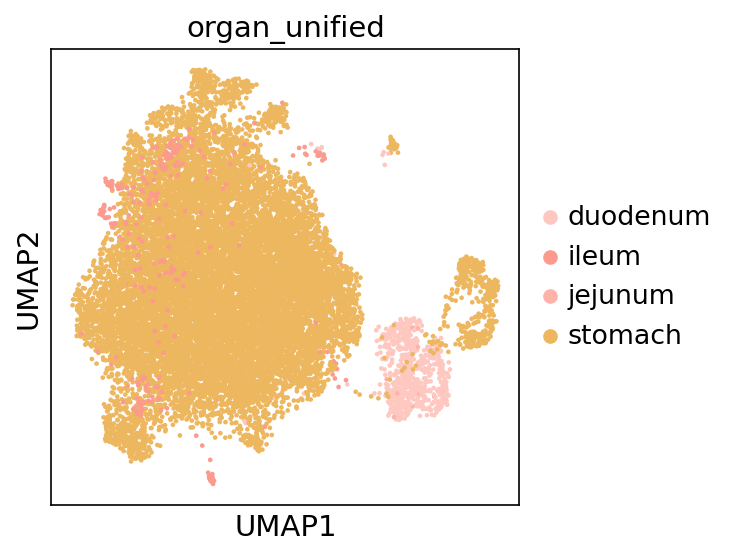

In [37]:
sc.pl.umap(plot_full_muc5ac,color='organ_unified',palette={
  'stomach': '#edb75f',
  'duodenum': '#fec8c1',
  'ileum': '#fc9a8d',
'jejunum': '#feb2a8'},size=20,save='full_muc5ac_organ1.pdf')

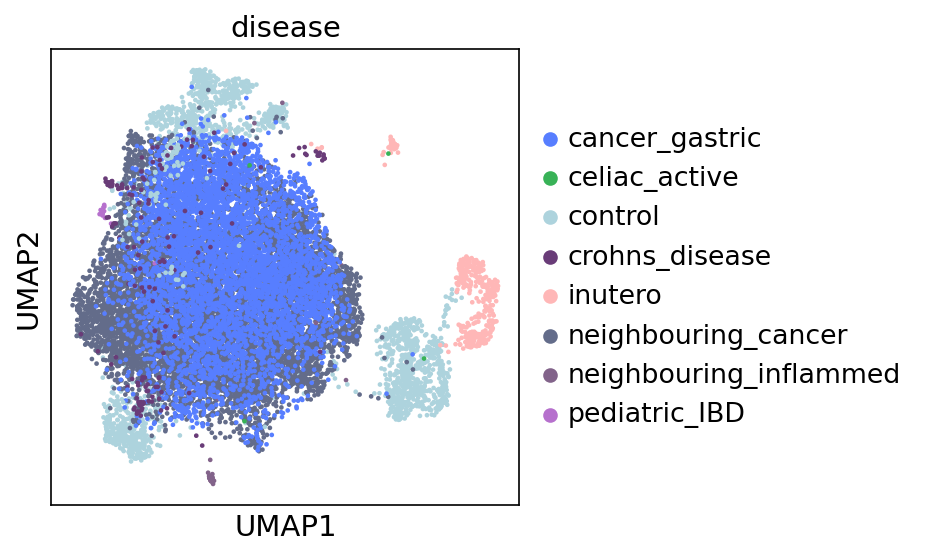

In [38]:
sc.pl.umap(plot_full_muc5ac,color='disease',palette = {'control': '#ADD3DD',
  'inutero': '#ffb7b7',
  'cancer_gastric': '#577eff',
  'crohns_disease': '#693C78',
  'pediatric_IBD': '#B670CD',
  'ulcerative_colitis': '#8934B1',
  'cancer_colorectal': '#1131bf',
  'preterm': '#f48154',
  'celiac_active': '#38B257',
  'celiac_treated': '#b8ed9d',
    'neighbouring_cancer': '#636c8a',
  'neighbouring_polyps': '#8a6375',
  'neighbouring_inflammed': '#82638a'               },size=20,save='full_muc5ac_disease1.pdf')


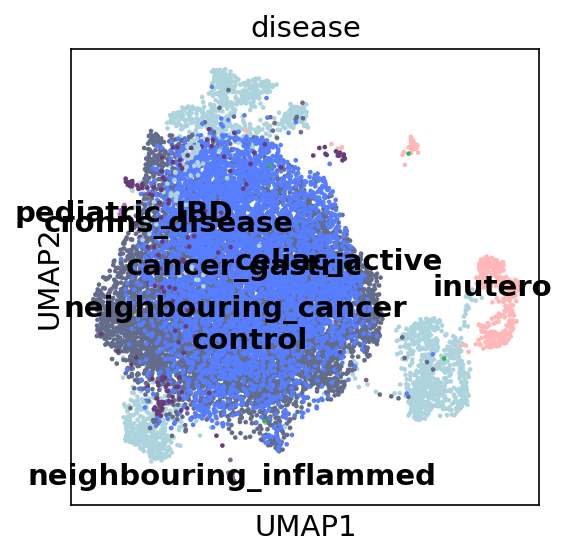

In [39]:
sc.pl.umap(plot_full_muc5ac,color='disease',size=20,legend_loc='on data',save='full_muc5ac_disease_legendloc.pdf')

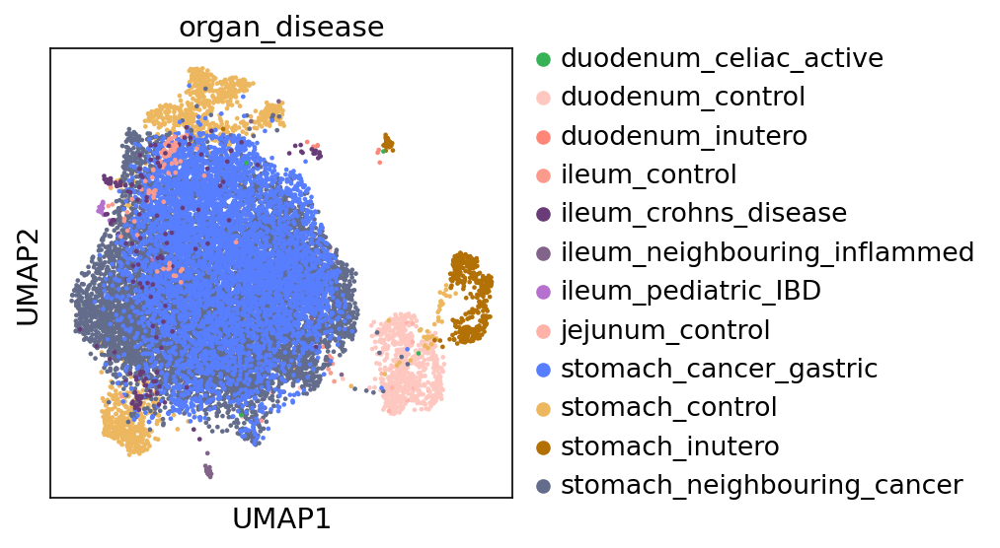

In [40]:
sc.pl.umap(plot_full_muc5ac,color='organ_disease',size=20,palette={'duodenum_control': '#fec8c1',
           'stomach_control': '#edb75f',
  'duodenum_inutero': '#ff8778',
            'stomach_inutero': '#b37004',
  'stomach_cancer_gastric': '#577eff',
  'ileum_crohns_disease': '#693C78',
  'ileum_pediatric_IBD': '#B670CD',
  
 
  'duodenum_celiac_active': '#38B257',
  
    'stomach_neighbouring_cancer': '#636c8a',
  
  'ileum_neighbouring_inflammed': '#82638a' ,
     'ileum_control':'#fc9a8d','jejunum_control':'#feb2a8'} ,save='full_muc5ac_organdisease1.pdf'       )

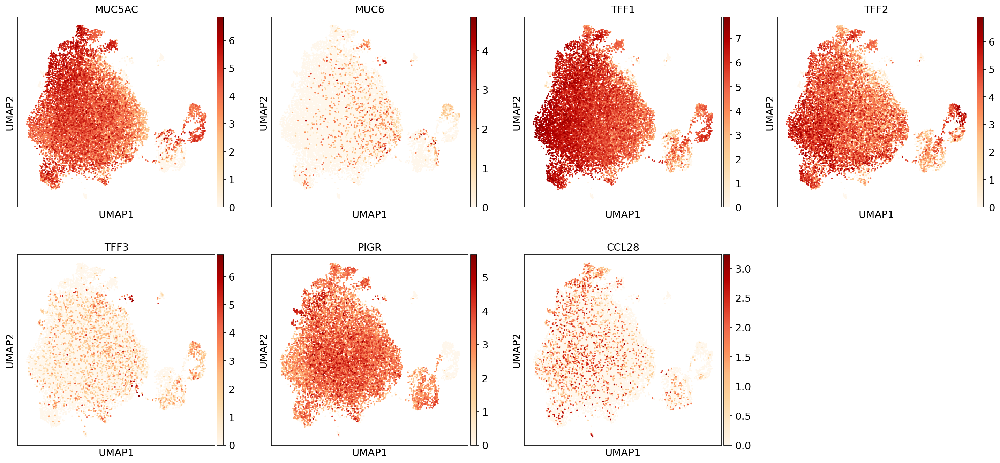

In [41]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(plot_full_muc5ac,color=['MUC5AC','MUC6','TFF1','TFF2','TFF3','PIGR','CCL28'],size=20,cmap='OrRd')

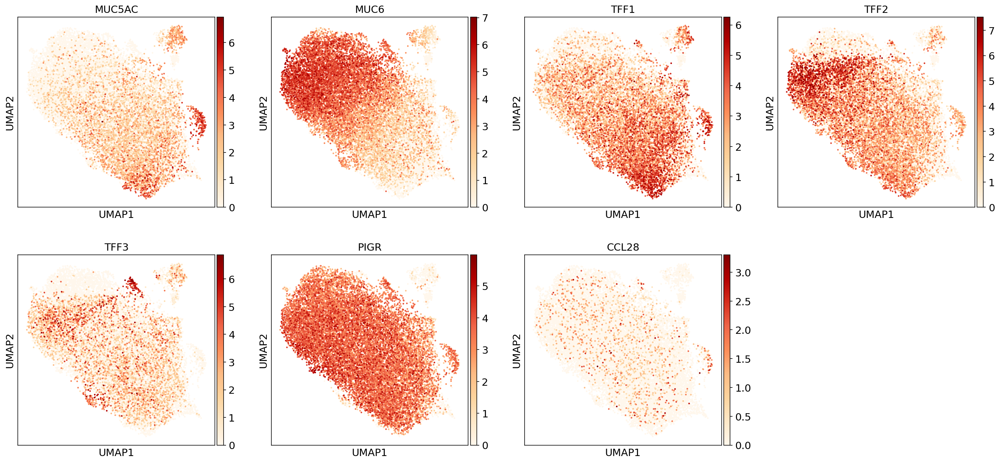

In [42]:
sc.pl.umap(full_muc6,color=['MUC5AC','MUC6','TFF1','TFF2','TFF3','PIGR','CCL28'],size=20,cmap='OrRd')

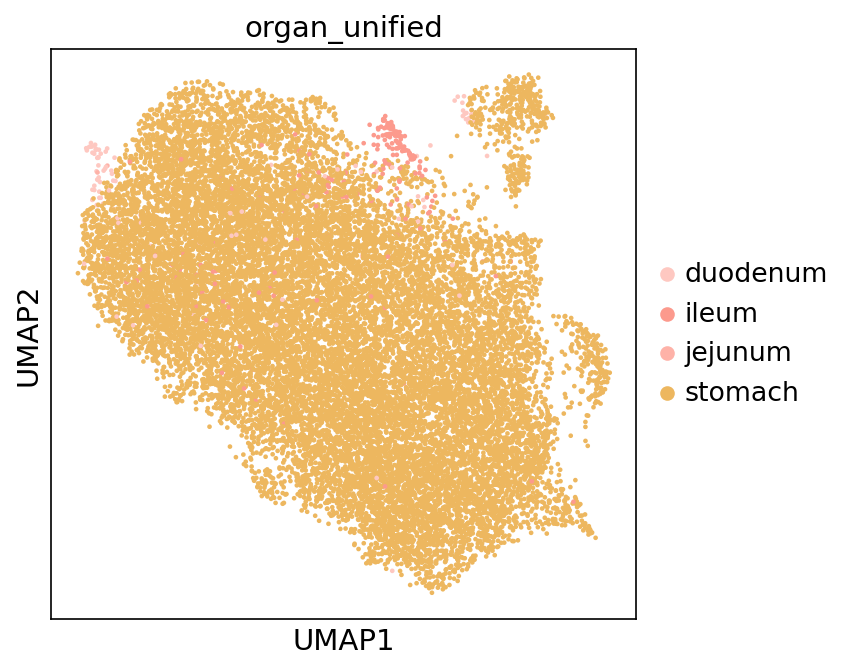

In [43]:
sc.pl.umap(full_muc6,color='organ_unified',palette={
  'stomach': '#edb75f',
  'duodenum': '#fec8c1',
  'jejunum': '#feb2a8',
  'ileum': '#fc9a8d'},size=20)

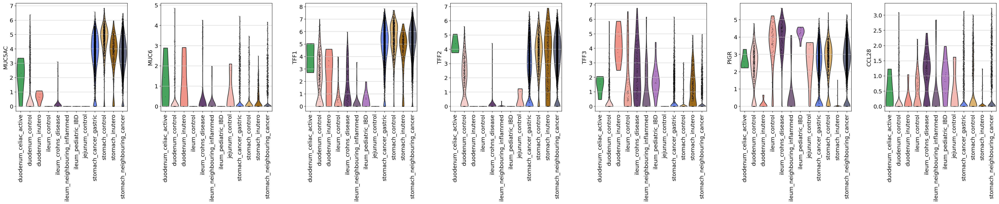

In [44]:
sc.pl.violin(plot_full_muc5ac,keys=['MUC5AC','MUC6','TFF1','TFF2','TFF3','PIGR','CCL28'],groupby='organ_disease',rotation=90)

In [45]:
epi = full_adata[full_adata.obs.level_1_annot.isin(['Epithelial'])].copy()

In [46]:
epi.obs['organ_disease']= epi.obs['organ_unified'].astype(str)+'_'+epi.obs['disease'].astype(str)
epi.obs.organ_disease.value_counts()

oesophagus_control                         104797
ileum_neighbouring_inflammed               103590
ileum_control                               50766
stomach_neighbouring_cancer                 39783
ascending colon_control                     26558
stomach_cancer_gastric                      26252
colon_control                               24885
ileum_crohns_disease                        24478
ileum_inutero                               23626
duodenum_inutero                            23555
transverse colon_control                    19012
descending colon_neighbouring_inflammed     16484
ascending colon_neighbouring_inflammed      14709
colon_neighbouring_inflammed                13327
duodenum_control                            12671
sigmoid colon_control                       11963
colon_inutero                                8894
ileum_neighbouring_cancer                    8121
salivary gland_control                       7946
jejunum_control                              7456


In [47]:
cd = epi[epi.obs.organ_disease.isin(['ileum_crohns_disease'])].copy()

In [48]:
cd

AnnData object with n_obs × n_vars = 24478 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

In [49]:
sc.pp.normalize_per_cell(cd, counts_per_cell_after=1e4)
sc.pp.log1p(cd)

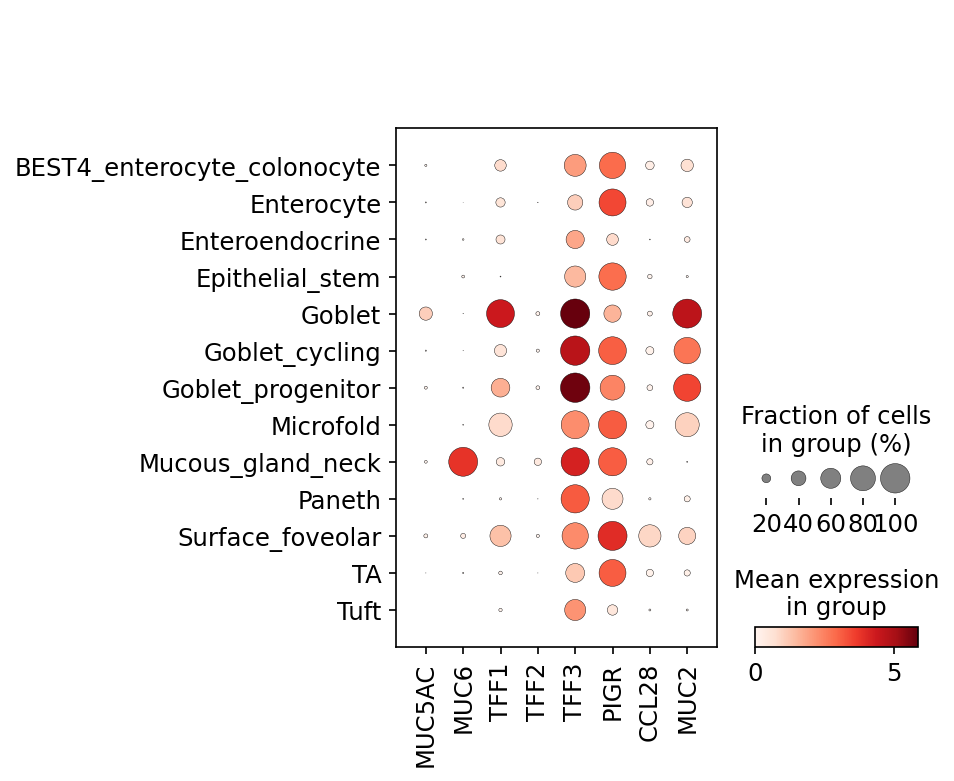

In [50]:
sc.pl.dotplot(cd,var_names=['MUC5AC','MUC6','TFF1','TFF2','TFF3','PIGR','CCL28','MUC2'],groupby='level_3_annot')

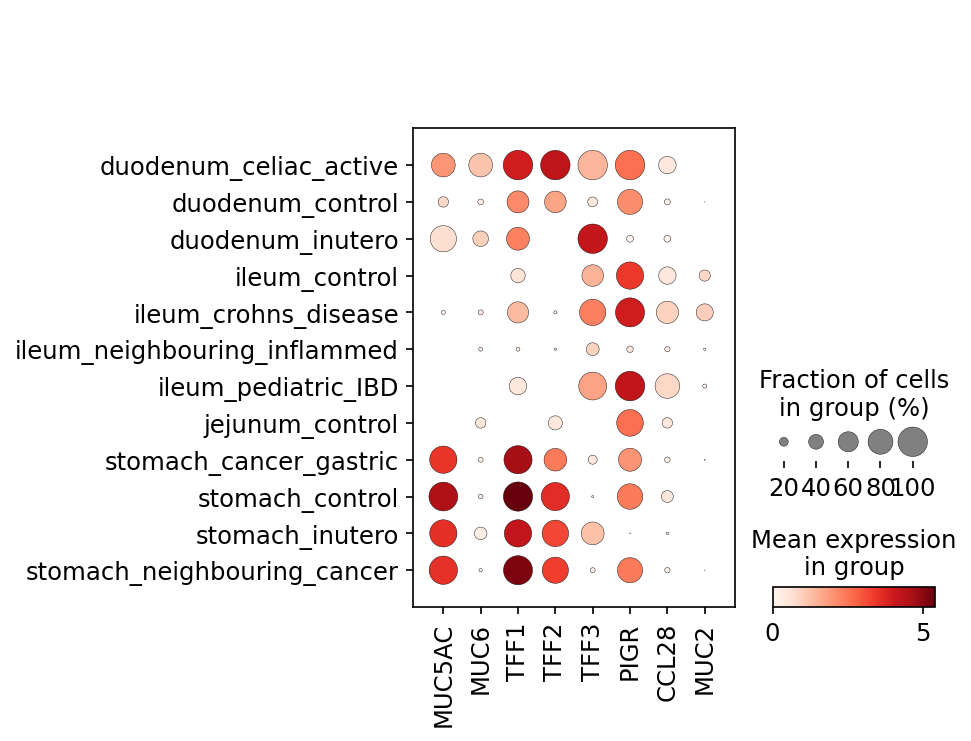

In [51]:
sc.pl.dotplot(plot_full_muc5ac,var_names=['MUC5AC','MUC6','TFF1','TFF2','TFF3','PIGR','CCL28','MUC2'],groupby='organ_disease')

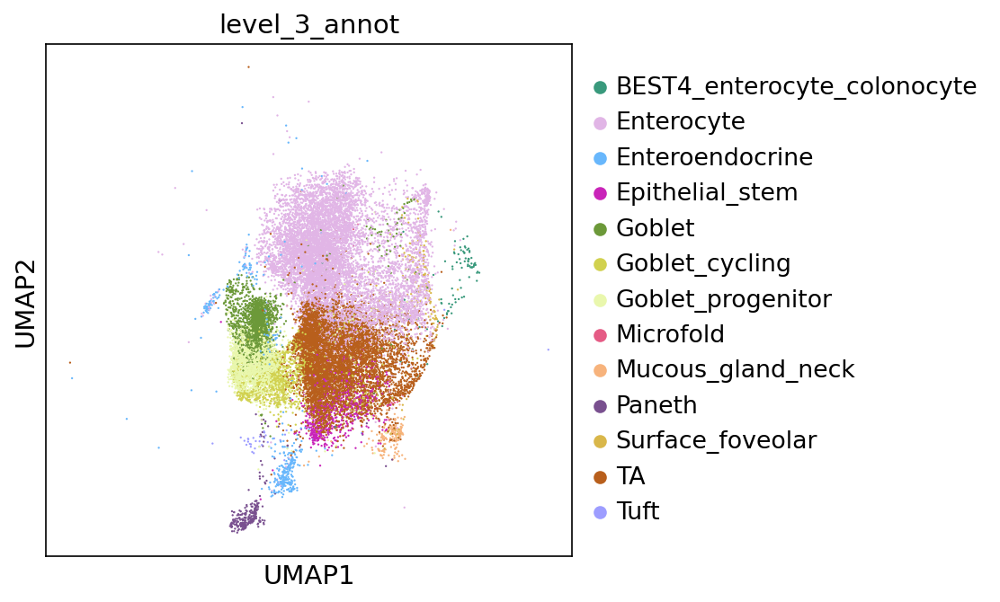

In [52]:
sc.pl.umap(cd,color='level_3_annot',palette=['#39997c',#BEST4
                                               '#e1b5e6',#enterocyte
                                                '#68b7fc',#enteroendocrine
                                               '#c924b9',#stem
                                               '#6c9939',#goblet
                                               '#d1d14f',#goblet_cycling
                                               '#e9f7ad',#goblet progenitor
                                                '#e55b85',#Microfold
                                            
                                               '#f7b37c',#MUC6
                                               
                                              
                                               '#79508f',#paneth
                                                  '#d9b74a',#MUC5AC
                                               '#b85f1c',#TA 
                                               '#9d9dff',#tuft
                                            ])

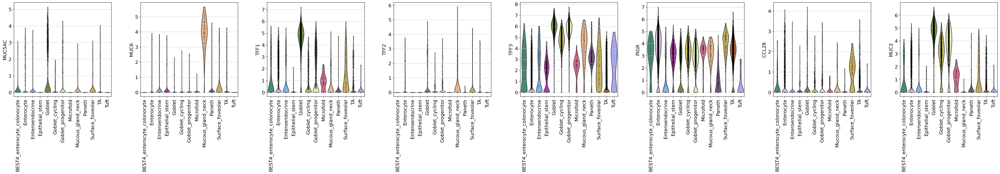

In [53]:
sc.pl.violin(cd,keys=['MUC5AC','MUC6','TFF1','TFF2','TFF3','PIGR','CCL28','MUC2'],groupby='level_3_annot',rotation=90)

In [54]:
epi

AnnData object with n_obs × n_vars = 659483 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_sp

In [55]:
epi_si = epi[epi.obs.organ_groups.isin(['Small_intestine'])].copy()

In [56]:
epi_si.obs.donor_category.value_counts()

control           190578
inutero            49674
disease            29692
preterm             3186
celiac_active        896
celiac_treated       734
Name: donor_category, dtype: int64

In [57]:
epi_si = epi_si[~epi_si.obs.donor_category.isin(['inutero','preterm'])].copy()

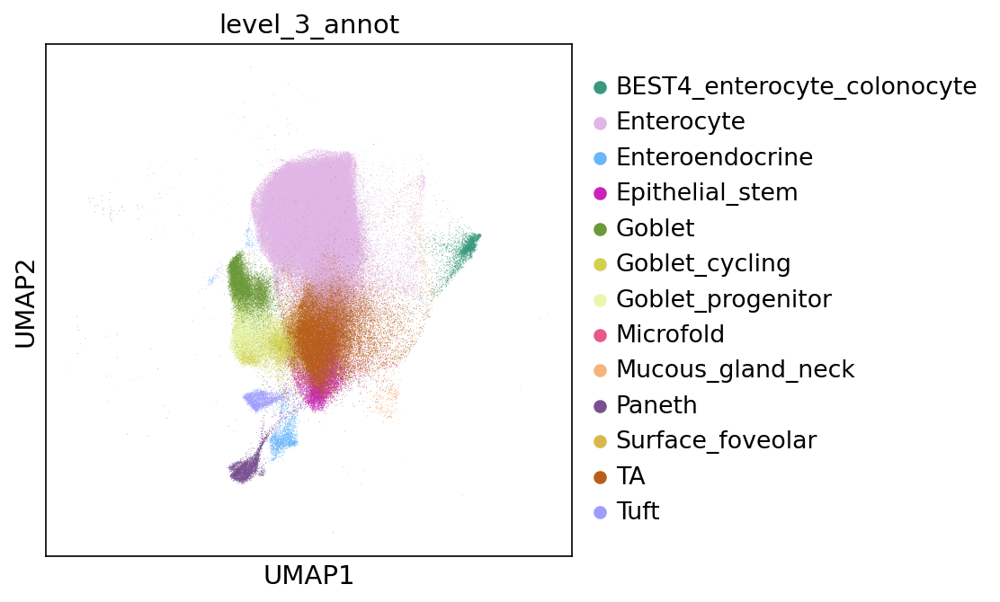

In [58]:
sc.pl.umap(epi_si,color='level_3_annot',palette=['#39997c',#BEST4
                                               '#e1b5e6',#enterocyte
                                                '#68b7fc',#enteroendocrine
                                               '#c924b9',#stem
                                               '#6c9939',#goblet
                                               '#d1d14f',#goblet_cycling
                                               '#e9f7ad',#goblet progenitor
                                                '#e55b85',#Microfold
                                            
                                               '#f7b37c',#MUC6
                                               
                                              
                                               '#79508f',#paneth
                                                  '#d9b74a',#MUC5AC
                                               '#b85f1c',#TA 
                                               '#9d9dff',#tuft
                                            ])

In [59]:
sc.pp.normalize_per_cell(epi_si, counts_per_cell_after=1e4)
sc.pp.log1p(epi_si)

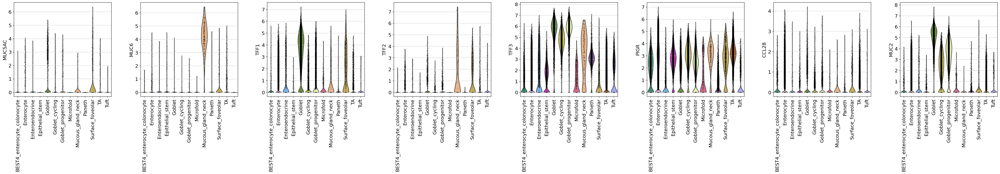

In [60]:
sc.pl.violin(epi_si,keys=['MUC5AC','MUC6','TFF1','TFF2','TFF3','PIGR','CCL28','MUC2'],groupby='level_3_annot',rotation=90)

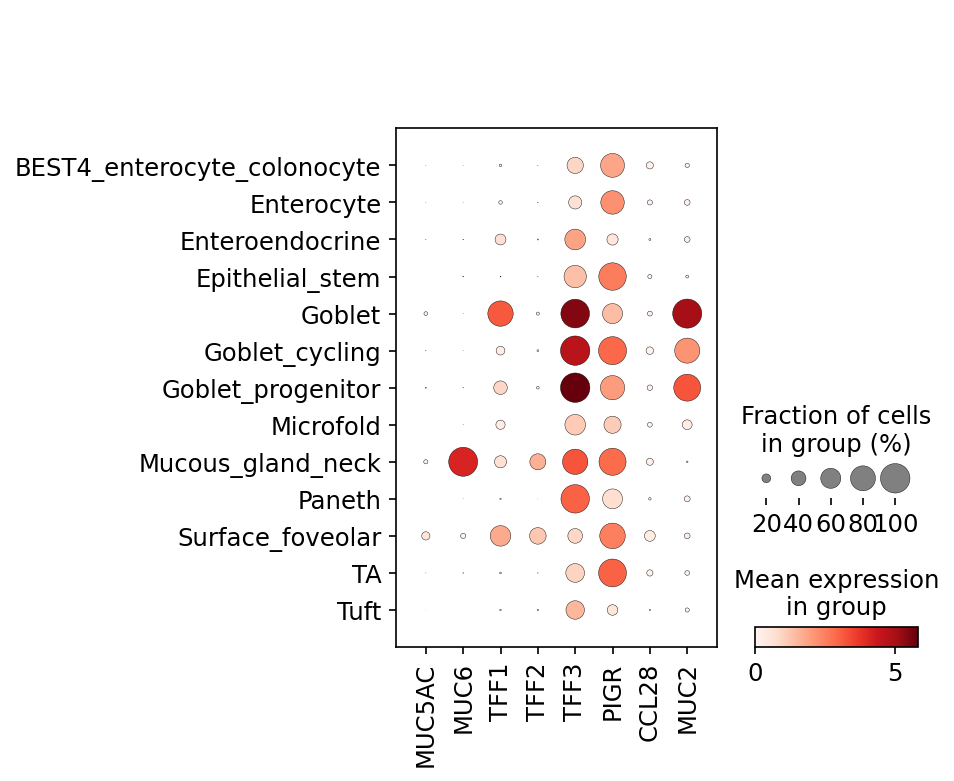

In [61]:
sc.pl.dotplot(epi_si,var_names=['MUC5AC','MUC6','TFF1','TFF2','TFF3','PIGR','CCL28','MUC2'],groupby='level_3_annot')

{'mainplot_ax': <AxesSubplot:>,
 'color_legend_ax': <AxesSubplot:title={'center':'Mean expression\nin group'}>}

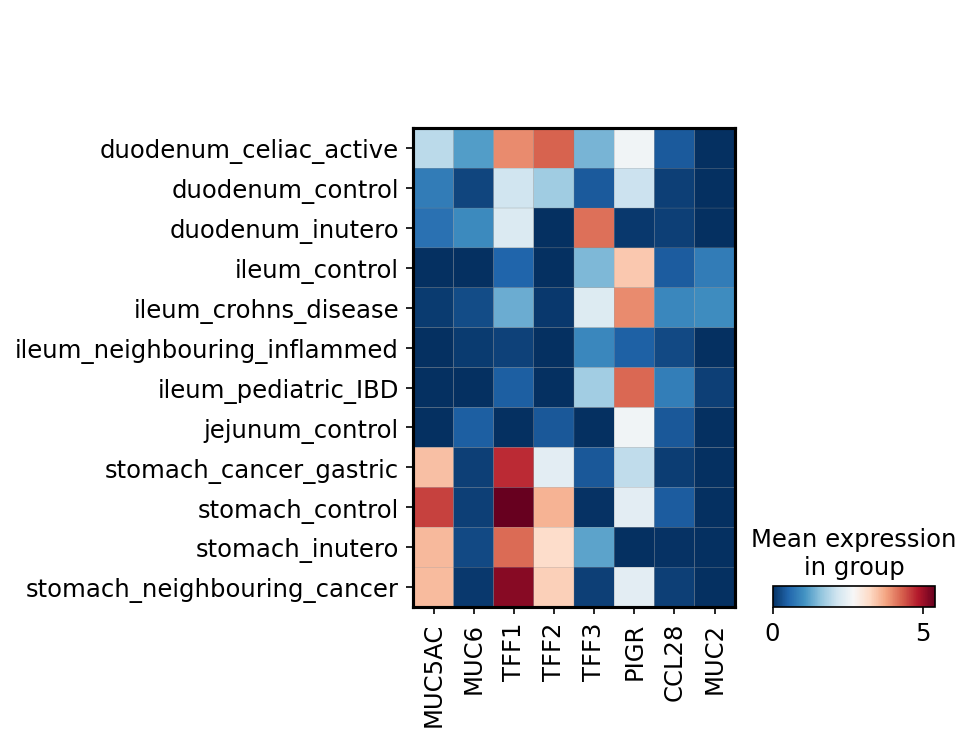

In [62]:
sc.pl.matrixplot(plot_full_muc5ac,var_names=['MUC5AC','MUC6','TFF1','TFF2','TFF3','PIGR','CCL28','MUC2'],groupby='organ_disease',show=False, cmap='RdBu_r')

In [63]:
si_m5 = epi_si[epi_si.obs.level_3_annot.isin(['Surface_foveolar'])].copy()

{'mainplot_ax': <AxesSubplot:>,
 'color_legend_ax': <AxesSubplot:title={'center':'Mean expression\nin group'}>}

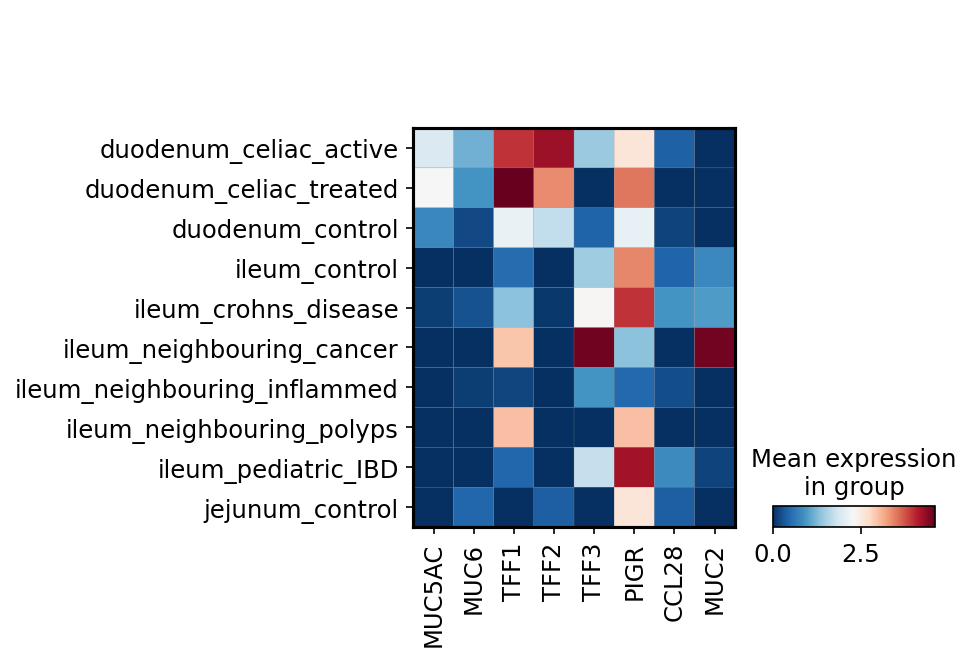

In [64]:
sc.pl.matrixplot(si_m5,var_names=['MUC5AC','MUC6','TFF1','TFF2','TFF3','PIGR','CCL28','MUC2'],groupby='organ_disease',show=False, cmap='RdBu_r')

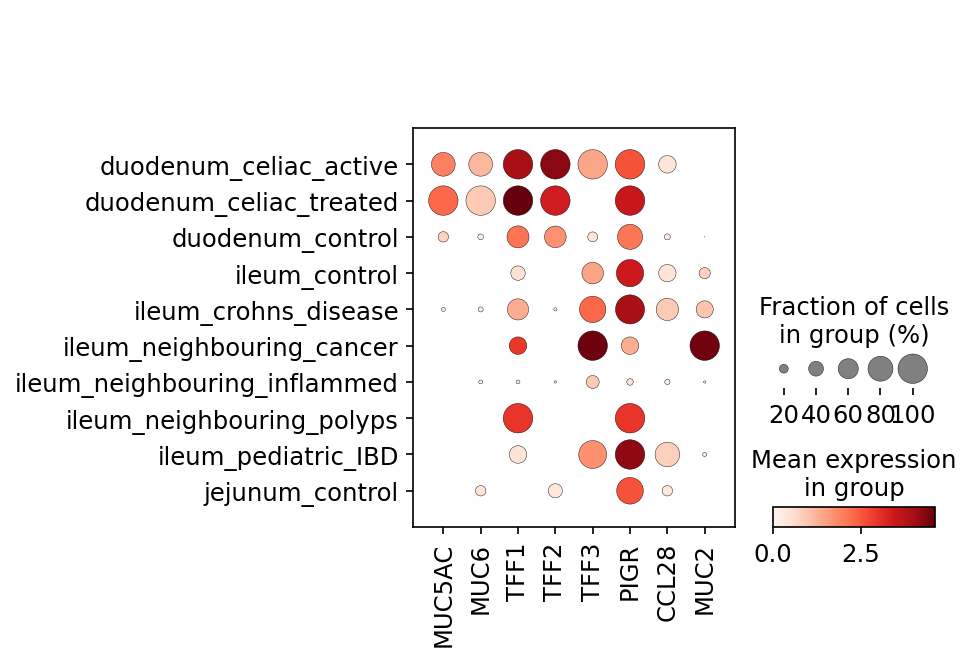

In [65]:
sc.pl.dotplot(si_m5,var_names=['MUC5AC','MUC6','TFF1','TFF2','TFF3','PIGR','CCL28','MUC2'],groupby='organ_disease')

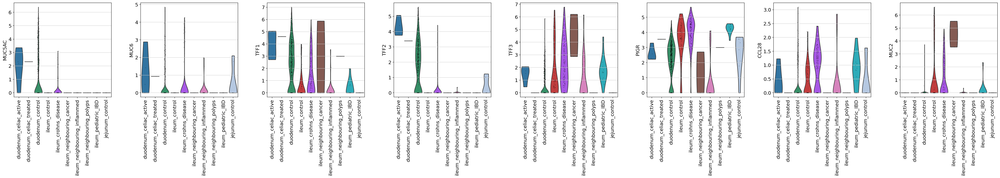

In [66]:
sc.pl.violin(si_m5,keys=['MUC5AC','MUC6','TFF1','TFF2','TFF3','PIGR','CCL28','MUC2'],groupby='organ_disease',rotation=90)

In [67]:
m5_plot_simple = plot_full_muc5ac[plot_full_muc5ac.obs.organ_disease.isin([
    'duodenum_control','stomach_control','stomach_neighbouring_cancer',
     'ileum_crohns_disease','ileum_pediatric_IBD'])].copy()

In [68]:
m5_plot_simple.obs['organ_disease_simple'] = (m5_plot_simple.obs['organ_disease'].map(lambda x: {
'stomach_neighbouring_cancer':'stomach_control',

 'ileum_pediatric_IBD':'ileum_IBD',
 'ileum_crohns_disease':'ileum_IBD',
        
         }.get(x, x)).astype("category"))

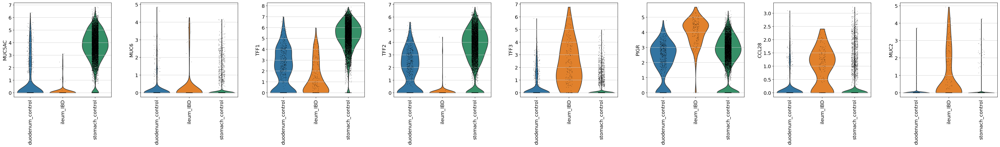

In [69]:
sc.pl.violin(m5_plot_simple,keys=['MUC5AC','MUC6','TFF1','TFF2','TFF3','PIGR','CCL28','MUC2'],groupby='organ_disease_simple',rotation=90)

In [70]:
m5_plot_simple

AnnData object with n_obs × n_vars = 9996 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spli

In [71]:
m5_plot_simple.obs['organ_disease_simple'].cat.reorder_categories(['stomach_control',
                                            'duodenum_control',
                                            'ileum_IBD',
 ], inplace=True)


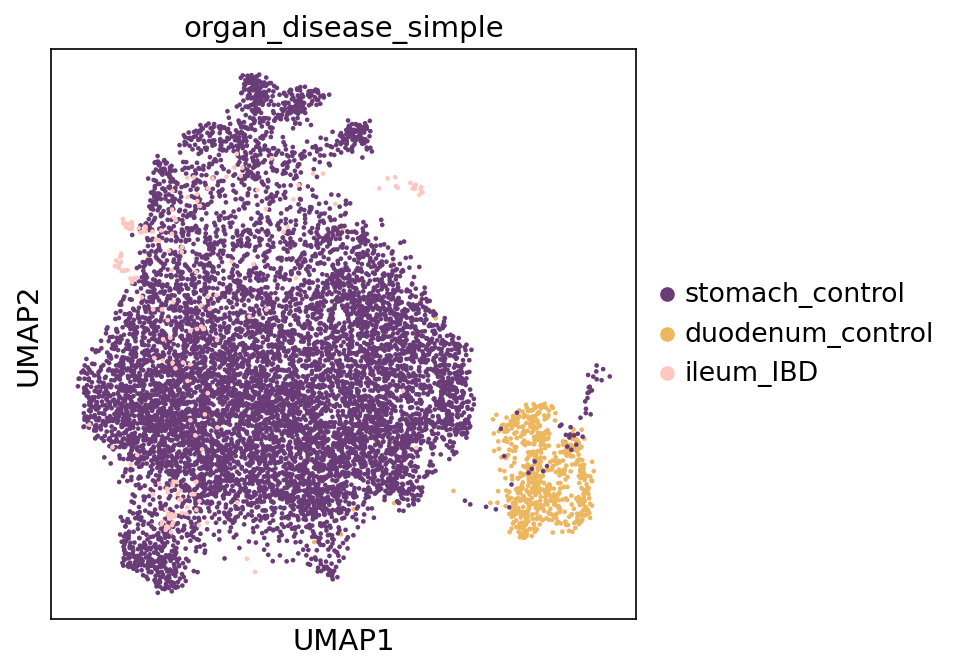

In [72]:
sc.pl.umap(m5_plot_simple,color='organ_disease_simple',palette = ['#edb75f','#fec8c1','#693C78',
   
 
 
  
  
                                                                 ],size=20)


In [73]:
sns.set_style(style="white")
sns.set_context(context="paper")

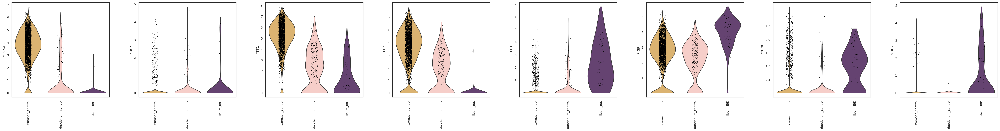

In [74]:
sc.pl.violin(m5_plot_simple,keys=['MUC5AC','MUC6','TFF1','TFF2','TFF3','PIGR','CCL28','MUC2'],groupby='organ_disease_simple',rotation=90)

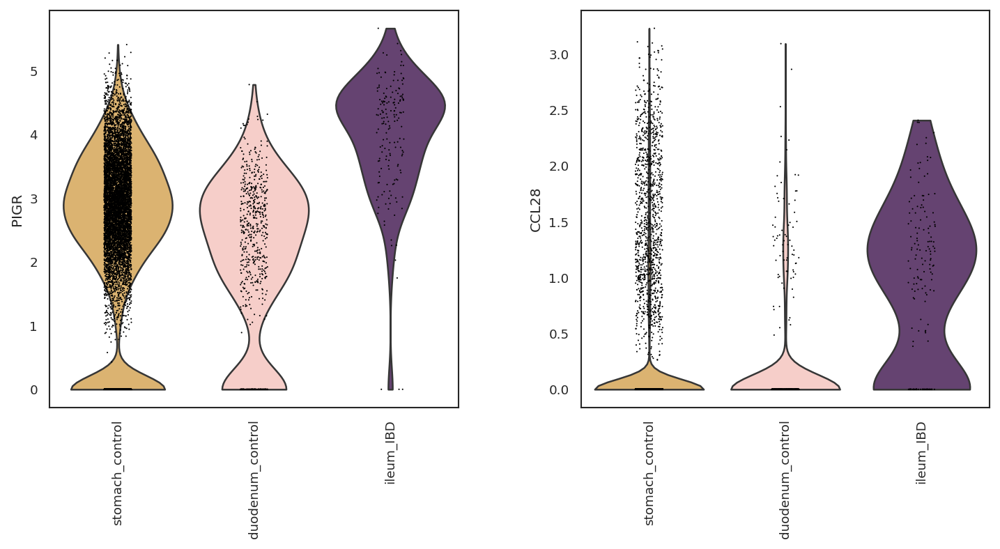

In [75]:
sc.pl.violin(m5_plot_simple,keys=['PIGR','CCL28'],groupby='organ_disease_simple',rotation=90,save='muc5ac_pigr_ccl28.pdf')

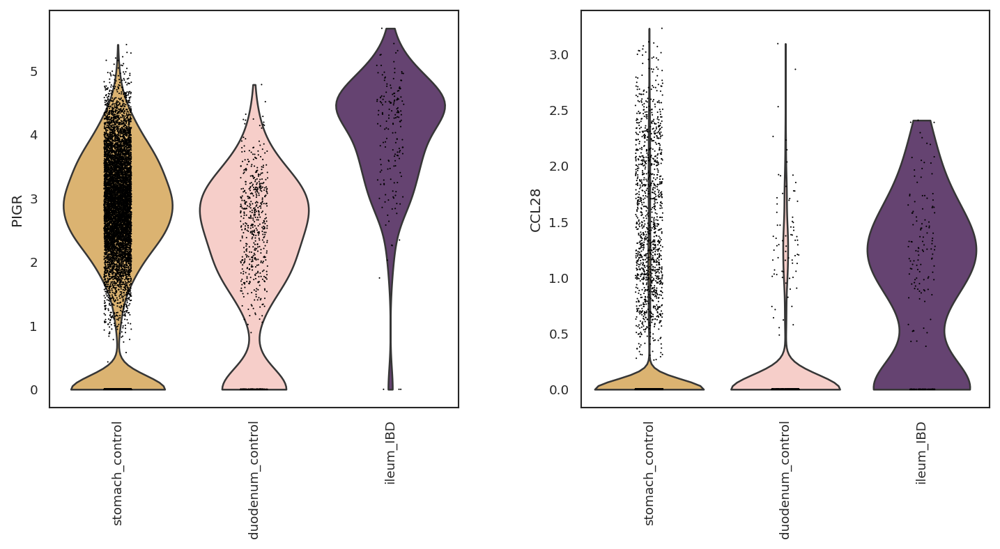

In [76]:
sc.pl.violin(m5_plot_simple,keys=['PIGR','CCL28'],groupby='organ_disease_simple',rotation=90,save='muc5ac_pigr_ccl28.png')

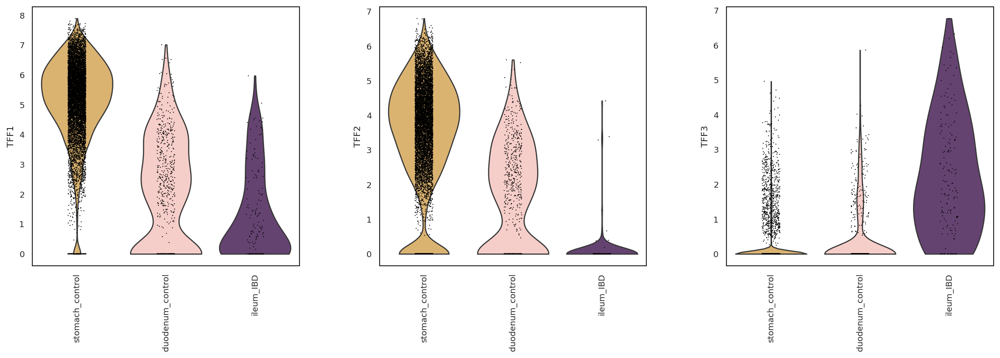

In [77]:
sc.pl.violin(m5_plot_simple,keys=['TFF1','TFF2','TFF3'],groupby='organ_disease_simple',rotation=90,save='muc5ac_trefoil.pdf')

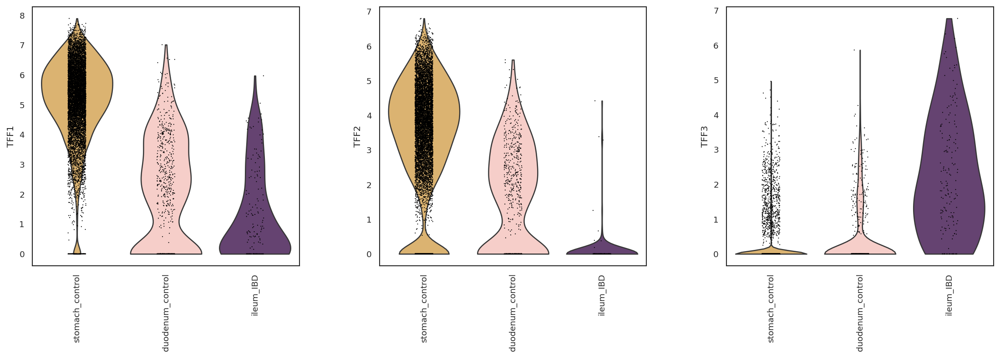

In [78]:
sc.pl.violin(m5_plot_simple,keys=['TFF1','TFF2','TFF3'],groupby='organ_disease_simple',rotation=90,save='muc5ac_trefoil.png')

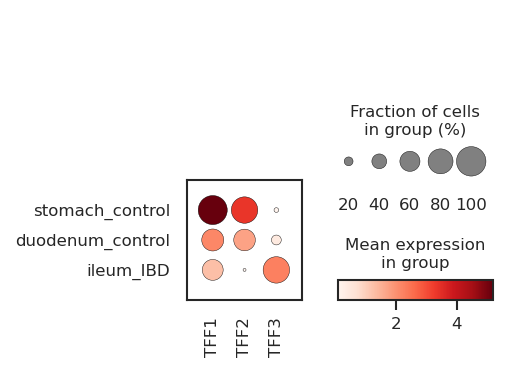

In [79]:
sc.pl.dotplot(m5_plot_simple,var_names=['TFF1','TFF2','TFF3'],groupby='organ_disease_simple',save='muc5_trefoil.pdf')

In [80]:
si_m6 = epi_si[epi_si.obs.level_3_annot.isin(['Mucous_gland_neck'])].copy()

In [81]:
full_muc6.obs['organ_disease']= full_muc6.obs['organ_unified'].astype(str)+'_'+full_muc6.obs['disease'].astype(str)
full_muc6.obs.organ_disease.value_counts()

stomach_neighbouring_cancer     11669
stomach_cancer_gastric           6136
stomach_control                   567
stomach_inutero                   369
ileum_crohns_disease              159
duodenum_control                   71
ileum_neighbouring_inflammed       32
duodenum_celiac_active             24
duodenum_inutero                   19
ileum_pediatric_IBD                 8
jejunum_control                     2
ileum_control                       1
duodenum_celiac_treated             1
Name: organ_disease, dtype: int64

In [82]:
m6_plot_simple = full_muc6[full_muc6.obs.organ_disease.isin([
    'duodenum_control','stomach_control','stomach_neighbouring_cancer',
     'ileum_crohns_disease','ileum_pediatric_IBD'])].copy()

In [83]:
m6_plot_simple.obs['organ_disease_simple'] = (m6_plot_simple.obs['organ_disease'].map(lambda x: {
'stomach_neighbouring_cancer':'stomach_control',

 'ileum_pediatric_IBD':'ileum_IBD',
 'ileum_crohns_disease':'ileum_IBD',
        
         }.get(x, x)).astype("category"))

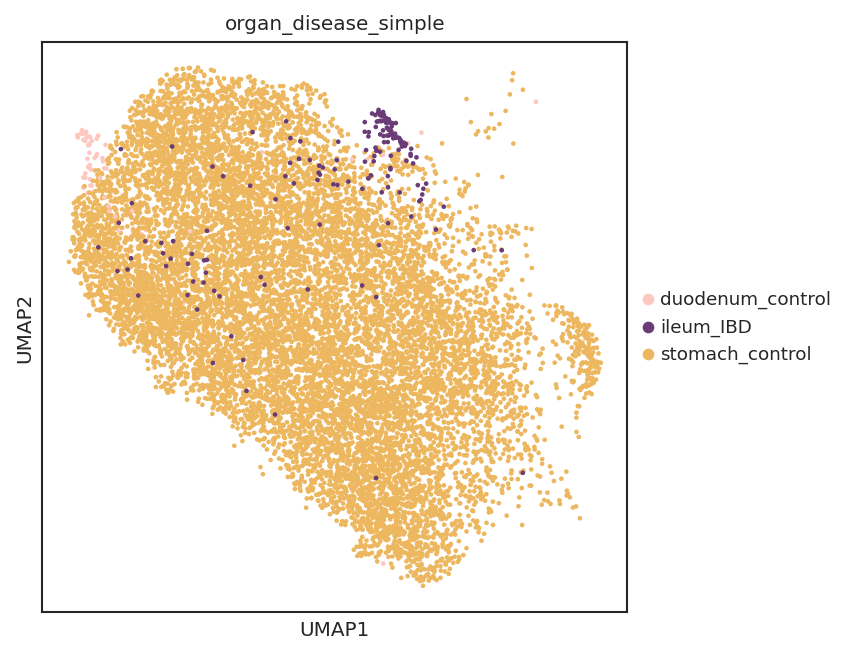

In [84]:
sc.pl.umap(m6_plot_simple,color='organ_disease_simple',palette = {'duodenum_control': '#fec8c1',
           'stomach_control': '#edb75f',
 
  'ileum_IBD': '#693C78',
 
 
  
  
     },size=20)


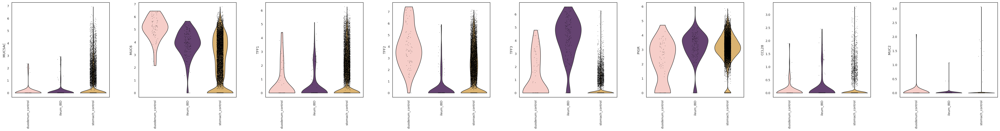

In [85]:
sc.pl.violin(m6_plot_simple,keys=['MUC5AC','MUC6','TFF1','TFF2','TFF3','PIGR','CCL28','MUC2'],groupby='organ_disease_simple',rotation=90)

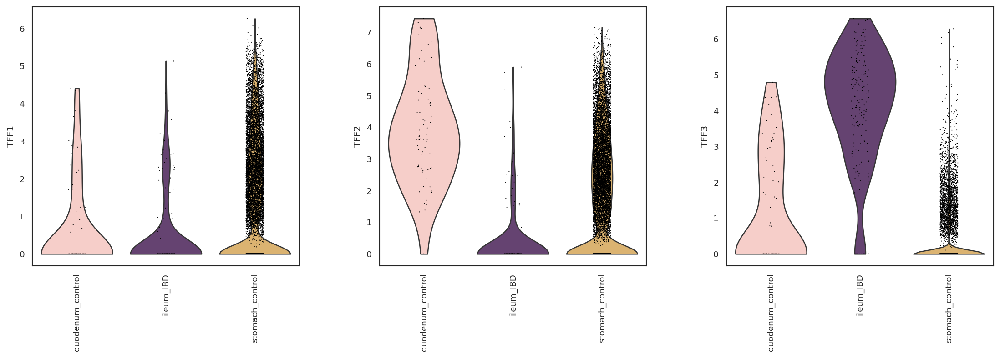

In [86]:
sc.pl.violin(m6_plot_simple,keys=['TFF1','TFF2','TFF3'],groupby='organ_disease_simple',rotation=90,save='muc6_trefoil.pdf')

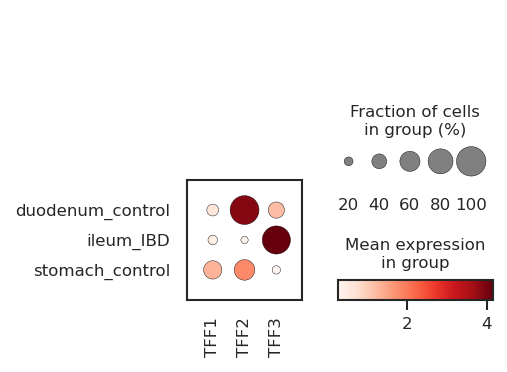

In [87]:
sc.pl.dotplot(m6_plot_simple,var_names=['TFF1','TFF2','TFF3'],groupby='organ_disease_simple',save='muc6_trefoil.pdf')

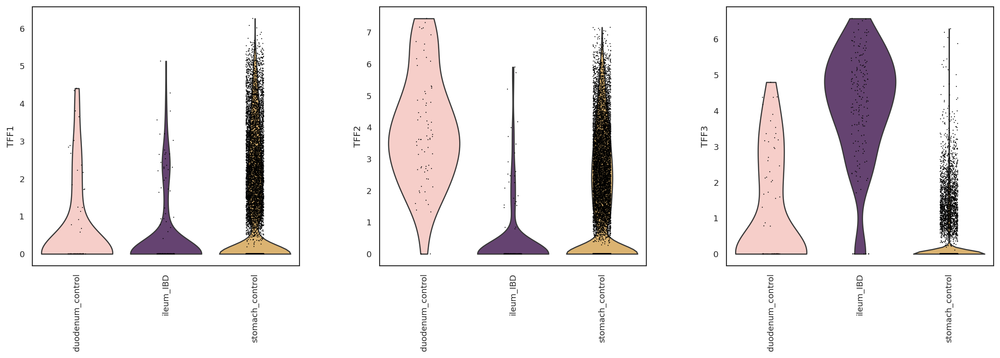

In [88]:
sc.pl.violin(m6_plot_simple,keys=['TFF1','TFF2','TFF3'],groupby='organ_disease_simple',rotation=90,save='muc6_trefoil.png')

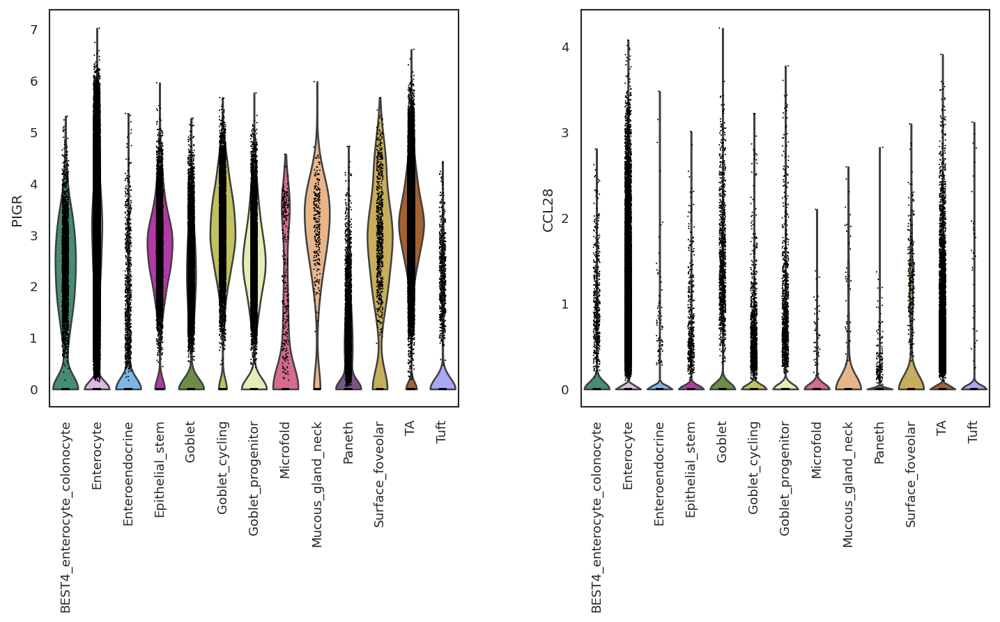

In [89]:
sc.pl.violin(epi_si,keys=['PIGR','CCL28'],groupby='level_3_annot',rotation=90)

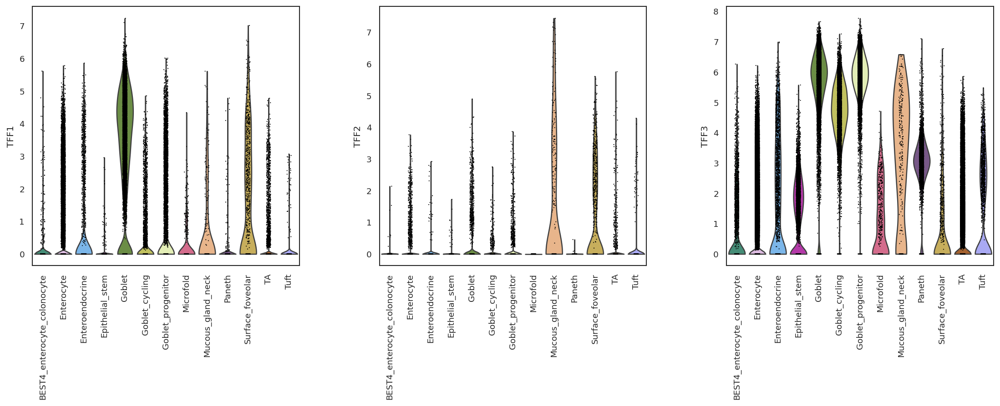

In [90]:
sc.pl.violin(epi_si,keys=['TFF1','TFF2','TFF3'],groupby='level_3_annot',rotation=90)

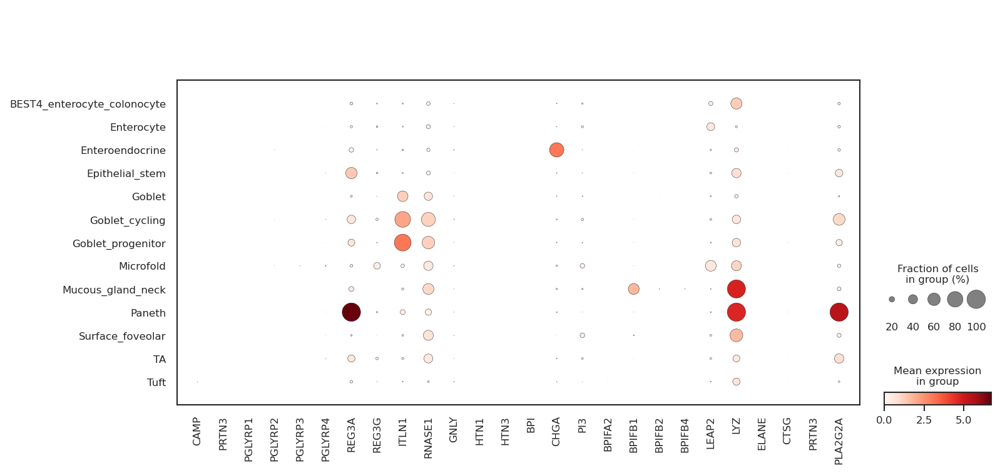

In [91]:
#look at antimicrobial peptides from this reactome database: https://reactome.org/PathwayBrowser/#/R-HSA-6803157&SEL=R-HSA-8933468
sc.pl.dotplot(epi_si,var_names=['CAMP','PRTN3','PGLYRP1','PGLYRP2','PGLYRP3','PGLYRP4','REG3A','REG3G','ITLN1','RNASE1',
                                'GNLY','HTN1','HTN3','BPI','CHGA','PI3','BPIFA2','BPIFB1',
                                'BPIFB2','BPIFB4','LEAP2','LYZ','ELANE','CTSG',
                                'PRTN3','PLA2G2A'],groupby='level_3_annot')
#genes not in matrix: 'BPIF9P','BPIFA1','BPIFA3','BPIFB5P','BPIFB6','DCD','EPPIN','HTN5','BPIFA4P','BPIFB3',

In [92]:
anti_microbial = ['CAMP','PRTN3','PGLYRP1','PGLYRP2','PGLYRP3','PGLYRP4','REG3A','REG3G','ITLN1','RNASE1',
                                'GNLY','HTN1','HTN3','BPI','CHGA','PI3','BPIFA2','BPIFB1',
                                'BPIFB2','BPIFB4','LEAP2','LYZ','ELANE','CTSG',
                                'PRTN3','PLA2G2A']

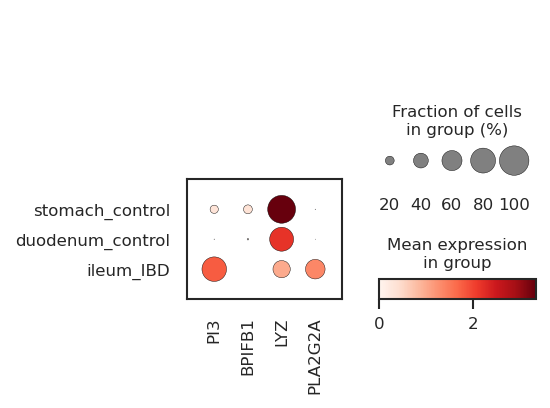

In [93]:
sc.pl.dotplot(m5_plot_simple,var_names=['PI3','BPIFB1','LYZ','PLA2G2A'],groupby='organ_disease_simple',save='muc5ac_anti_microbial.pdf')

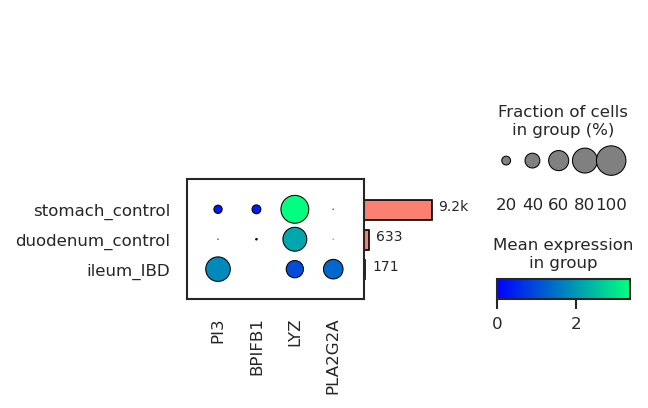

In [94]:
dp = sc.pl.dotplot(m5_plot_simple,var_names=['PI3','BPIFB1','LYZ','PLA2G2A'],groupby='organ_disease_simple',show=False, return_fig=True,cmap='RdBu_r')
dp.add_totals().style(dot_edge_color='black', dot_edge_lw=0.5)
dp.savefig('muc5ac_anti_microbial_addtotals.pdf', dpi=300)

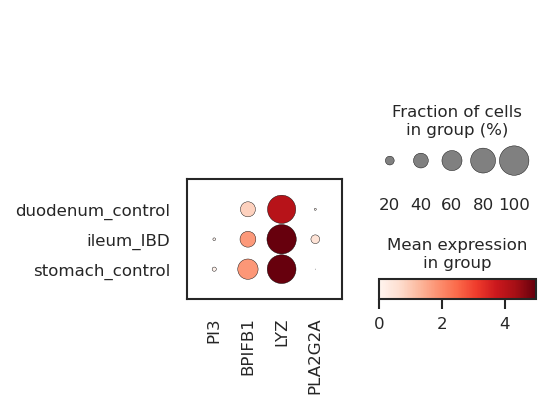

In [95]:
sc.pl.dotplot(m6_plot_simple,var_names=['PI3','BPIFB1','LYZ','PLA2G2A'],groupby='organ_disease_simple',save='muc6_anti_microbial.pdf')

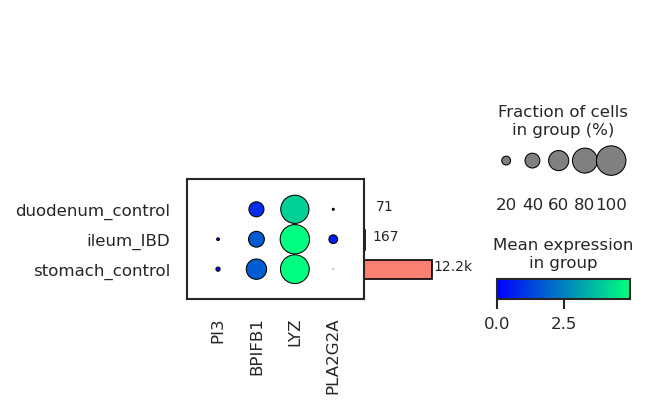

In [96]:
dp = sc.pl.dotplot(m6_plot_simple,var_names=['PI3','BPIFB1','LYZ','PLA2G2A'],groupby='organ_disease_simple',show=False, return_fig=True,cmap='RdBu_r')
dp.add_totals().style(dot_edge_color='black', dot_edge_lw=0.5)
dp.savefig('muc6_anti_microbial_addtotals.pdf', dpi=300)

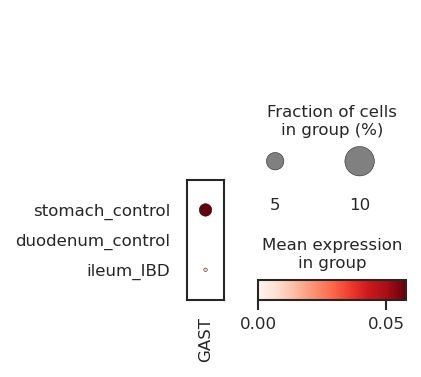

In [97]:
sc.pl.dotplot(m5_plot_simple,var_names=['GAST'],groupby='organ_disease_simple',)

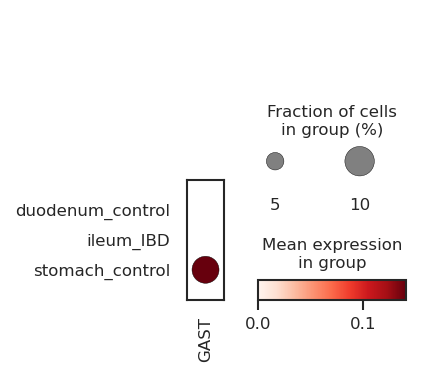

In [98]:
sc.pl.dotplot(m6_plot_simple,var_names=['GAST'],groupby='organ_disease_simple',)

In [99]:
si_m6m5 = epi[epi.obs.level_3_annot.isin(['Mucous_gland_neck','Surface_foveolar'])].copy()

In [100]:
si_m6m5.obs.organ_disease.value_counts()

stomach_neighbouring_cancer     19717
stomach_cancer_gastric          11257
stomach_control                  1711
stomach_inutero                   763
duodenum_control                  704
ileum_crohns_disease              316
ileum_control                      92
ileum_neighbouring_inflammed       62
duodenum_celiac_active             28
duodenum_inutero                   26
ileum_pediatric_IBD                22
jejunum_control                    10
ileum_neighbouring_cancer           2
duodenum_celiac_treated             2
ileum_neighbouring_polyps           1
ileum_inutero                       1
Name: organ_disease, dtype: int64

In [101]:
si_m6m5.obs['organ_disease_celltype']= si_m6m5.obs['level_3_annot'].astype(str)+'_'+si_m6m5.obs['organ_disease'].astype(str)
si_m6m5.obs['organ_disease_celltype'].value_counts()

Mucous_gland_neck_stomach_neighbouring_cancer     11669
Surface_foveolar_stomach_neighbouring_cancer       8048
Mucous_gland_neck_stomach_cancer_gastric           6136
Surface_foveolar_stomach_cancer_gastric            5121
Surface_foveolar_stomach_control                   1144
Surface_foveolar_duodenum_control                   633
Mucous_gland_neck_stomach_control                   567
Surface_foveolar_stomach_inutero                    394
Mucous_gland_neck_stomach_inutero                   369
Mucous_gland_neck_ileum_crohns_disease              159
Surface_foveolar_ileum_crohns_disease               157
Surface_foveolar_ileum_control                       91
Mucous_gland_neck_duodenum_control                   71
Mucous_gland_neck_ileum_neighbouring_inflammed       32
Surface_foveolar_ileum_neighbouring_inflammed        30
Mucous_gland_neck_duodenum_celiac_active             24
Mucous_gland_neck_duodenum_inutero                   19
Surface_foveolar_ileum_pediatric_IBD            

In [102]:
list(si_m6m5.obs['organ_disease_celltype'].unique())

['Surface_foveolar_stomach_control',
 'Mucous_gland_neck_stomach_control',
 'Surface_foveolar_ileum_control',
 'Surface_foveolar_ileum_neighbouring_polyps',
 'Mucous_gland_neck_stomach_inutero',
 'Surface_foveolar_stomach_inutero',
 'Surface_foveolar_duodenum_control',
 'Mucous_gland_neck_duodenum_control',
 'Mucous_gland_neck_jejunum_control',
 'Surface_foveolar_jejunum_control',
 'Mucous_gland_neck_ileum_control',
 'Surface_foveolar_ileum_inutero',
 'Surface_foveolar_duodenum_inutero',
 'Mucous_gland_neck_duodenum_inutero',
 'Surface_foveolar_ileum_neighbouring_inflammed',
 'Surface_foveolar_stomach_neighbouring_cancer',
 'Mucous_gland_neck_stomach_neighbouring_cancer',
 'Surface_foveolar_ileum_neighbouring_cancer',
 'Mucous_gland_neck_ileum_pediatric_IBD',
 'Surface_foveolar_ileum_pediatric_IBD',
 'Mucous_gland_neck_ileum_crohns_disease',
 'Surface_foveolar_ileum_crohns_disease',
 'Mucous_gland_neck_stomach_cancer_gastric',
 'Surface_foveolar_stomach_cancer_gastric',
 'Mucous_gland_

In [103]:
plot_si_m6m5 = si_m6m5[si_m6m5.obs.organ_disease_celltype.isin([
'Surface_foveolar_stomach_control',
 'Mucous_gland_neck_stomach_control',
 'Surface_foveolar_duodenum_control',
 'Mucous_gland_neck_duodenum_control',
 'Surface_foveolar_stomach_neighbouring_cancer',
 'Mucous_gland_neck_stomach_neighbouring_cancer',
 'Mucous_gland_neck_ileum_pediatric_IBD',
 'Surface_foveolar_ileum_pediatric_IBD',
 'Mucous_gland_neck_ileum_crohns_disease',
 'Surface_foveolar_ileum_crohns_disease',])]

In [104]:
plot_si_m6m5.obs['organ_disease_celltype_simple'] = (plot_si_m6m5.obs['organ_disease_celltype'].map(lambda x: {
'Surface_foveolar_stomach_neighbouring_cancer':'Surface_foveolar_stomach_control',
 'Mucous_gland_neck_stomach_neighbouring_cancer':'Mucous_gland_neck_stomach_control',
 'Mucous_gland_neck_ileum_pediatric_IBD':'Mucous_gland_neck_ileum_IBD',
 'Surface_foveolar_ileum_pediatric_IBD':'Surface_foveolar_ileum_IBD',
    'Mucous_gland_neck_ileum_crohns_disease':'Mucous_gland_neck_ileum_IBD',
 'Surface_foveolar_ileum_crohns_disease':'Surface_foveolar_ileum_IBD',
         }.get(x, x)).astype("category"))

In [105]:
list(plot_si_m6m5.obs['organ_disease_celltype_simple'].unique())

['Surface_foveolar_stomach_control',
 'Mucous_gland_neck_stomach_control',
 'Surface_foveolar_duodenum_control',
 'Mucous_gland_neck_duodenum_control',
 'Mucous_gland_neck_ileum_IBD',
 'Surface_foveolar_ileum_IBD']

In [106]:
plot_si_m6m5.obs['organ_disease_celltype_simple'].cat.reorder_categories(['Surface_foveolar_stomach_control',
                                            'Surface_foveolar_duodenum_control',
                                            'Surface_foveolar_ileum_IBD',
 'Mucous_gland_neck_stomach_control',
 'Mucous_gland_neck_duodenum_control',
 'Mucous_gland_neck_ileum_IBD',
 
   ], inplace=True)


In [107]:
sc.pp.normalize_per_cell(plot_si_m6m5, counts_per_cell_after=1e4)
sc.pp.log1p(plot_si_m6m5)

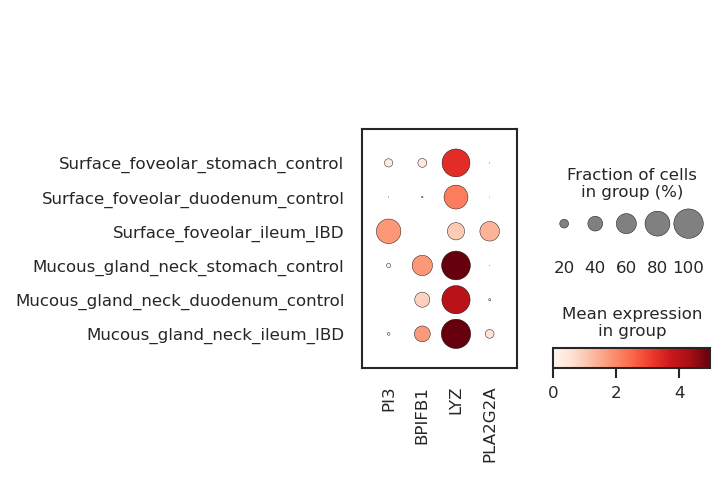

In [108]:
sc.pl.dotplot(plot_si_m6m5,var_names=['PI3','BPIFB1','LYZ','PLA2G2A'],groupby='organ_disease_celltype_simple',save='muc6and5ac_anti_microbial.pdf')

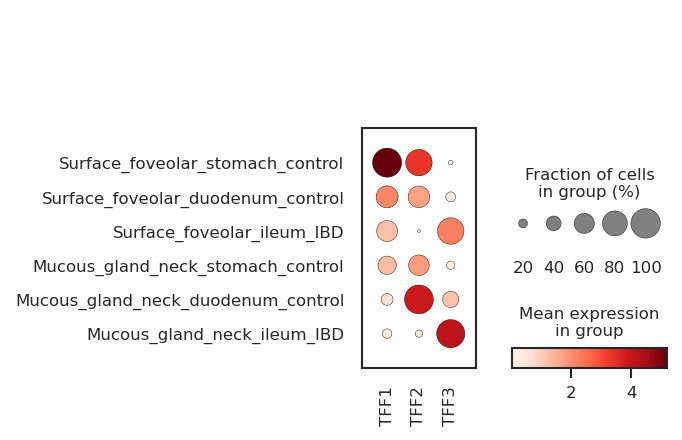

In [109]:
sc.pl.dotplot(plot_si_m6m5,var_names=['TFF1','TFF2','TFF3'],groupby='organ_disease_celltype_simple',save='muc6and5ac_trefoil.pdf')

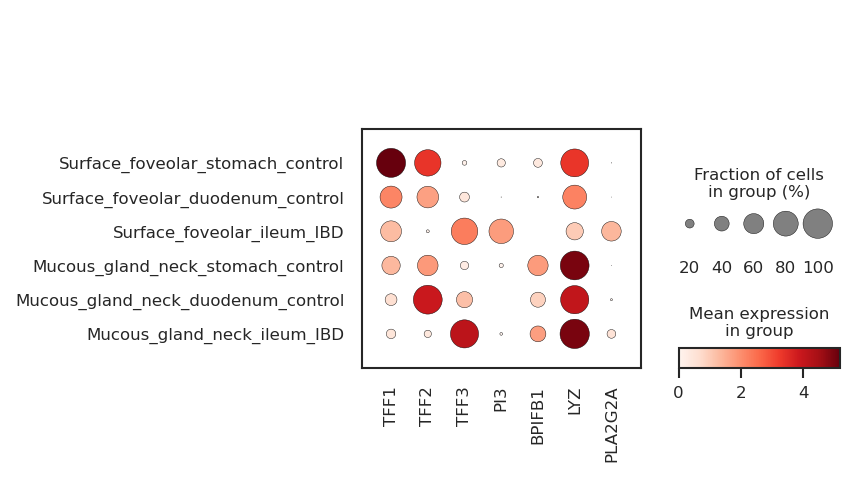

In [110]:
sc.pl.dotplot(plot_si_m6m5,var_names=['TFF1','TFF2','TFF3','PI3','BPIFB1','LYZ','PLA2G2A'],groupby='organ_disease_celltype_simple',save='muc6and5ac_trefoil_antimicrobe.pdf')

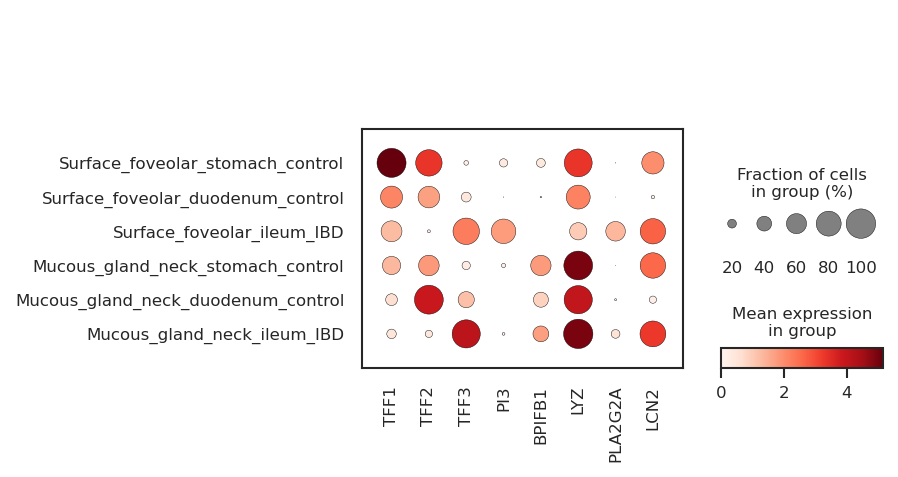

In [119]:
sc.pl.dotplot(plot_si_m6m5,var_names=['TFF1','TFF2','TFF3','PI3','BPIFB1','LYZ','PLA2G2A','LCN2'],groupby='organ_disease_celltype_simple',save='muc6and5ac_trefoil_antimicrobe.pdf')

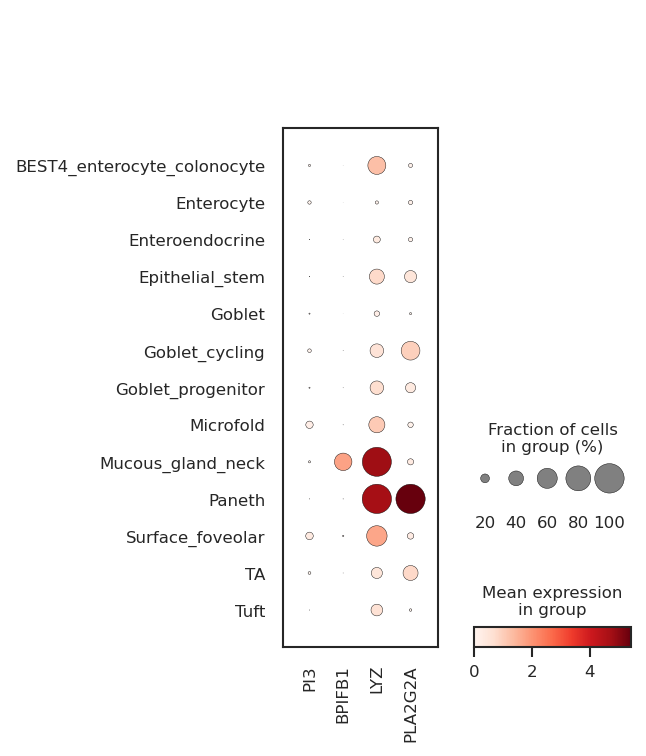

In [112]:
sc.pl.dotplot(epi_si,var_names=['PI3','BPIFB1','LYZ','PLA2G2A'],groupby='level_3_annot')

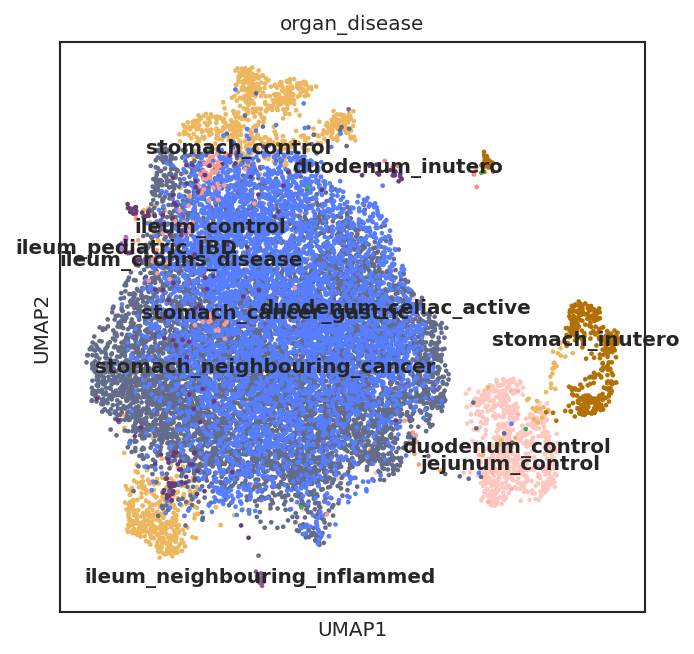

In [113]:
sc.pl.umap(plot_full_muc5ac,color='organ_disease',size=20,palette={'duodenum_control': '#fec8c1',
           'stomach_control': '#edb75f',
  'duodenum_inutero': '#ff8778',
            'stomach_inutero': '#b37004',
  'stomach_cancer_gastric': '#577eff',
  'ileum_crohns_disease': '#693C78',
  'ileum_pediatric_IBD': '#B670CD',
  
 
  'duodenum_celiac_active': '#38B257',
  
    'stomach_neighbouring_cancer': '#636c8a',
  
  'ileum_neighbouring_inflammed': '#82638a' ,
     'ileum_control':'#fc9a8d','jejunum_control':'#feb2a8'} ,save='full_muc5ac_organdisease1_legendon.pdf',legend_loc='on data'       )

         Falling back to preprocessing with `sc.pp.pca` and default params.


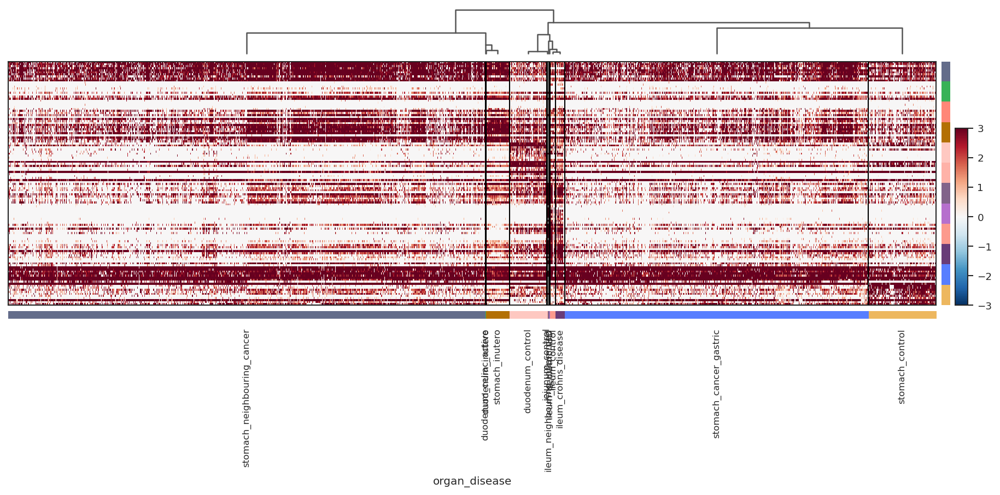

In [114]:
#dendrogram
sc.tl.rank_genes_groups(plot_full_muc5ac,groupby='organ_disease',method='wilcoxon')
sc.tl.dendrogram(plot_full_muc5ac, groupby='organ_disease')
sc.pl.rank_genes_groups_heatmap(plot_full_muc5ac,groupby='organ_disease', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=False,
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(15,5))

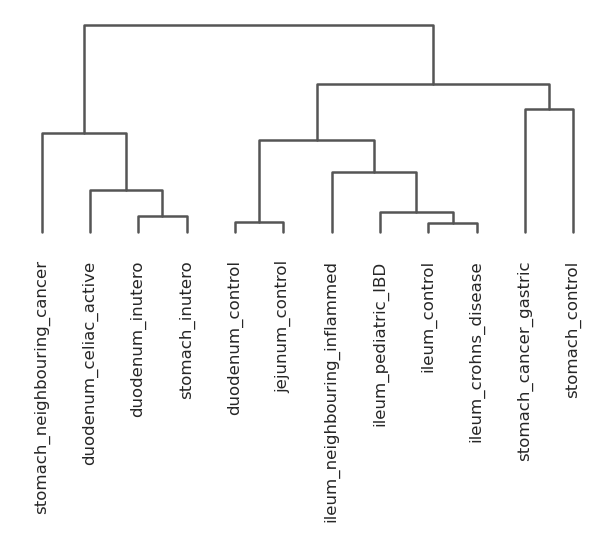

<AxesSubplot:>

In [115]:
plt.rcParams['figure.figsize'] = [5,2]
sc.pl.dendrogram(plot_full_muc5ac,groupby='organ_disease')

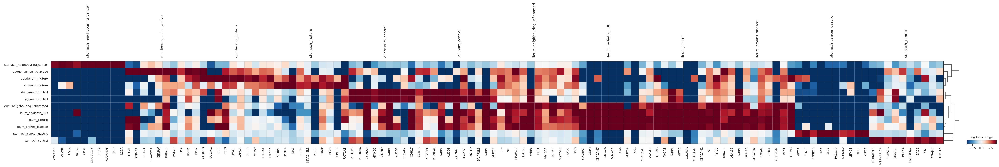

In [116]:
sc.pl.rank_genes_groups_matrixplot(
    plot_full_muc5ac,
    n_genes=10,
    values_to_plot="logfoldchanges",
    cmap='RdBu_r',
    vmin=-4,
    vmax=4,
    min_logfoldchange=3,
    colorbar_title='log fold change',
)

In [117]:
#function for downsampling
def downsample_mask(clustering, to_thin, n_cells=200):
    mask = np.array([i not in to_thin for i in clustering])
    numtemp = np.arange(len(clustering))
    for clus in to_thin:
        inds = set(numtemp[[i==clus for i in clustering]])
        keep = random.sample(inds, round(n_cells))
        mask[keep] = True
    return mask

In [118]:
#Prepare categories for downsampling (per donor_celltype combination)
plot_full_muc5ac.obs['donor_celltype']=plot_full_muc5ac.obs['donorID_unified'].astype(str)+'_'+plot_full_muc5ac.obs['level_3_annot'].astype(str)
plot_full_muc5ac.obs.donor_celltype.value_counts()

D127_Surface_foveolar    1312
D115_Surface_foveolar    1205
D99_Surface_foveolar     1078
D124_Surface_foveolar     962
D131_Surface_foveolar     825
                         ... 
D44_Surface_foveolar        1
D4_Surface_foveolar         1
D28_Surface_foveolar        1
D160_Surface_foveolar       1
F18_Surface_foveolar        1
Name: donor_celltype, Length: 66, dtype: int64

# TRASH

# Downsampled muc6 cells

In [53]:
#Downsample
vc=plot_full_muc5ac.obs.donor_celltype.value_counts().loc[lambda x: x>100].reset_index()['index']
mask_p = downsample_mask(plot_full_muc5ac.obs['donor_celltype'], vc.tolist(), n_cells=100)
muc5_downsample = plot_full_muc5ac[mask_p]
muc5_downsample.obs.donor_celltype.value_counts()

D99_Surface_foveolar     100
D124_Surface_foveolar    100
D114_Surface_foveolar    100
D115_Surface_foveolar    100
D116_Surface_foveolar    100
                        ... 
D216_Surface_foveolar      1
D44_Surface_foveolar       1
D28_Surface_foveolar       1
D160_Surface_foveolar      1
F18_Surface_foveolar       1
Name: donor_celltype, Length: 66, dtype: int64

In [54]:
sc.tl.dendrogram(muc5_downsample, groupby='disease')

/home/jovyan/my-conda-envs/standard_plot_gsea/lib/python3.8/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


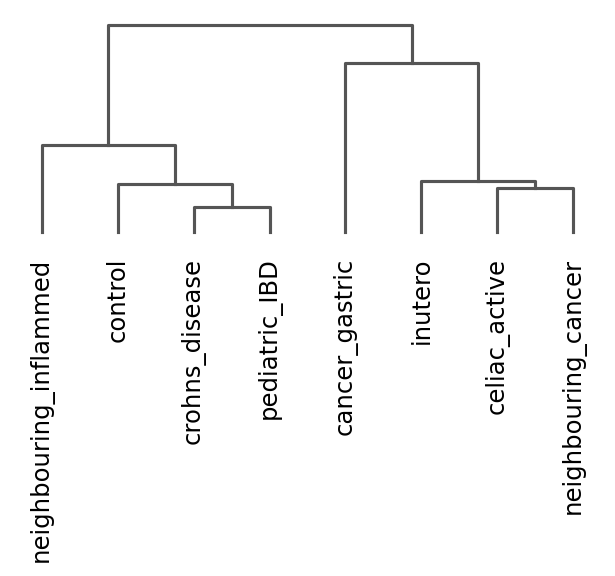

<AxesSubplot:>

In [55]:
plt.rcParams['figure.figsize'] = [5,2]
sc.pl.dendrogram(muc5_downsample,groupby='disease')

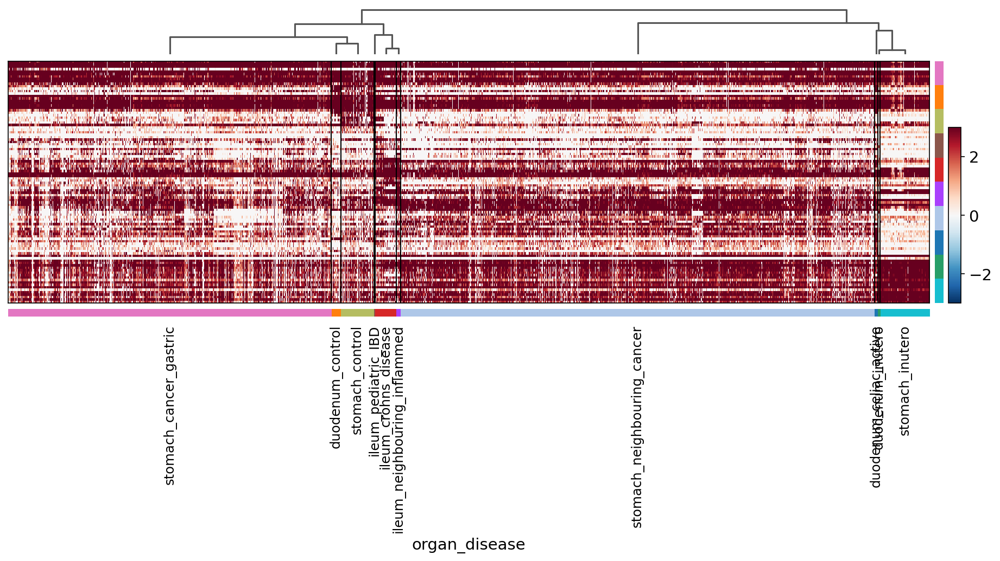

In [120]:
#dendrogram
sc.tl.rank_genes_groups(muc5_downsample,groupby='organ_disease',method='wilcoxon')
sc.tl.dendrogram(muc6_downsample, groupby='organ_disease')
sc.pl.rank_genes_groups_heatmap(muc6_downsample,groupby='organ_disease', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=False,
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(15,5))

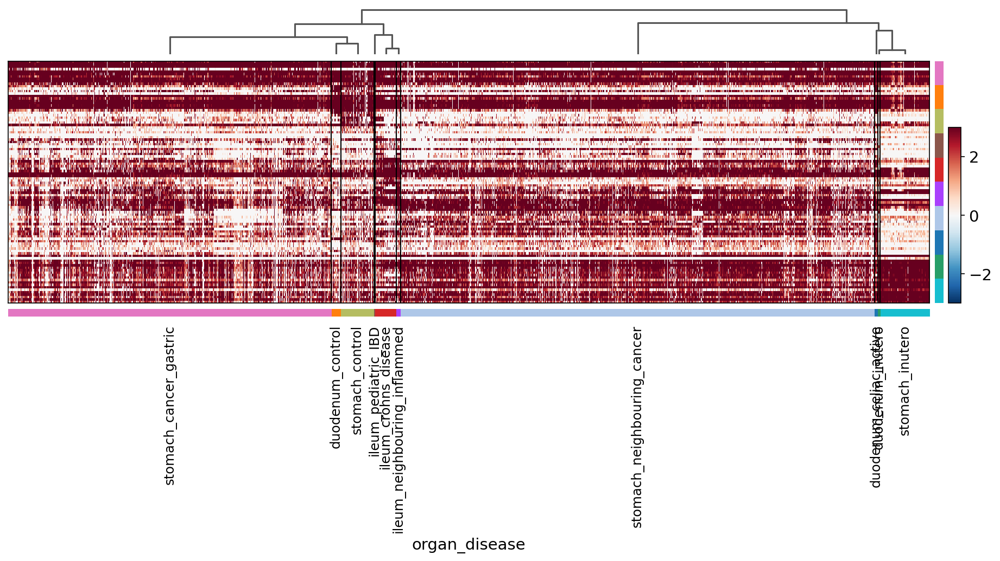

In [121]:
#dendrogram
sc.tl.rank_genes_groups(muc6_downsample,groupby='organ_disease',method='wilcoxon')
sc.tl.dendrogram(muc6_downsample, groupby='organ_disease')
sc.pl.rank_genes_groups_heatmap(muc6_downsample,groupby='organ_disease', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=False,
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(15,5))

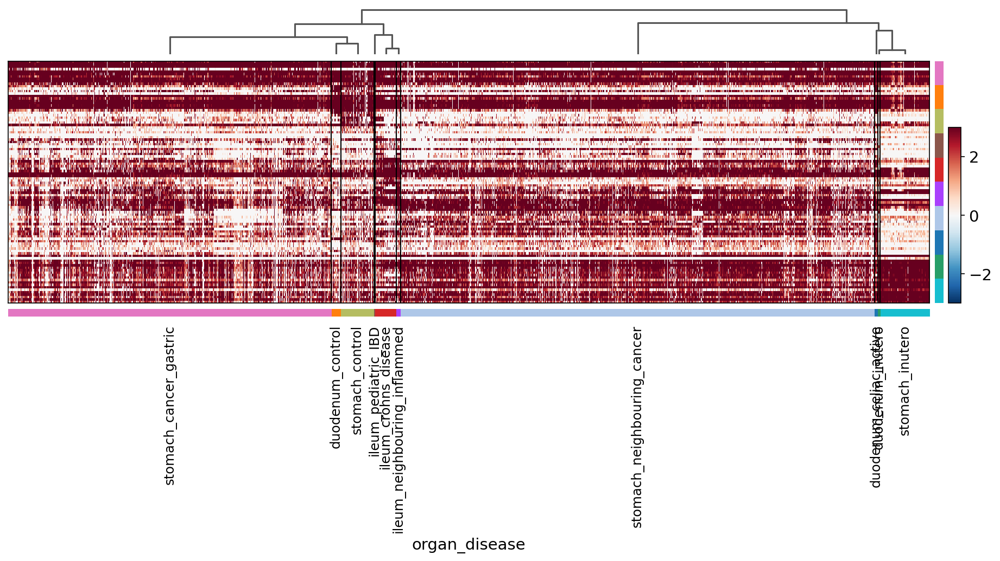

In [122]:
sc.pl.rank_genes_groups_heatmap(muc6_downsample,groupby='organ_disease', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=False,
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(15,5),save='muc6_downsample_dendro.pdf')

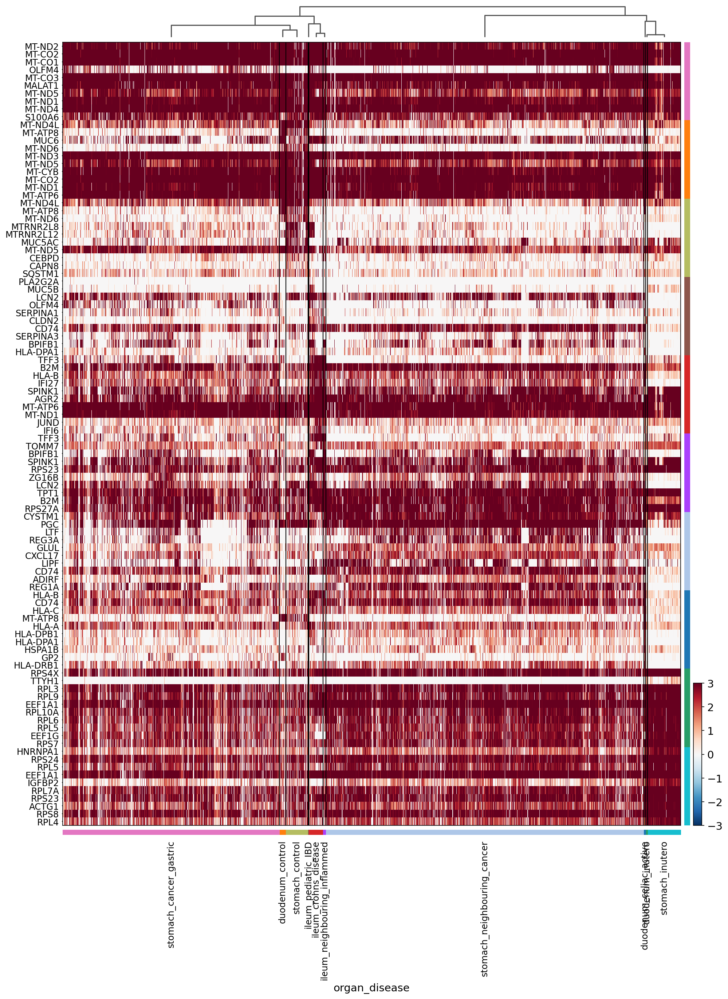

In [123]:
sc.pl.rank_genes_groups_heatmap(muc6_downsample,groupby='organ_disease', n_genes=10, use_raw=False, swap_axes=True, 
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(15,20), show_gene_labels=True)#save='muc6_downsample_dendro.pdf')

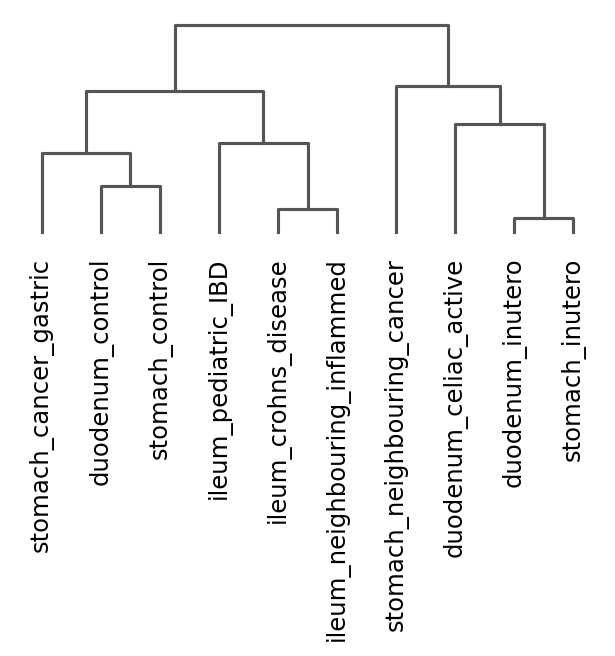

<AxesSubplot:>

In [124]:
plt.rcParams['figure.figsize'] = [5,2]
sc.pl.dendrogram(muc6_downsample,groupby='organ_disease')

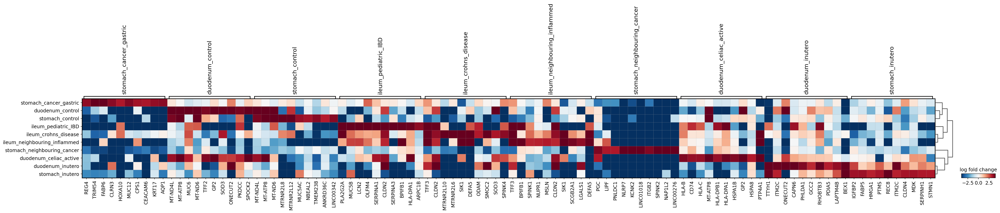

In [125]:
sc.pl.rank_genes_groups_matrixplot(
    muc6_downsample,
    n_genes=10,
    values_to_plot="logfoldchanges",
    cmap='RdBu_r',
    vmin=-4,
    vmax=4,
    min_logfoldchange=3,
    colorbar_title='log fold change',
)

In [126]:
muc6_downsample

AnnData object with n_obs × n_vars = 6887 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spli

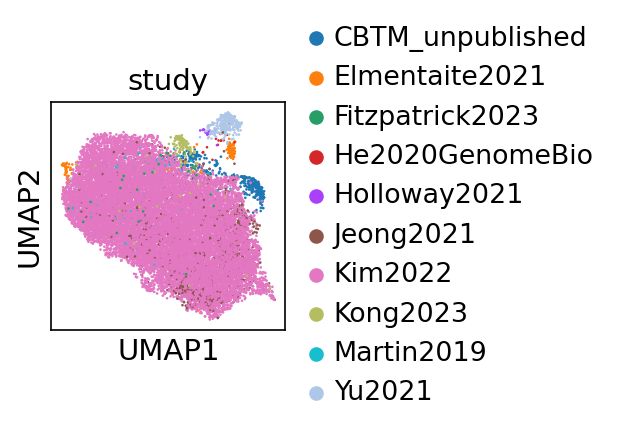

In [127]:
plt.rcParams['figure.figsize'] = [2,2]
sc.pl.umap(plot_full_muc6,color='study')

In [128]:
plot_full_muc6

AnnData object with n_obs × n_vars = 19054 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

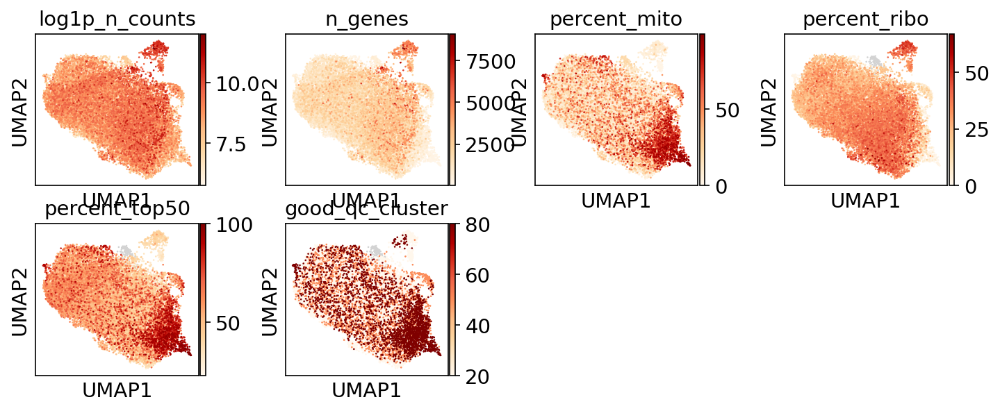

In [129]:
sc.pl.umap(plot_full_muc6,color=['log1p_n_counts','n_genes','percent_mito','percent_ribo','percent_top50','good_qc_cluster'],cmap='OrRd')

remove mitochondrial and ribosomal genes before calculating differentially expressed genes

# MUC6 comparison downsampled without MT/Ribo genes

In [130]:
#remove technical artifacts from malat, mito and ribo genes from matrix
malat1 = adata.var_names.str.startswith('MALAT1')
mito_genes1 = adata.var_names.str.startswith('MT-')
mito_genes2 = adata.var_names.str.startswith('MTRNR')
ribo_genes1 = adata.var_names.str.startswith('RPL')
ribo_genes2 = adata.var_names.str.startswith('RPS')


remove = np.add(mito_genes1, mito_genes2)
remove = np.add(remove, ribo_genes1)
remove = np.add(remove, ribo_genes2)
remove = np.add(remove, malat1)
keep = np.invert(remove)

muc6_deg = muc6_downsample[:,keep]

print(muc6_deg.n_obs, muc6_deg.n_vars)

6887 18360


In [131]:
muc6_deg

View of AnnData object with n_obs × n_vars = 6887 × 18360
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts

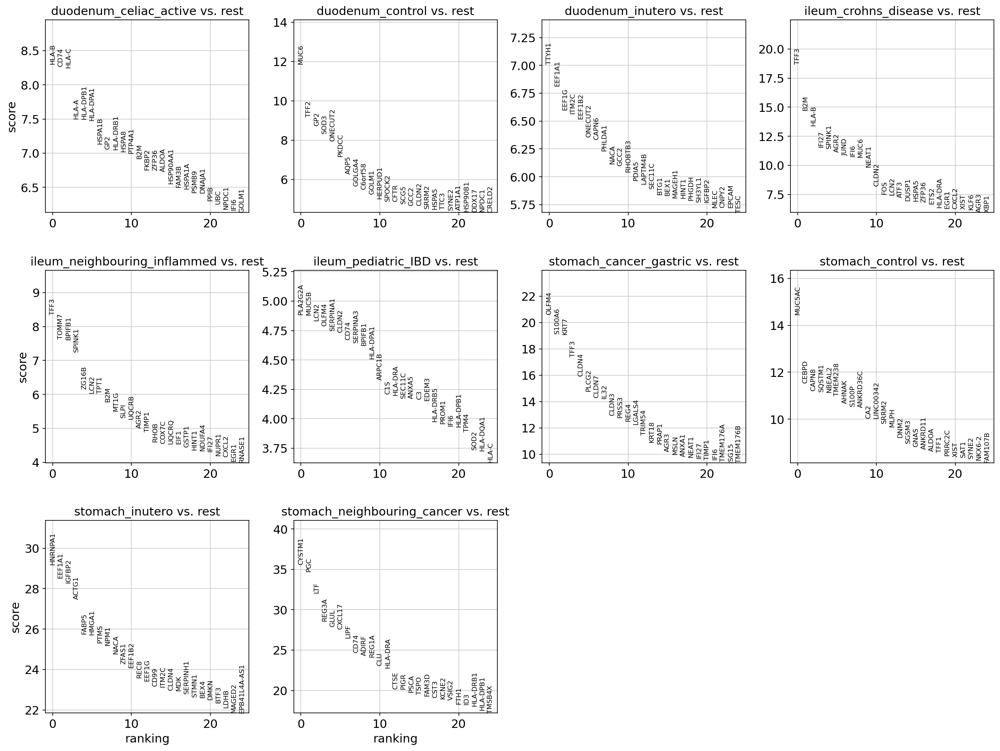

In [132]:
plt.rcParams['figure.figsize'] = [5,5]
sc.tl.rank_genes_groups(muc6_deg,groupby='organ_disease',method='wilcoxon')
sc.pl.rank_genes_groups(muc6_deg, n_genes=25, sharey=False)

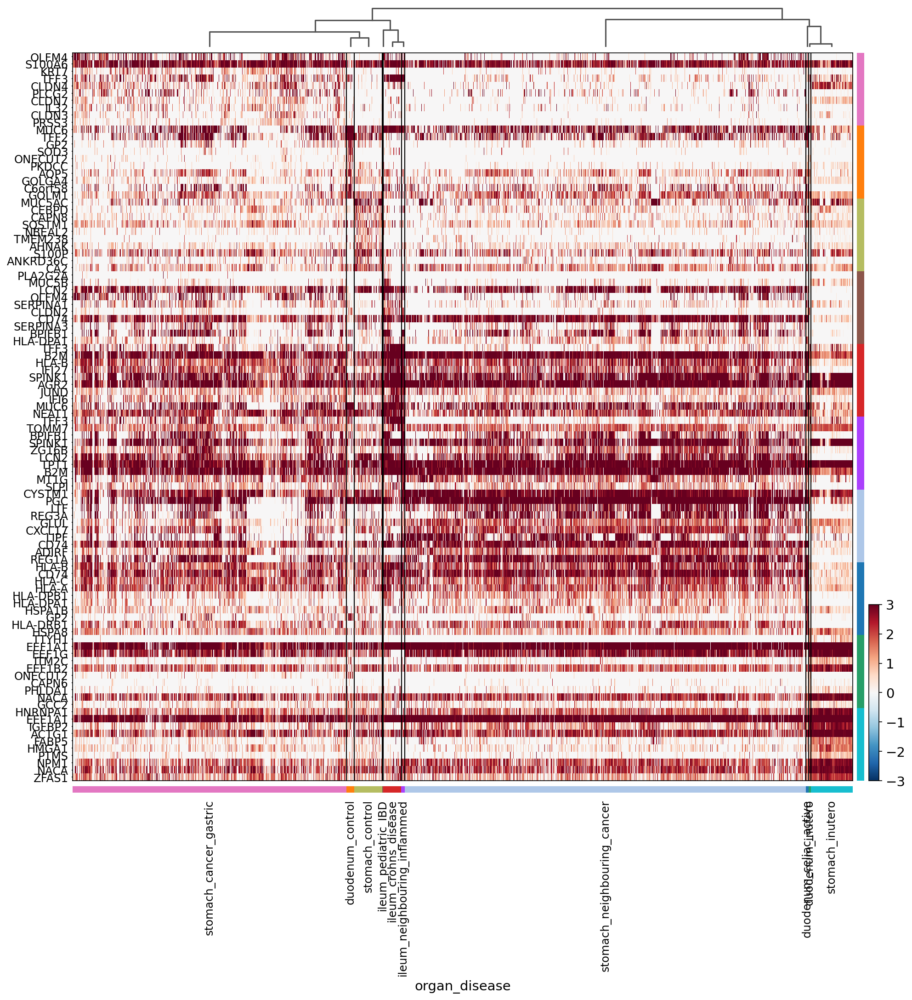

In [133]:
sc.tl.rank_genes_groups(muc6_deg,groupby='organ_disease',method='wilcoxon')
sc.tl.dendrogram(muc6_deg, groupby='organ_disease')
sc.pl.rank_genes_groups_heatmap(muc6_deg,groupby='organ_disease', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=True,
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(15,15),save='muc6_downsample_noMTorRPgenes_heatmap.pdf')

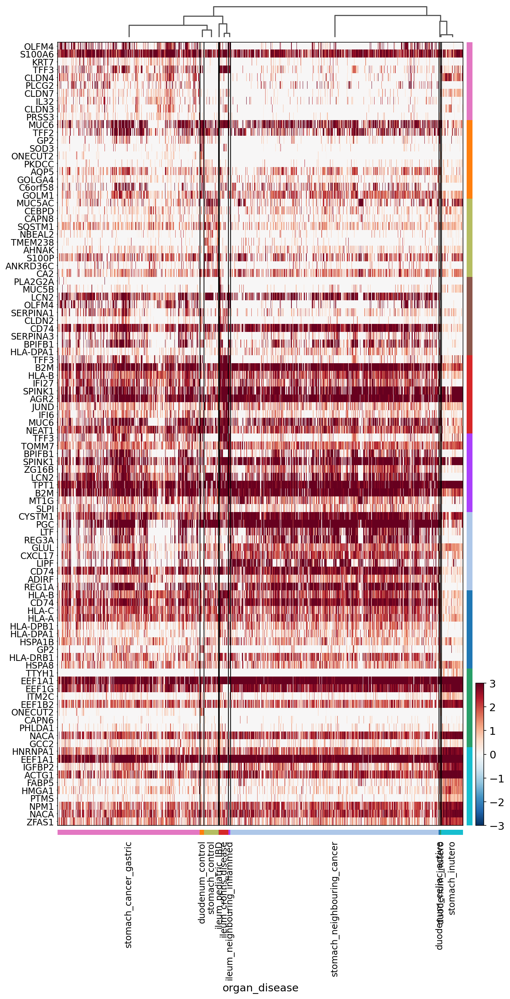

In [134]:
sc.pl.rank_genes_groups_heatmap(muc6_deg,groupby='organ_disease', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=True,
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(10,20),save='muc6_downsample_noMTorRPgenes_heatmap.pdf')

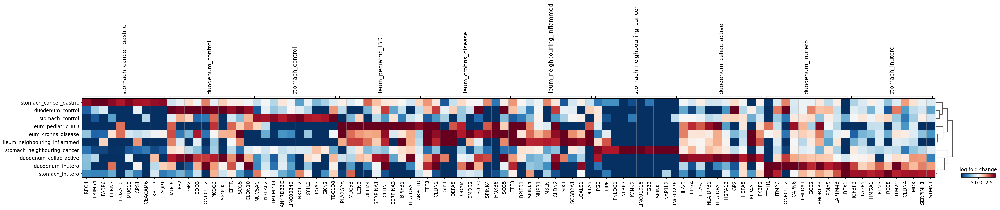

In [135]:
sc.pl.rank_genes_groups_matrixplot(
    muc6_deg,
    n_genes=10,
    values_to_plot="logfoldchanges",
    cmap='RdBu_r',
    vmin=-4,
    vmax=4,
    min_logfoldchange=3,
    colorbar_title='log fold change',
)

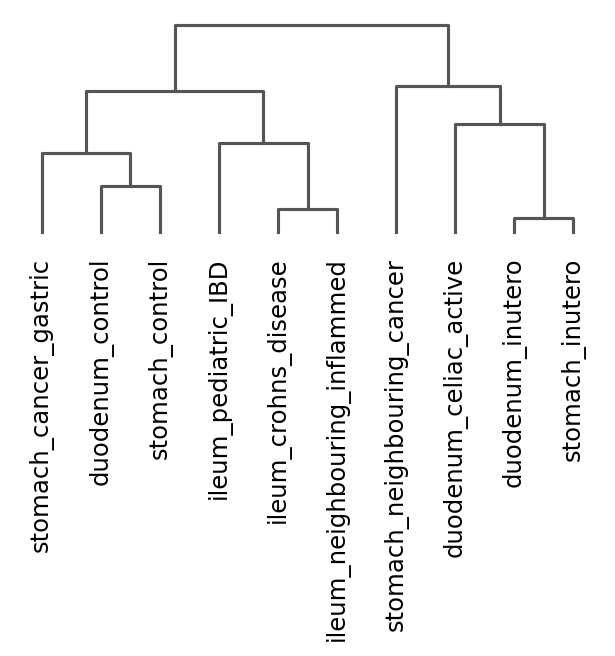

<AxesSubplot:>

In [136]:
plt.rcParams['figure.figsize'] = [5,2]
sc.pl.dendrogram(muc6_deg,groupby='organ_disease')

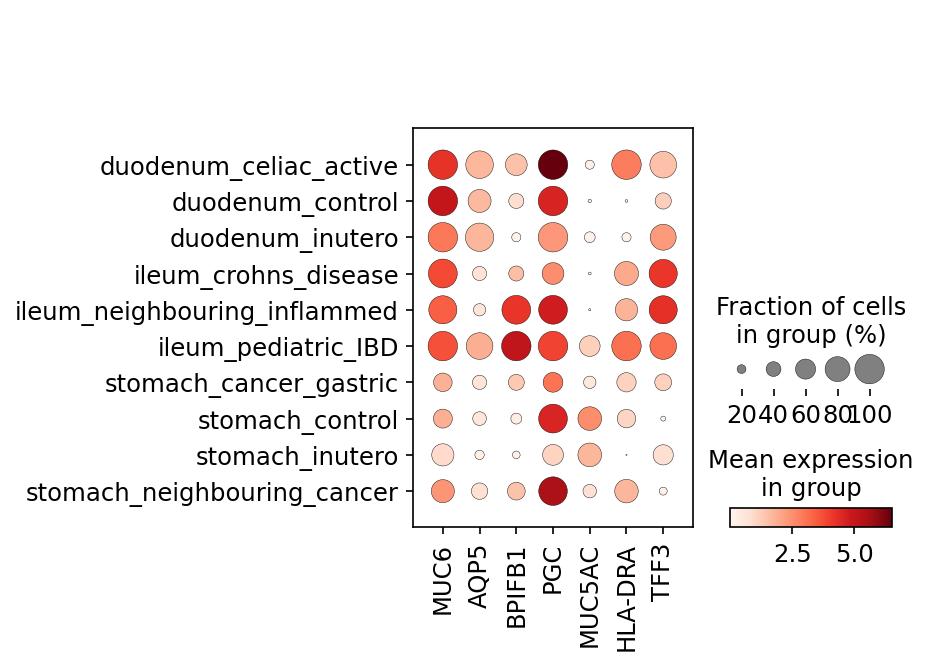

In [137]:
sc.pl.dotplot(muc6_deg,var_names=['MUC6','AQP5','BPIFB1','PGC','MUC5AC','HLA-DRA','TFF3'],groupby='organ_disease')

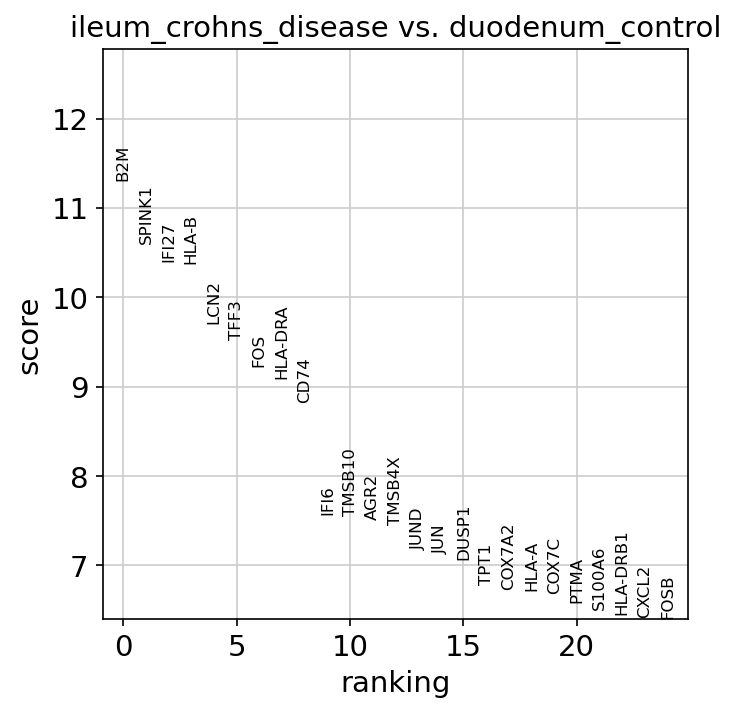

In [138]:
plt.rcParams['figure.figsize'] = [5,5]
sc.tl.rank_genes_groups(muc6_deg,groupby='organ_disease',groups=['ileum_crohns_disease'], reference='duodenum_control', method='wilcoxon',key_added = "wilcoxon")
sc.pl.rank_genes_groups(muc6_deg, n_genes=25, sharey=False, key="wilcoxon")

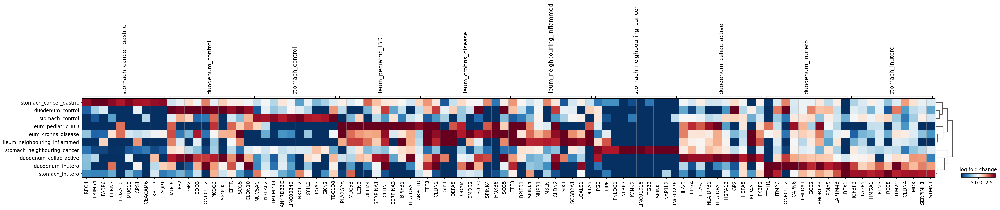

In [139]:
sc.pl.rank_genes_groups_matrixplot(
    muc6_deg,
    n_genes=10,
    values_to_plot="logfoldchanges",
    cmap='RdBu_r',
    vmin=-4,
    vmax=4,
    min_logfoldchange=3,
    colorbar_title='log fold change',
)

In [141]:
#?gseapy.enrichr
glist = sc.get.rank_genes_groups_df(muc6_deg, group='ileum_crohns_disease', 
                                    key='wilcoxon', log2fc_min=0.25, 
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(glist))

88


In [142]:
disease_vs_ileum = glist

In [143]:
disease_vs_duodenum = disease_vs_ileum

In [144]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=glist, # or "./tests/data/gene_list.txt", 
                 gene_sets=['MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Biological_Process_2018'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

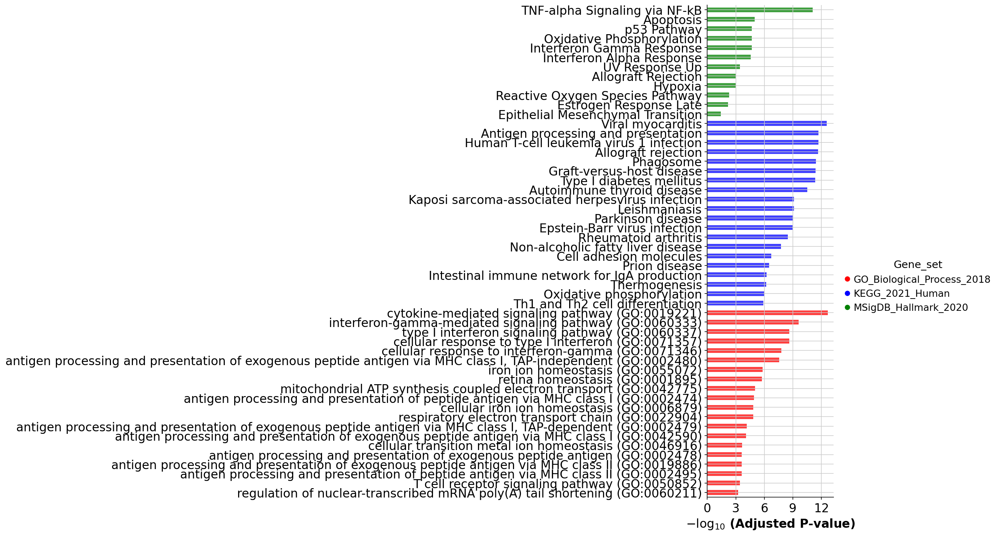

In [145]:
# categorical scatterplot
ax = barplot(enr.results, 
              column="Adjusted P-value", 
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10, 
              top_term=20,
              figsize=(3,12), 
              color=['red', 'blue','green'] # set colors for group
             )

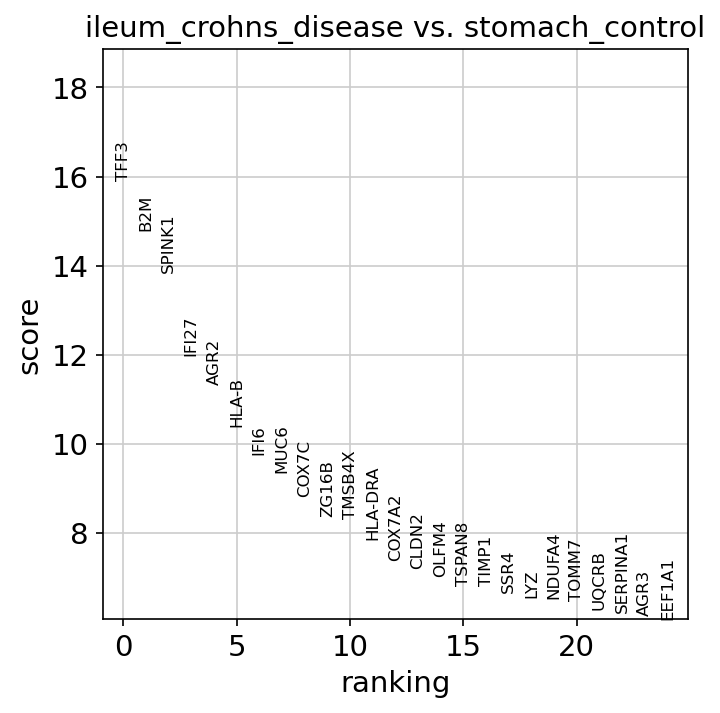

In [146]:
sc.tl.rank_genes_groups(muc6_deg,groupby='organ_disease',groups=['ileum_crohns_disease'], reference='stomach_control', method='wilcoxon',key_added = "wilcoxon")
sc.pl.rank_genes_groups(muc6_deg, n_genes=25, sharey=False, key="wilcoxon")

In [147]:
#?gseapy.enrichr
glist = sc.get.rank_genes_groups_df(muc6_deg, group='ileum_crohns_disease', 
                                    key='wilcoxon', log2fc_min=0.25, 
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(glist))

99


In [148]:
disease_vs_stomach = glist

In [149]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=glist, # or "./tests/data/gene_list.txt", 
                 gene_sets=['MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Biological_Process_2018'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

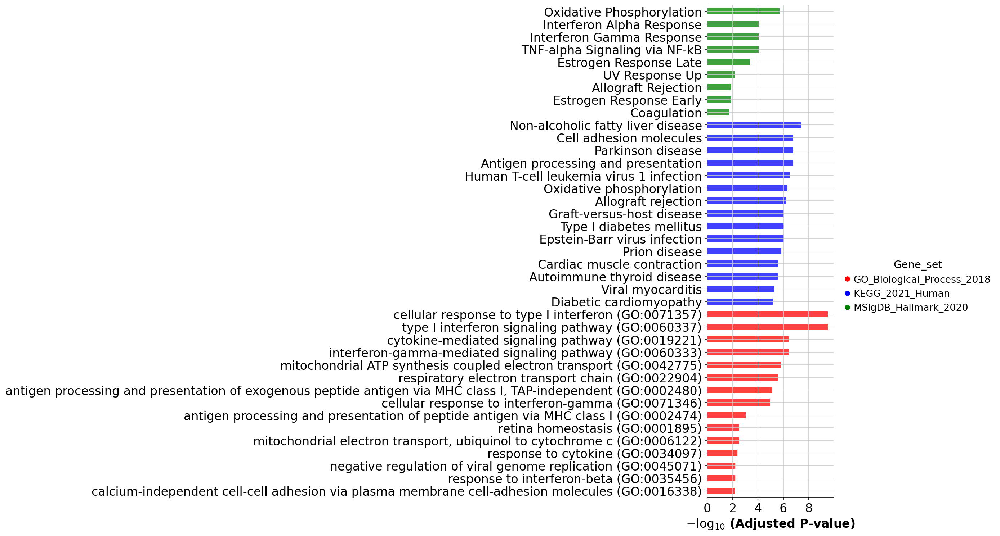

In [150]:
# categorical scatterplot
ax = barplot(enr.results, 
              column="Adjusted P-value", 
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10, 
              top_term=15,
              figsize=(3,12), 
              color=['red', 'blue','green'] # set colors for group
             )

In [151]:
muc6_deg.obs.organ_disease.value_counts()

stomach_neighbouring_cancer     3541
stomach_cancer_gastric          2416
stomach_inutero                  369
stomach_control                  248
ileum_crohns_disease             159
duodenum_control                  71
ileum_neighbouring_inflammed      32
duodenum_celiac_active            24
duodenum_inutero                  19
ileum_pediatric_IBD                8
Name: organ_disease, dtype: int64

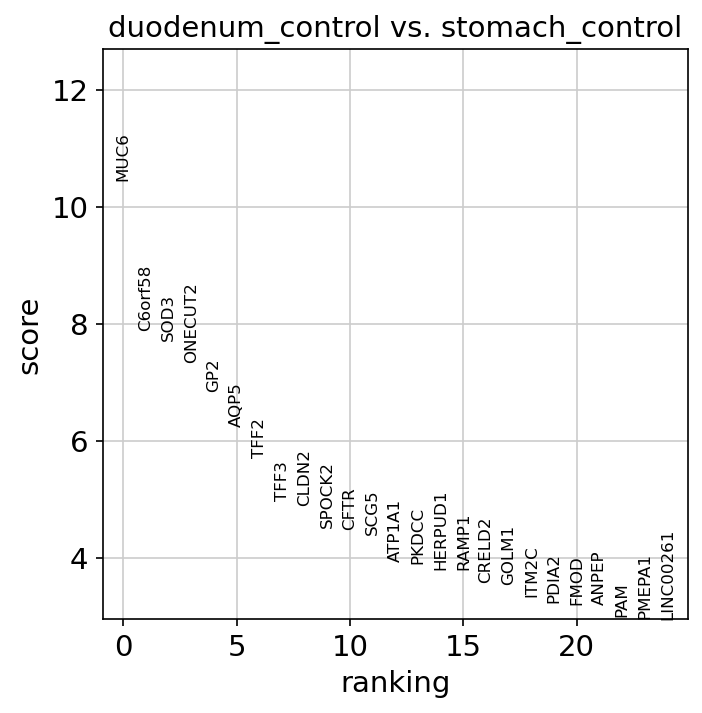

In [152]:
sc.tl.rank_genes_groups(muc6_deg,groupby='organ_disease',groups=['duodenum_control'], reference='stomach_control', method='wilcoxon')
sc.pl.rank_genes_groups(muc6_deg, n_genes=25, sharey=False)

In [153]:
#?gseapy.enrichr
glist = sc.get.rank_genes_groups_df(muc6_deg, group='duodenum_control', 
                                     log2fc_min=0.25, 
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(glist))

18


In [154]:
stomach_vs_duodenum = glist

In [156]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=glist, # or "./tests/data/gene_list.txt", 
                 gene_sets=['MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Biological_Process_2018'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

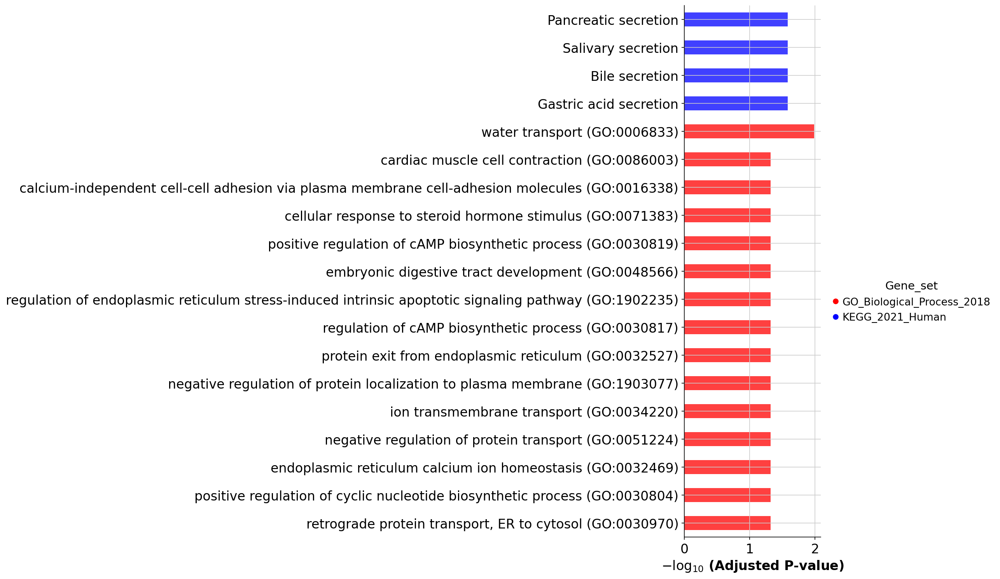

In [157]:
# categorical scatterplot
ax = barplot(enr.results, 
              column="Adjusted P-value", 
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10, 
              top_term=15,
              figsize=(3,12), 
              color=['red', 'blue','green'] # set colors for group
             )

make venn diagrams for DEG between 3 groups (crohn's vs duodenum, crohn's vs stomach, stomach vs duodenum)

In [162]:
sc.tl.rank_genes_groups(muc6_deg,groupby='organ_disease',groups=['duodenum_control'], reference='stomach_control', method='wilcoxon')
stomach_vs_duodenum = sc.get.rank_genes_groups_df(muc6_deg, group='duodenum_control',  
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(stomach_vs_duodenum))

170


In [163]:
muc6_deg.obs.organ_disease.value_counts()

stomach_neighbouring_cancer     3541
stomach_cancer_gastric          2416
stomach_inutero                  369
stomach_control                  248
ileum_crohns_disease             159
duodenum_control                  71
ileum_neighbouring_inflammed      32
duodenum_celiac_active            24
duodenum_inutero                  19
ileum_pediatric_IBD                8
Name: organ_disease, dtype: int64

In [164]:
sc.tl.rank_genes_groups(muc6_deg,groupby='organ_disease',groups=['ileum_crohns_disease'], reference='stomach_control', method='wilcoxon',key_added = "wilcoxon")
disease_vs_stomach = sc.get.rank_genes_groups_df(muc6_deg, group='ileum_crohns_disease', 
                                    key='wilcoxon', 
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(disease_vs_stomach))

956


In [165]:
sc.tl.rank_genes_groups(muc6_deg,groupby='organ_disease',groups=['ileum_crohns_disease'], reference='duodenum_control', method='wilcoxon',key_added = "wilcoxon")

disease_vs_duodenum = sc.get.rank_genes_groups_df(muc6_deg, group='ileum_crohns_disease', 
                                    key='wilcoxon', 
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(disease_vs_duodenum))

110


In [166]:
pip install matplotlib-venn

Note: you may need to restart the kernel to use updated packages.


In [167]:
disease_vs_duodenum

['B2M',
 'SPINK1',
 'IFI27',
 'HLA-B',
 'LCN2',
 'TFF3',
 'FOS',
 'HLA-DRA',
 'CD74',
 'IFI6',
 'TMSB10',
 'AGR2',
 'TMSB4X',
 'JUND',
 'JUN',
 'DUSP1',
 'TPT1',
 'COX7A2',
 'HLA-A',
 'COX7C',
 'PTMA',
 'S100A6',
 'HLA-DRB1',
 'CXCL2',
 'FOSB',
 'CYBA',
 'ZFP36',
 'ATF3',
 'ZG16B',
 'KLF6',
 'EGR1',
 'UBB',
 'UQCRB',
 'TOMM7',
 'EEF1A1',
 'RHOB',
 'HLA-C',
 'HLA-DPA1',
 'NDUFA4',
 'SSR4',
 'SMIM22',
 'PIGR',
 'COX6C',
 'TXN',
 'FAU',
 'NDUFB1',
 'H3F3A',
 'H3F3B',
 'FAM3D',
 'SAT1',
 'HLA-DPB1',
 'FTL',
 'UBA52',
 'ISG15',
 'LIPF',
 'AGR3',
 'SEC61G',
 'FTH1',
 'HLA-DRB5',
 'BTG2',
 'UQCRH',
 'XIST',
 'SRP14',
 'CALM2',
 'IFITM3',
 'S100A10',
 'ACTB',
 'S100P',
 'COMMD6',
 'CXCL3',
 'TSPAN8',
 'SLPI',
 'UQCRQ',
 'OST4',
 'ACTG1',
 'SERF2',
 'MIA',
 'POLR2L',
 'TIMP1',
 'HLA-E',
 'PABPC1',
 'ETS2',
 'HINT1',
 'ITM2B',
 'TM4SF1',
 'FKBP2',
 'SOD1',
 'FXYD3',
 'ANXA4',
 'HSPG2',
 'SPOCK2',
 'DDX17',
 'CRELD2',
 'GOLGA4',
 'IGFBP2',
 'DDX39B',
 'PDIA2',
 'NPDC1',
 'SRRM2',
 'LINC00261',
 '

In [168]:
from matplotlib_venn import venn3

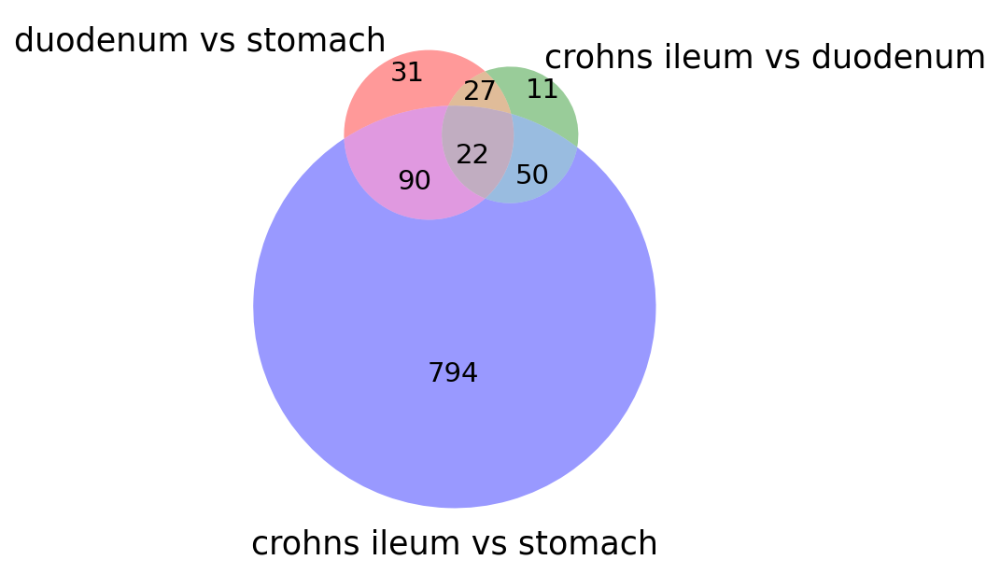

In [169]:
set1 = set(stomach_vs_duodenum)
set2 = set(disease_vs_duodenum)
set3 = set(disease_vs_stomach)

venn3([set1, set2, set3], ('duodenum vs stomach', 'crohns ileum vs duodenum', 'crohns ileum vs stomach'))

plt.show()

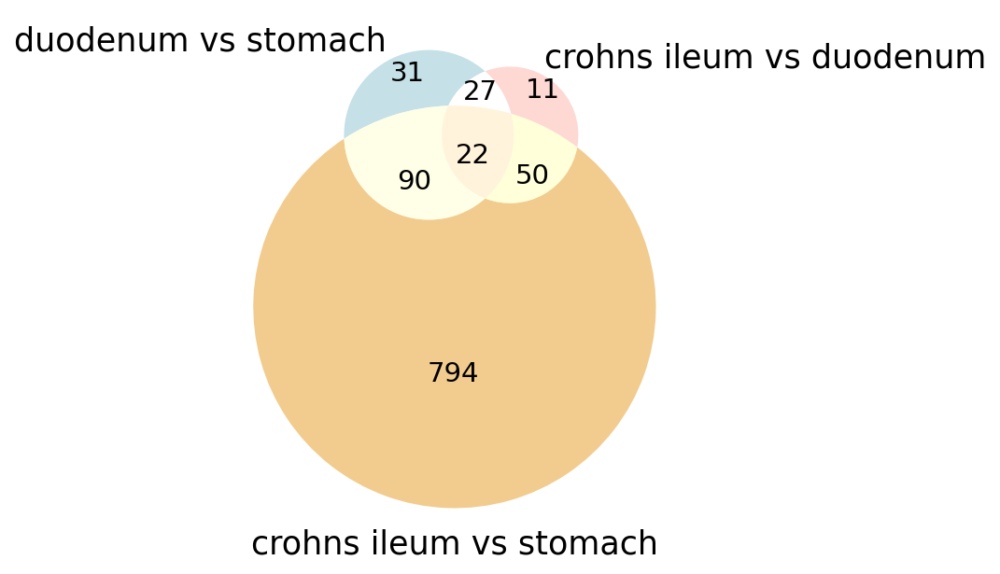

In [170]:
venn3([set1, set2, set3], set_labels=('duodenum vs stomach', 'crohns ileum vs duodenum', 'crohns ileum vs stomach'),set_colors=('#ADD3DD', '#fec8c1','#edb75f'), alpha = 0.7)
plt.savefig('venn_test.pdf')

In [171]:
#extract overlapping gene lists

set1 = set(stomach_vs_duodenum)
set2 = set(disease_vs_duodenum)
set3 = set(disease_vs_stomach)

common_disease = set2.intersection(set3)
print("Overlapping genes:", common_disease)


Overlapping genes: {'OST4', 'TMSB4X', 'TIMP1', 'COMMD6', 'PKDCC', 'NDUFB1', 'SEC61G', 'IFI6', 'LIPF', 'UQCRH', 'ETS2', 'NDUFA4', 'TFF3', 'MUC6', 'PTMA', 'HLA-B', 'SRRM2', 'HLA-DPA1', 'TM4SF1', 'GP2', 'CXCL2', 'SSR4', 'TOMM7', 'UQCRQ', 'IFI27', 'ZG16B', 'SOD3', 'GOLGA4', 'AGR2', 'SAT1', 'TSPAN8', 'B2M', 'DDX39B', 'AGR3', 'PGC', 'ISG15', 'HLA-DRA', 'DUSP1', 'COX6C', 'ITM2B', 'MIA', 'GOLM1', 'IGFBP2', 'MEIS2', 'SPINK1', 'COX7A2', 'H3F3A', 'SRP14', 'SMIM22', 'JUND', 'ATF3', 'UQCRB', 'IFITM3', 'FAU', 'FXYD3', 'FOS', 'HLA-A', 'DDX17', 'S100A10', 'HLA-DPB1', 'FKBP2', 'COX7C', 'FAM3D', 'S100P', 'PIGR', 'HSPG2', 'SLPI', 'TFF2', 'HLA-C', 'EGR1', 'EEF1A1', 'ANXA4'}


In [172]:
print(len(common_disease))

72


In [173]:
all_common = set(common_disease).intersection(set1)
print("Overlapping genes:", all_common)

Overlapping genes: {'PKDCC', 'TFF3', 'MUC6', 'PTMA', 'GP2', 'CXCL2', 'IFI27', 'SOD3', 'SAT1', 'B2M', 'HLA-DRA', 'DUSP1', 'GOLM1', 'JUND', 'ATF3', 'HLA-A', 'FOS', 'S100P', 'EGR1', 'TFF2', 'HLA-C', 'HLA-B'}


In [174]:
print(len(all_common))

22


In [175]:
all_common

{'ATF3',
 'B2M',
 'CXCL2',
 'DUSP1',
 'EGR1',
 'FOS',
 'GOLM1',
 'GP2',
 'HLA-A',
 'HLA-B',
 'HLA-C',
 'HLA-DRA',
 'IFI27',
 'JUND',
 'MUC6',
 'PKDCC',
 'PTMA',
 'S100P',
 'SAT1',
 'SOD3',
 'TFF2',
 'TFF3'}

In [176]:
genes_to_remove = set(all_common)
gene_list = list(filter(lambda gene: gene not in genes_to_remove, common_disease))
print(gene_list)

['OST4', 'TMSB4X', 'TIMP1', 'COMMD6', 'NDUFB1', 'SEC61G', 'IFI6', 'LIPF', 'UQCRH', 'ETS2', 'NDUFA4', 'SRRM2', 'HLA-DPA1', 'TM4SF1', 'SSR4', 'TOMM7', 'UQCRQ', 'ZG16B', 'GOLGA4', 'AGR2', 'TSPAN8', 'DDX39B', 'AGR3', 'PGC', 'ISG15', 'COX6C', 'ITM2B', 'MIA', 'IGFBP2', 'MEIS2', 'SPINK1', 'COX7A2', 'H3F3A', 'SRP14', 'SMIM22', 'UQCRB', 'IFITM3', 'FAU', 'FXYD3', 'DDX17', 'S100A10', 'HLA-DPB1', 'FKBP2', 'COX7C', 'FAM3D', 'PIGR', 'HSPG2', 'SLPI', 'EEF1A1', 'ANXA4']


In [177]:
print(len(gene_list))

50


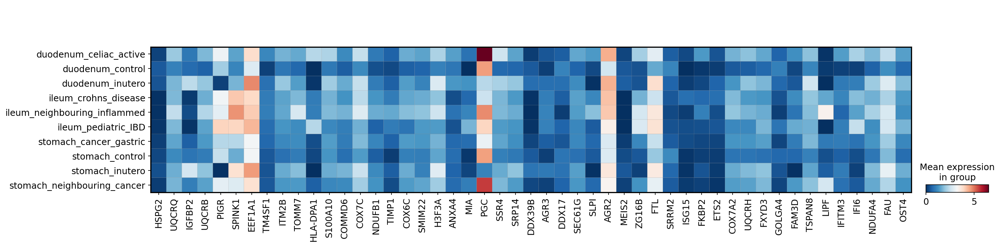

In [178]:
var_names = ['HSPG2', 'UQCRQ', 'IGFBP2', 'UQCRB', 'PIGR', 'SPINK1', 'EEF1A1', 
             'TM4SF1', 'ITM2B', 'TOMM7', 'HLA-DPA1', 'S100A10', 'COMMD6', 'COX7C', 
             'NDUFB1', 'TIMP1', 'COX6C', 'SMIM22', 'H3F3A', 'ANXA4', 'MIA', 'PGC', 'SSR4', 
             'SRP14', 'DDX39B', 'AGR3', 'DDX17', 'SEC61G', 'SLPI', 'AGR2', 'MEIS2', 'ZG16B',
             'FTL', 'SRRM2', 'ISG15', 'FKBP2', 'ETS2', 'COX7A2', 'UQCRH', 'FXYD3', 'GOLGA4', 
             'FAM3D', 'TSPAN8', 'LIPF', 'IFITM3', 'IFI6', 'NDUFA4', 'FAU', 'OST4']
sc.pl.matrixplot(
    muc6_deg,
    var_names=var_names,
    groupby='organ_disease',cmap='RdBu_r'
    
)

In [179]:
muc6_downsample

AnnData object with n_obs × n_vars = 6887 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spli

In [180]:
muc6_nofetal = muc6_downsample[~muc6_downsample.obs.organ_disease.isin(['duodenum_inutero','stomach_inutero'])].copy()

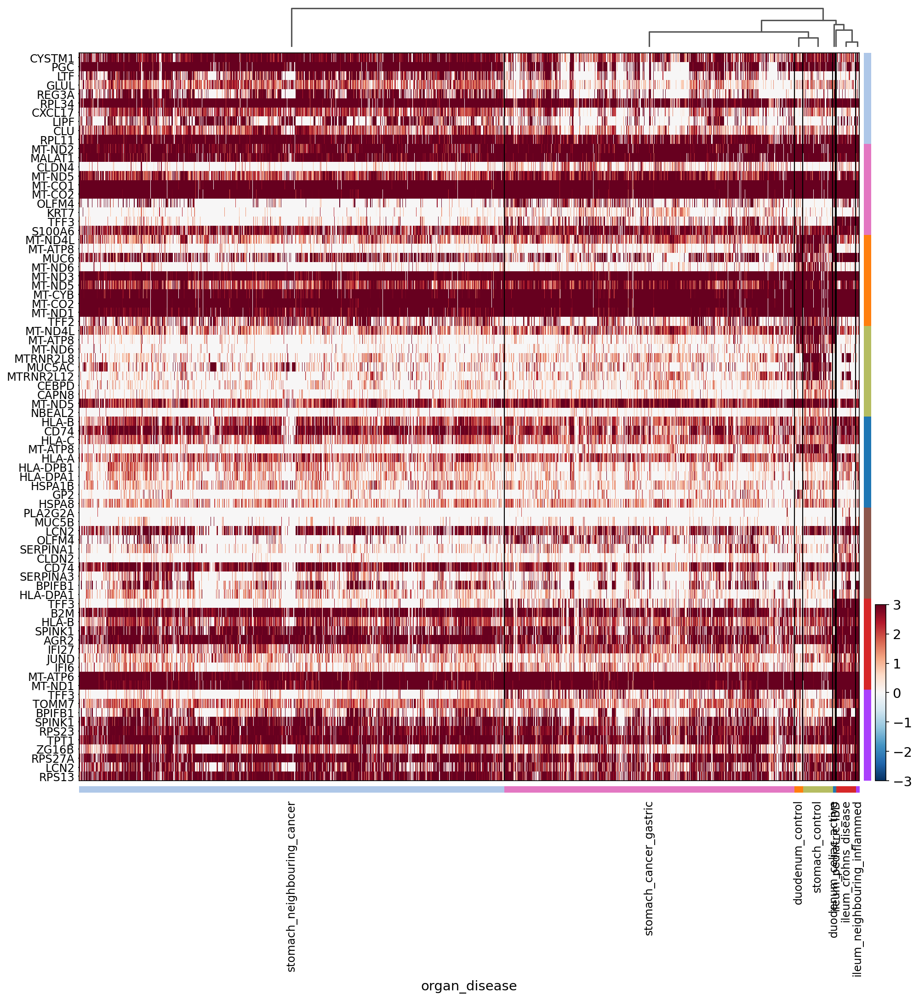

In [181]:
sc.tl.rank_genes_groups(muc6_nofetal,groupby='organ_disease',method='wilcoxon')
sc.tl.dendrogram(muc6_nofetal, groupby='organ_disease')
sc.pl.rank_genes_groups_heatmap(muc6_nofetal,groupby='organ_disease', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=True,
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(15,15))

In [182]:
muc6_nonfetal_deg = muc6_deg[~muc6_deg.obs.organ_disease.isin(['duodenum_inutero','stomach_inutero'])].copy()

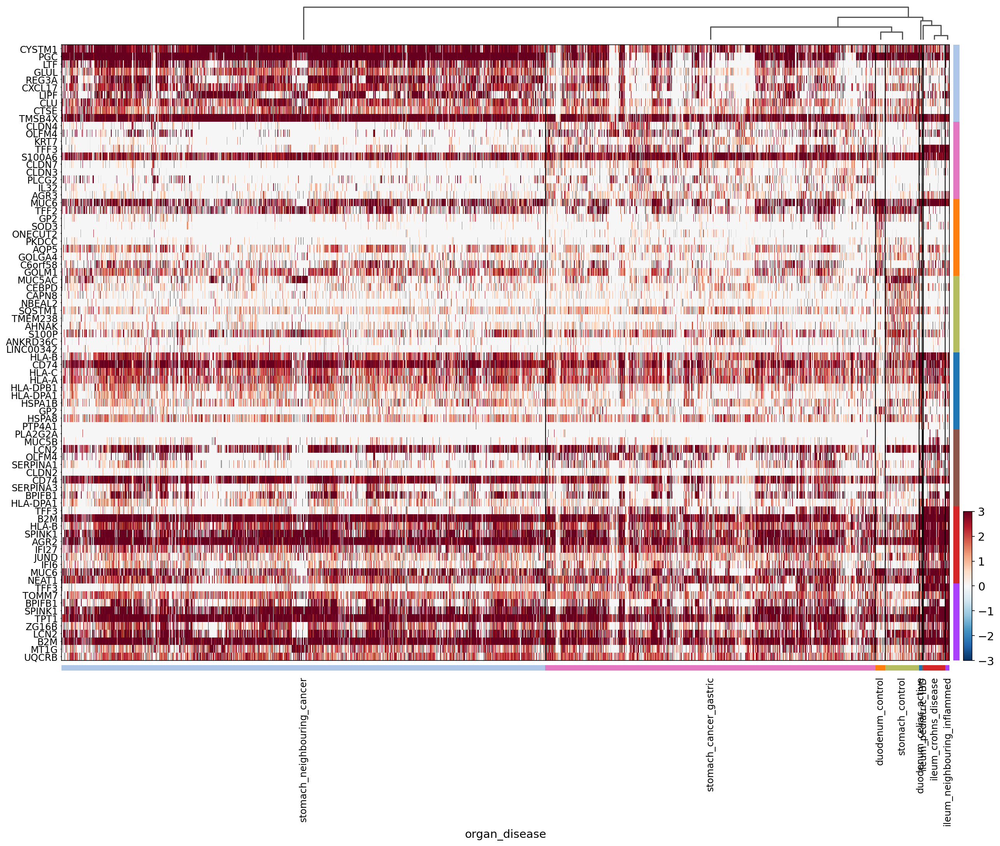

In [183]:
sc.tl.rank_genes_groups(muc6_nonfetal_deg,groupby='organ_disease',method='wilcoxon')
sc.tl.dendrogram(muc6_nonfetal_deg, groupby='organ_disease')
sc.pl.rank_genes_groups_heatmap(muc6_nonfetal_deg,groupby='organ_disease', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=True,
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(20,15),save='muc6_nofetal_noMTorRBgenes_heatmapdendro.pdf')

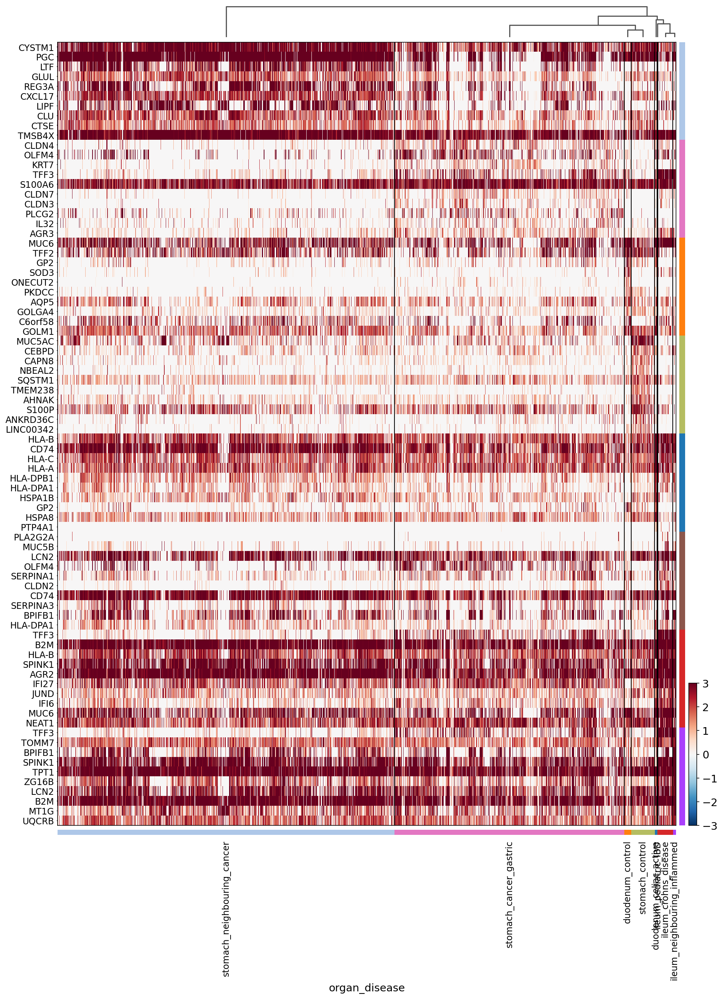

In [184]:
sc.pl.rank_genes_groups_heatmap(muc6_nonfetal_deg,groupby='organ_disease', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=True,
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(15,20),save='muc6_nofetal_noMTorRBgenes_heatmapdendro.pdf')

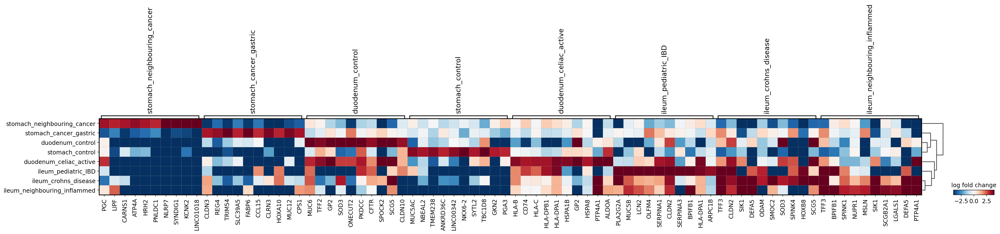

In [185]:
#included in supplementary figure
sc.pl.rank_genes_groups_matrixplot(
    muc6_nonfetal_deg,
    n_genes=10,
    values_to_plot="logfoldchanges",
    cmap='RdBu_r',
    vmin=-4,
    vmax=4,
    min_logfoldchange=3,
    colorbar_title='log fold change',
save='logFC_muc6_nofetal_noMTorRBgenes_heatmapdendro_organ_disease.pdf')

In [186]:
muc6_nonfetal_deg.obs['organ_disease2'] = (
    muc6_nonfetal_deg.obs['organ_disease']
    .map(lambda x: {
        'stomach_neighbouring_cancer':'stomach_control'
    }.get(x,x))
    .astype("category")
)

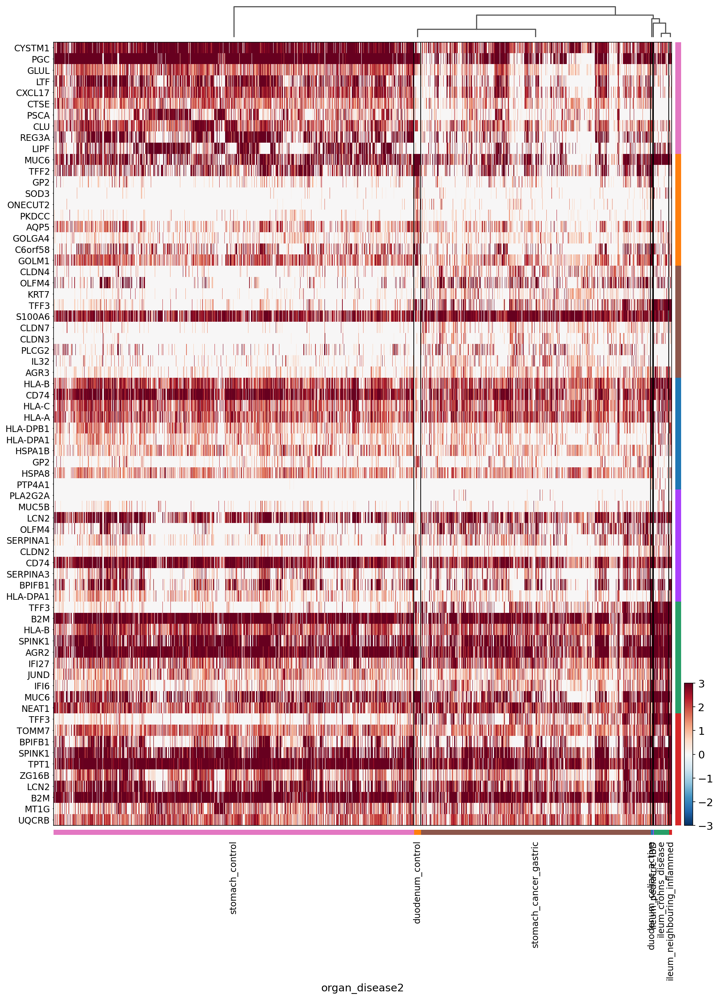

In [187]:
sc.tl.rank_genes_groups(muc6_nonfetal_deg,groupby='organ_disease2',method='wilcoxon')
sc.tl.dendrogram(muc6_nonfetal_deg, groupby='organ_disease2')
sc.pl.rank_genes_groups_heatmap(muc6_nonfetal_deg,groupby='organ_disease2', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=True,
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(15,20),save='muc6_nofetal_noMTorRBgenes_heatmapdendro_organ_disease2.pdf')

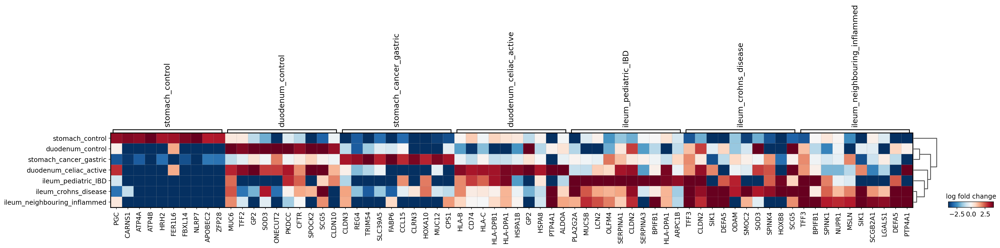

In [188]:
sc.pl.rank_genes_groups_matrixplot(
    muc6_nonfetal_deg,
    n_genes=10,
    values_to_plot="logfoldchanges",
    cmap='RdBu_r',
    vmin=-4,
    vmax=4,
    min_logfoldchange=3,
    colorbar_title='log fold change',
save='logFC_muc6_nofetal_noMTorRBgenes_heatmapdendro_organ_disease2.pdf')

In [189]:
muc6_nonfetal_deg.obs['organ_disease2'] = (
    muc6_nonfetal_deg.obs['organ_disease']
    .map(lambda x: {
        'ileum_pediatric_IBD':'ileum_IBD',
        'ileum_crohns_disease':'ileum_IBD',
         'stomach_neighbouring_cancer':'stomach_control'
    }.get(x,x))
    .astype("category")
)

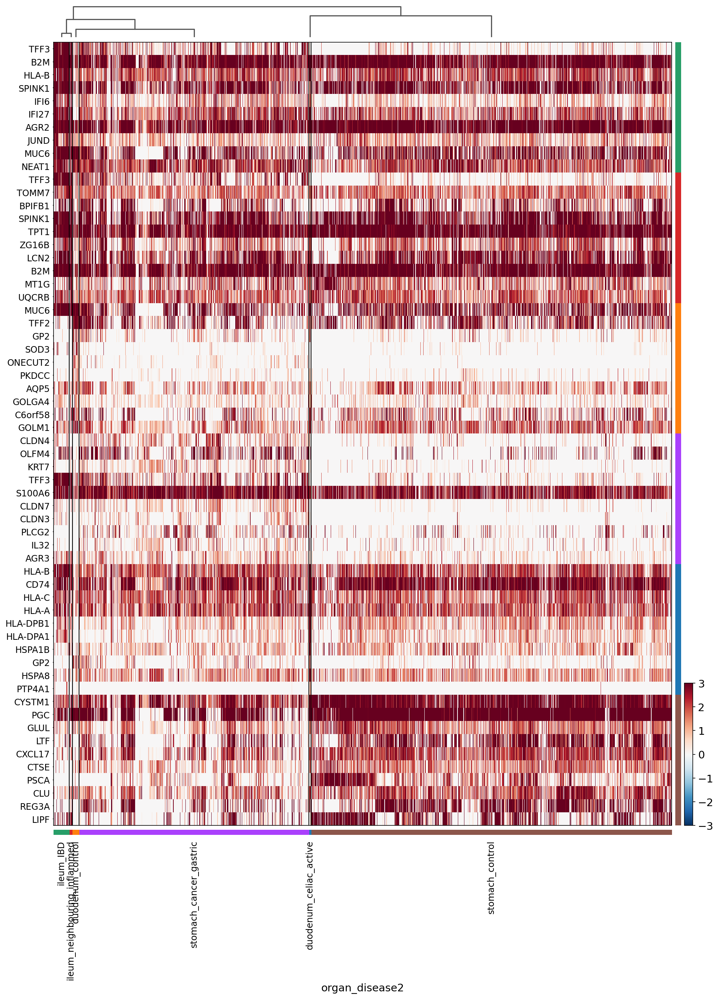

In [190]:
sc.tl.rank_genes_groups(muc6_nonfetal_deg,groupby='organ_disease2',method='wilcoxon')
sc.tl.dendrogram(muc6_nonfetal_deg, groupby='organ_disease2')
sc.pl.rank_genes_groups_heatmap(muc6_nonfetal_deg,groupby='organ_disease2', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=True,
                                vmin=-3, vmax=3, cmap='RdBu_r',figsize=(15,20),save='muc6_nofetal_noMTorRBgenes_heatmapdendro_organ_disease2_newplot.pdf')

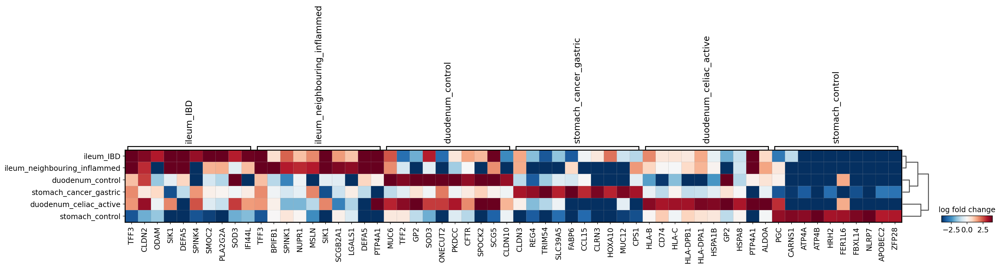

In [192]:
sc.pl.rank_genes_groups_matrixplot(
    muc6_nonfetal_deg,
    n_genes=10,
    values_to_plot="logfoldchanges",
    cmap='RdBu_r',
    vmin=-4,
    vmax=4,
    min_logfoldchange=3,
    colorbar_title='log fold change',
save='logFC_muc6_nofetal_noMTorRBgenes_heatmapdendro_organ_disease2.pdf')

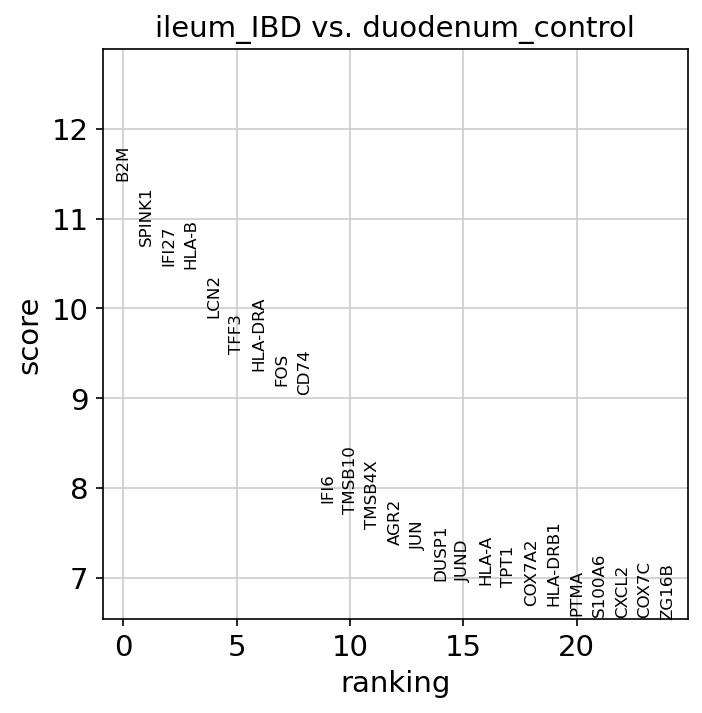

In [207]:
plt.rcParams['figure.figsize'] = [5,5]
sc.tl.rank_genes_groups(muc6_nonfetal_deg,groupby='organ_disease2',groups=['ileum_IBD'], reference='duodenum_control', method='wilcoxon',key_added = "wilcoxon")
sc.pl.rank_genes_groups(muc6_nonfetal_deg, n_genes=25, sharey=False, key="wilcoxon")

In [208]:
#?gseapy.enrichr
glist = sc.get.rank_genes_groups_df(muc6_nonfetal_deg, group='ileum_IBD', 
                                    key='wilcoxon', log2fc_min=0.25, 
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(glist))

90


In [209]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=glist, # or "./tests/data/gene_list.txt", 
                 gene_sets=['MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Biological_Process_2018'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

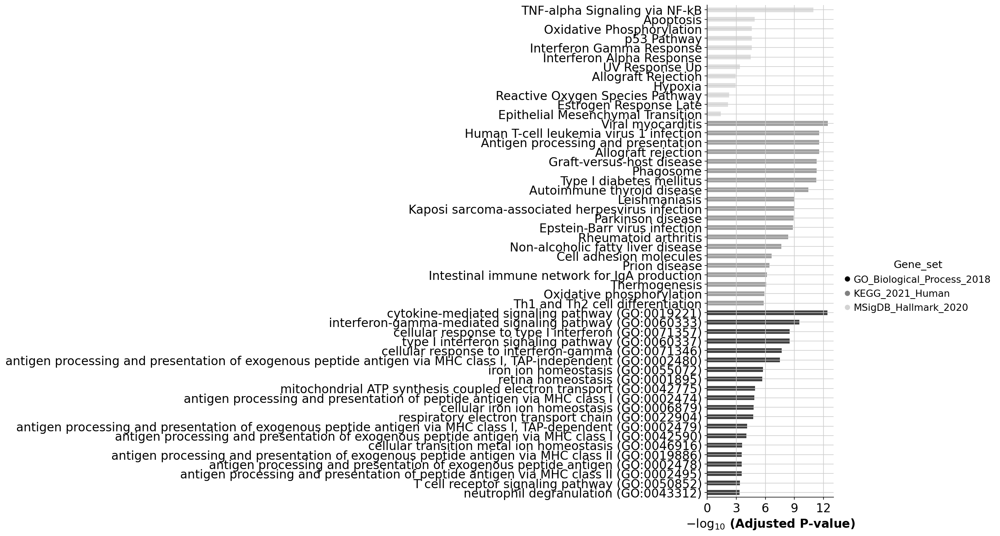

In [210]:
# categorical scatterplot
ax = barplot(enr.results, 
              column="Adjusted P-value", 
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10, 
              top_term=20,
              figsize=(3,12), 
              color=['black', 'grey','lightgrey'], # set colors for group
             )

In [211]:
ax.figure.savefig('Gene_set_IBD_vs_healthy_duodenum.pdf',bbox_inches='tight')

In [217]:
enr.results.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/DGE/Gene_set_IBD_vs_healthy_duodenum.csv')

In [213]:
dge_save = sc.get.rank_genes_groups_df(muc6_nonfetal_deg, group='ileum_IBD', 
                                    key='wilcoxon')

In [214]:
dge_save

,names,scores,logfoldchanges,pvals,pvals_adj
0,B2M,11.423905,4.501481,3.176317e-30,5.831718e-26
1,SPINK1,10.695442,4.929175,1.069080e-26,6.542772e-23
2,IFI27,10.481431,9.199955,1.051408e-25,4.825964e-22
3,HLA-B,10.439246,4.041039,1.641093e-25,6.026092e-22
4,LCN2,9.894957,6.821268,4.378013e-23,1.339672e-19
...,...,...,...,...,...
18355,PGC,-6.464595,-2.966074,1.015704e-10,6.216110e-08
18356,ONECUT2,-6.997567,-7.845322,2.604462e-12,2.656552e-09
18357,MUC6,-8.018238,-1.779171,1.072728e-15,1.641274e-12
18358,GP2,-8.065568,-5.919836,7.289643e-16,1.216708e-12


In [216]:
dge_save.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/DGE/DGE_scanpy_IBD_vs_healthy_duodenum.csv')

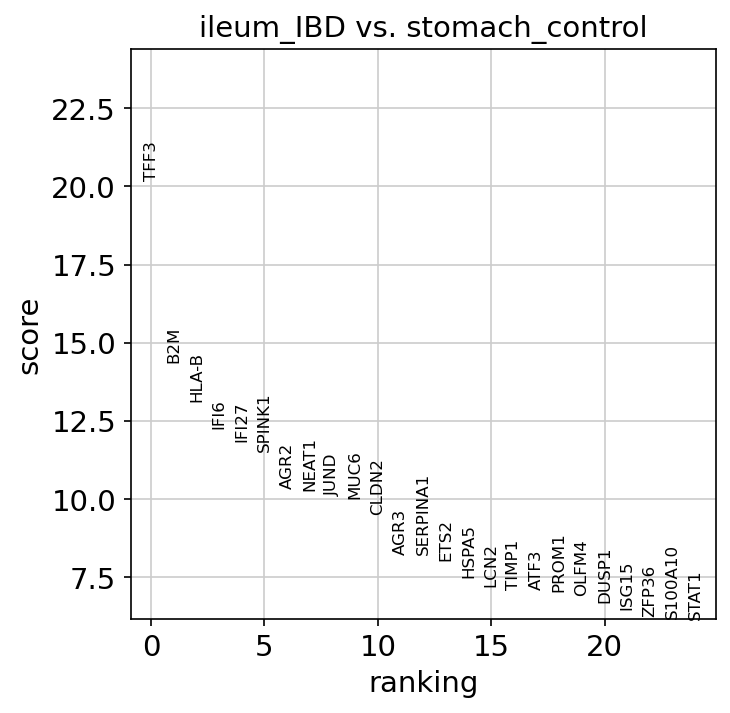

In [218]:
plt.rcParams['figure.figsize'] = [5,5]
sc.tl.rank_genes_groups(muc6_nonfetal_deg,groupby='organ_disease2',groups=['ileum_IBD'], reference='stomach_control', method='wilcoxon',key_added = "wilcoxon")
sc.pl.rank_genes_groups(muc6_nonfetal_deg, n_genes=25, sharey=False, key="wilcoxon")

In [219]:
#?gseapy.enrichr
glist = sc.get.rank_genes_groups_df(muc6_nonfetal_deg, group='ileum_IBD', 
                                    key='wilcoxon', log2fc_min=0.25, 
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(glist))

88


In [220]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=glist, # or "./tests/data/gene_list.txt", 
                 gene_sets=['MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Biological_Process_2018'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

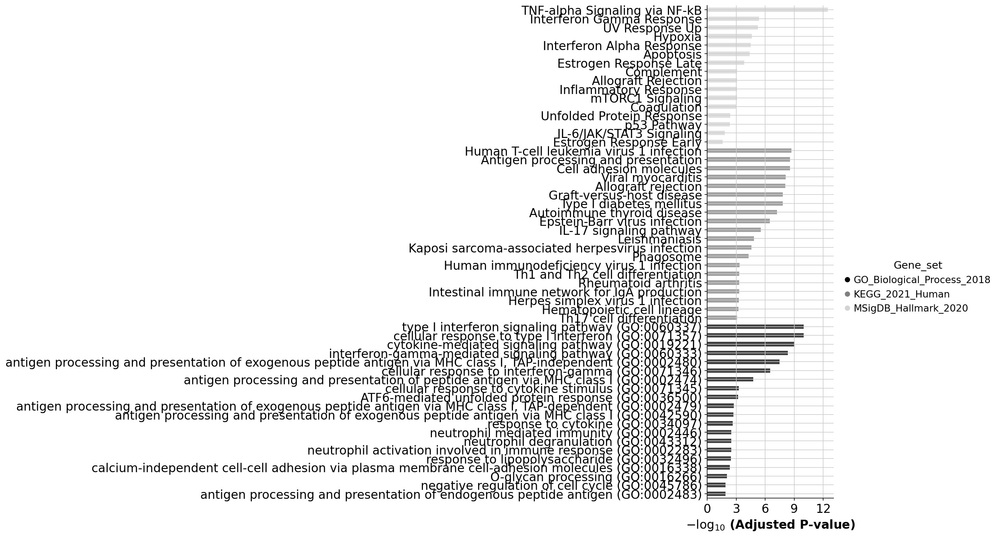

In [221]:
# categorical scatterplot
ax = barplot(enr.results, 
              column="Adjusted P-value", 
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10, 
              top_term=20,
              figsize=(3,12), 
              color=['black', 'grey','lightgrey'], # set colors for group
             )

In [204]:
ax.figure.savefig('Gene_set_IBD_vs_healthy_stomach.pdf',bbox_inches='tight')

In [205]:
enr.results.head()

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,MSigDB_Hallmark_2020,TNF-alpha Signaling via NF-kB,15/200,9.848492e-15,3.446972e-13,0,0,21.910774,706.654401,EGR1;BTG2;DUSP1;FOS;CXCL2;F3;ETS2;RHOB;NR4A1;ZFP36;KLF6;FOSB;SIK1;ATF3;MCL1
1,MSigDB_Hallmark_2020,Interferon Gamma Response,9/200,2.413030e-07,4.222803e-06,0,0,11.762807,179.232393,BST2;APOL6;IFI27;STAT1;HLA-B;ISG15;HLA-A;B2M;IFI44L
2,MSigDB_Hallmark_2020,UV Response Up,8/158,4.778766e-07,5.575227e-06,0,0,13.174667,191.742957,NR4A1;BTG2;EPCAM;FOSB;FOS;CXCL2;ATF3;RHOB
3,MSigDB_Hallmark_2020,Hypoxia,8/200,2.818226e-06,2.465948e-05,0,0,10.270833,131.255119,ZFP36;KLF6;HOXB9;HSPA5;DUSP1;FOS;F3;ATF3
4,MSigDB_Hallmark_2020,Interferon Alpha Response,6/97,4.377709e-06,3.064396e-05,0,0,15.937550,196.653194,BST2;IFI27;HLA-C;ISG15;B2M;IFI44L


In [222]:
enr.results.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/DGE/Gene_set_IBD_vs_healthy_stomach.csv')

In [223]:
dge_save = sc.get.rank_genes_groups_df(muc6_nonfetal_deg, group='ileum_IBD', 
                                    key='wilcoxon')
dge_save.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/DGE/DGE_scanpy_IBD_vs_healthy_stomach.csv')

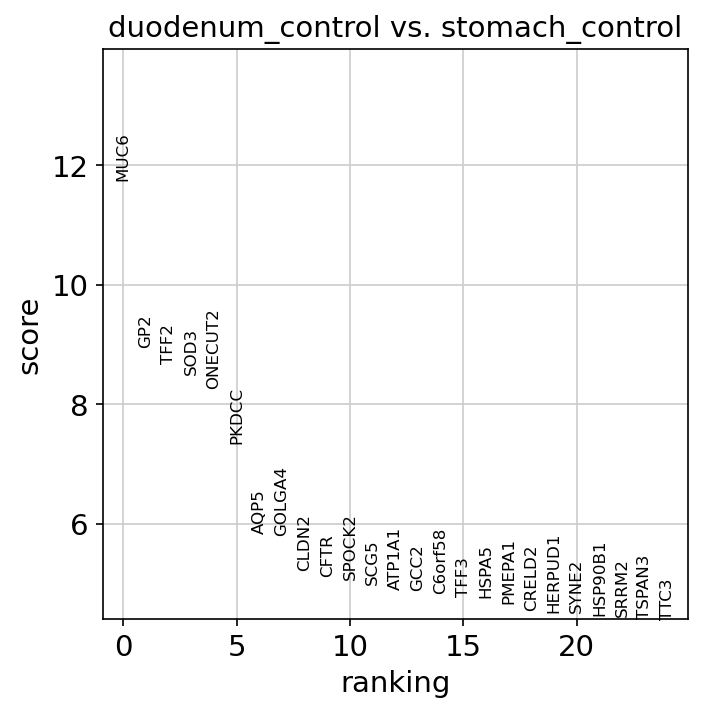

In [224]:
plt.rcParams['figure.figsize'] = [5,5]
sc.tl.rank_genes_groups(muc6_nonfetal_deg,groupby='organ_disease2',groups=['duodenum_control'], reference='stomach_control', method='wilcoxon',key_added = "wilcoxon")
sc.pl.rank_genes_groups(muc6_nonfetal_deg, n_genes=25, sharey=False, key="wilcoxon")

In [227]:
#?gseapy.enrichr
glist = sc.get.rank_genes_groups_df(muc6_nonfetal_deg, group='duodenum_control', 
                                    key='wilcoxon', log2fc_min=0.25, 
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(glist))

45


In [229]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=glist, # or "./tests/data/gene_list.txt", 
                 gene_sets=['MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Biological_Process_2018'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

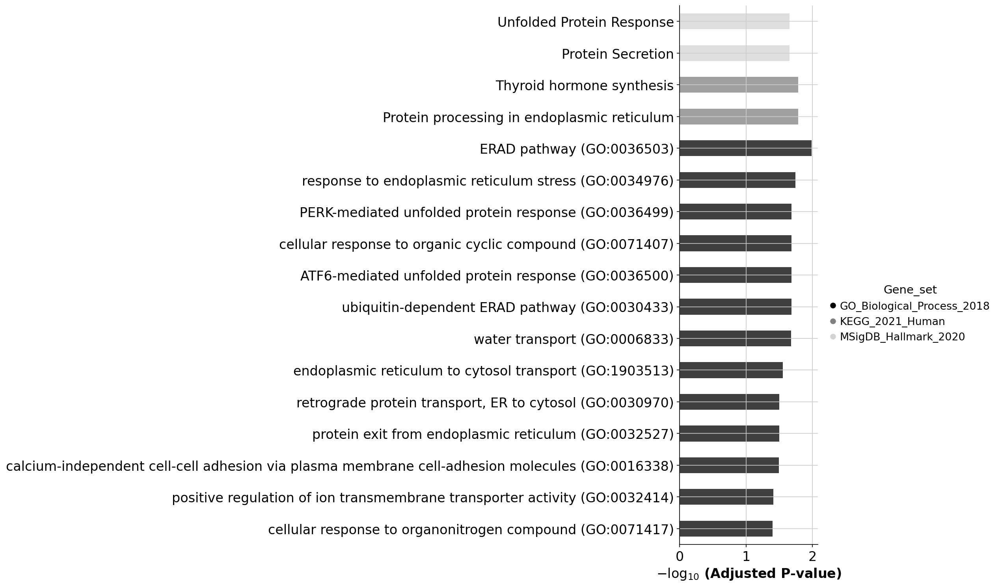

In [230]:
# categorical scatterplot
ax = barplot(enr.results, 
              column="Adjusted P-value", 
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10, 
              top_term=20,
              figsize=(3,12), 
              color=['black', 'grey','lightgrey'], # set colors for group
             )

In [231]:
ax.figure.savefig('Gene_set_healthy_duodenum_vs_healthy_stomach.pdf',bbox_inches='tight')
enr.results.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/DGE/Gene_set_healthy_duodenum_vs_healthy_stomach.csv')

In [232]:
dge_save = sc.get.rank_genes_groups_df(muc6_nonfetal_deg, group='duodenum_control', 
                                    key='wilcoxon')
dge_save.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/DGE/DGE_scanpy_healthy_duodenum_vs_healthy_stomach.csv')

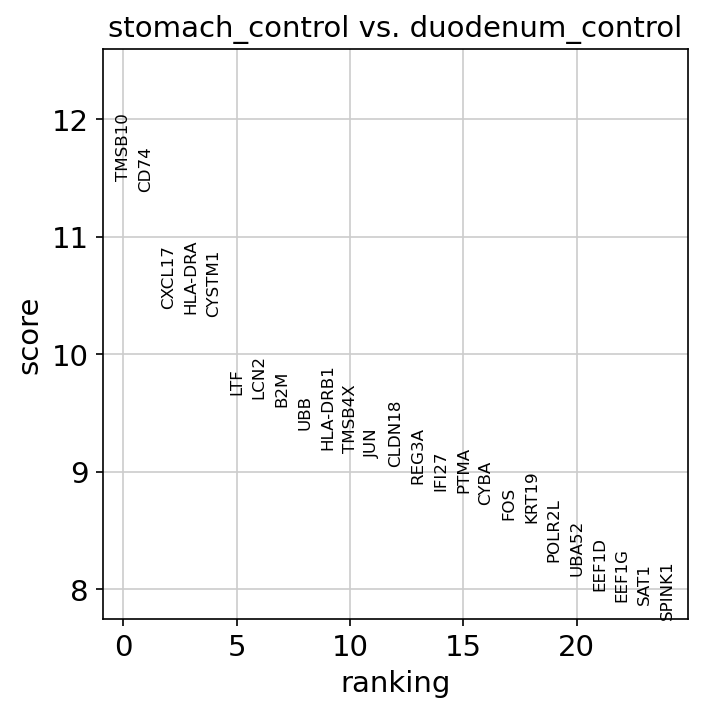

In [233]:
plt.rcParams['figure.figsize'] = [5,5]
sc.tl.rank_genes_groups(muc6_nonfetal_deg,groupby='organ_disease2',groups=['stomach_control'], reference='duodenum_control', method='wilcoxon',key_added = "wilcoxon")
sc.pl.rank_genes_groups(muc6_nonfetal_deg, n_genes=25, sharey=False, key="wilcoxon")

In [234]:
#?gseapy.enrichr
glist = sc.get.rank_genes_groups_df(muc6_nonfetal_deg, group='stomach_control', 
                                    key='wilcoxon', log2fc_min=0.25, 
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(glist))

303


In [235]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=glist, # or "./tests/data/gene_list.txt", 
                 gene_sets=['MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Biological_Process_2018'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

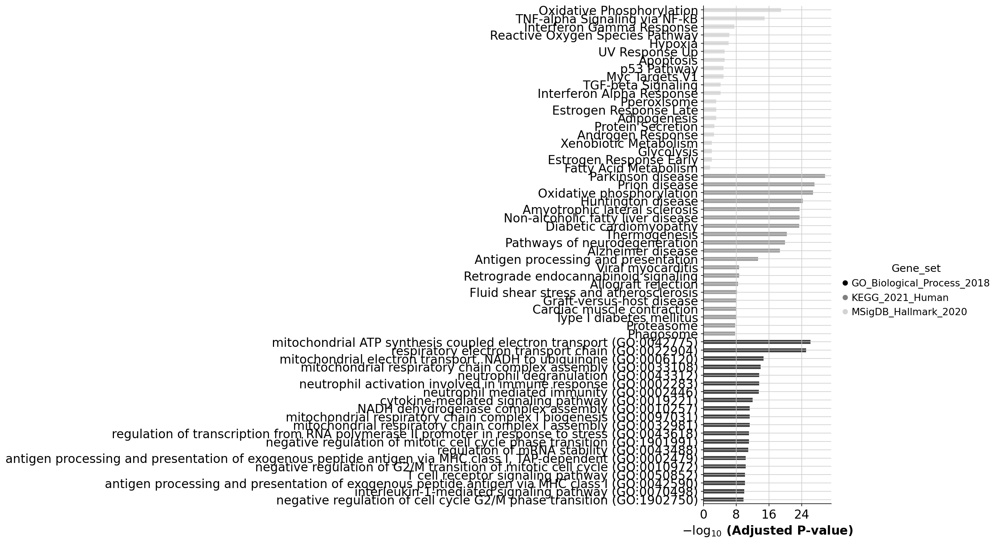

In [236]:
# categorical scatterplot
ax = barplot(enr.results, 
              column="Adjusted P-value", 
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10, 
              top_term=20,
              figsize=(3,12), 
              color=['black', 'grey','lightgrey'], # set colors for group
             )

In [237]:
ax.figure.savefig('Gene_set_healthy_stomach_vs_healthy_duodenum.pdf',bbox_inches='tight')
enr.results.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/DGE/Gene_set_healthy_stomach_vs_healthy_duodenum.csv')

In [239]:
dge_save = sc.get.rank_genes_groups_df(muc6_nonfetal_deg, group='stomach_control', 
                                    key='wilcoxon')
dge_save.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/DGE/DGE_scanpy_healthy_stomach_vs_healthy_duodenum.csv')

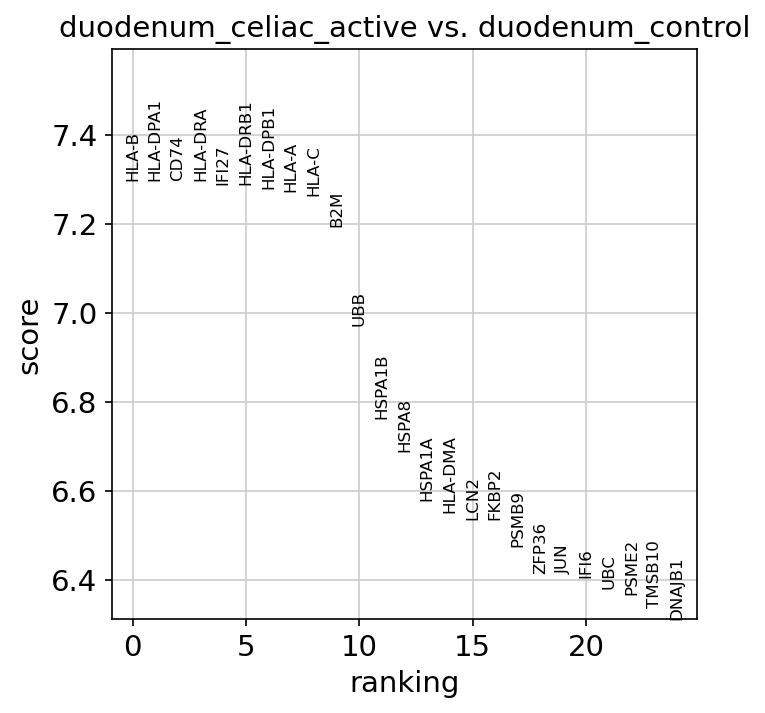

In [240]:
plt.rcParams['figure.figsize'] = [5,5]
sc.tl.rank_genes_groups(muc6_nonfetal_deg,groupby='organ_disease2',groups=['duodenum_celiac_active'], reference='duodenum_control', method='wilcoxon',key_added = "wilcoxon")
sc.pl.rank_genes_groups(muc6_nonfetal_deg, n_genes=25, sharey=False, key="wilcoxon")

In [242]:
#?gseapy.enrichr
glist = sc.get.rank_genes_groups_df(muc6_nonfetal_deg, group='duodenum_celiac_active', 
                                    key='wilcoxon', log2fc_min=0.25, 
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(glist))

652


In [243]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=glist, # or "./tests/data/gene_list.txt", 
                 gene_sets=['MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Biological_Process_2018'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

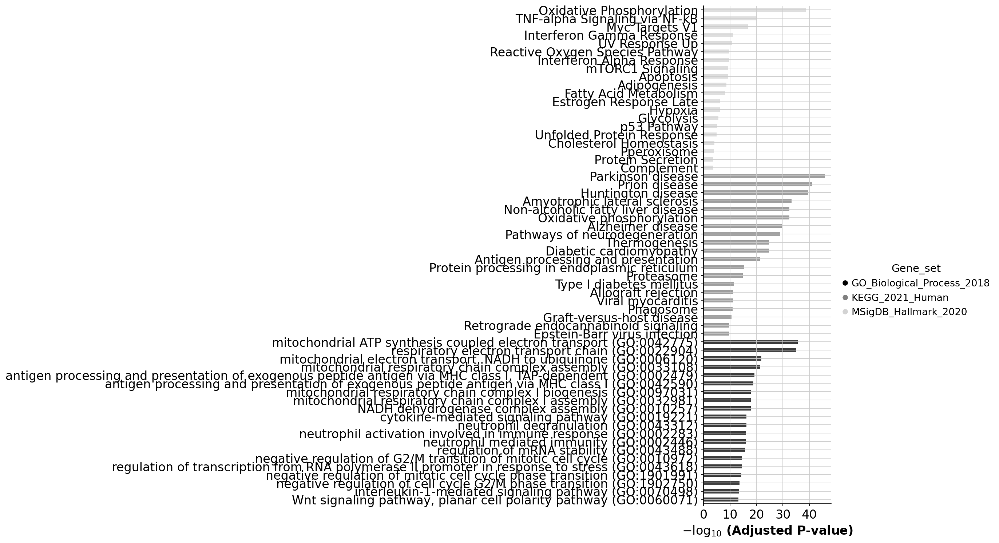

In [244]:
# categorical scatterplot
ax = barplot(enr.results, 
              column="Adjusted P-value", 
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10, 
              top_term=20,
              figsize=(3,12), 
              color=['black', 'grey','lightgrey'], # set colors for group
             )

In [245]:
ax.figure.savefig('Gene_set_celiac_vs_healthy_duodenum.pdf',bbox_inches='tight')
enr.results.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/DGE/Gene_set_celiac_vs_healthy_duodenum.csv')

In [246]:
dge_save = sc.get.rank_genes_groups_df(muc6_nonfetal_deg, group='duodenum_celiac_active', 
                                    key='wilcoxon')
dge_save.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/duplicated_notebook/DGE/DGE_scanpy_celiac_vs_healthy_duodenum.csv')

### Now to find how many marker genes are overlapping between ileum IBD MUC6 cells, healthy stomach MUC6 cells and healthy duodenum MUC6 cells
1. make reference dataset and make comparisons of each to the reference (other epithelial cells from intestine and stomach combined?

In [247]:
epi = full_adata[full_adata.obs.level_1_annot.isin(['Epithelial'])].copy()

In [248]:
epi

AnnData object with n_obs × n_vars = 659483 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_sp

In [249]:
epi.obs.organ_groups.unique()

array(['Oral_mucosa', 'Small_intestine', 'Stomach', 'Salivary_gland',
       'Large_intestine', 'Oesophagus'], dtype=object)

In [250]:
epi_organ = epi[epi.obs.organ_groups.isin(['Small_intestine', 'Stomach'])]

In [251]:
epi_organ

View of AnnData object with n_obs × n_vars = 344850 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_coun

In [252]:
epi_organ.obs['organ_disease'] = epi_organ.obs['organ_unified'].astype(str)+'_'+epi_organ.obs['disease'].astype(str)
epi_organ.obs.organ_disease.value_counts()

ileum_neighbouring_inflammed              103590
ileum_control                              50766
stomach_neighbouring_cancer                39783
stomach_cancer_gastric                     26252
ileum_crohns_disease                       24478
ileum_inutero                              23626
duodenum_inutero                           23555
duodenum_control                           12671
ileum_neighbouring_cancer                   8121
jejunum_control                             7456
ileum_pediatric_IBD                         5212
ileum_neighbouring_polyps                   4710
small intestine_control                     3254
small intestine_preterm                     2927
stomach_control                             2778
small intestine_inutero                     1594
stomach_inutero                             1277
jejunum_inutero                              898
duodenum_celiac_active                       896
duodenum_celiac_treated                      734
intestine_preterm   

In [253]:
epi_organ_age = epi_organ[~epi_organ.obs.disease.isin(['inutero','preterm'])].copy()

In [254]:
epi_organ_age.obs['organ_disease_celltype'] = epi_organ_age.obs['organ_disease'].astype(str)+'_'+epi_organ_age.obs['level_3_annot'].astype(str)
epi_organ_age.obs.organ_disease_celltype.value_counts()

ileum_neighbouring_inflammed_Enterocyte          53954
ileum_control_Enterocyte                         34776
ileum_neighbouring_inflammed_TA                  26391
stomach_neighbouring_cancer_Mucous_gland_neck    11669
stomach_neighbouring_cancer_Cycling              10019
                                                 ...  
MLN_control_Enterocyte                               1
jejunum_control_Paneth                               1
ileum_control_Mucous_gland_neck                      1
duodenum_celiac_treated_Mucous_gland_neck            1
duodenum_celiac_treated_Surface_foveolar             1
Name: organ_disease_celltype, Length: 181, dtype: int64

In [255]:
pd.set_option('display.max_rows', 500)
epi_organ_age.obs.organ_disease_celltype.value_counts()

ileum_neighbouring_inflammed_Enterocyte                     53954
ileum_control_Enterocyte                                    34776
ileum_neighbouring_inflammed_TA                             26391
stomach_neighbouring_cancer_Mucous_gland_neck               11669
stomach_neighbouring_cancer_Cycling                         10019
ileum_crohns_disease_Enterocyte                              9133
stomach_cancer_gastric_Cycling                               8659
duodenum_control_Enterocyte                                  8446
stomach_neighbouring_cancer_Surface_foveolar                 8048
ileum_crohns_disease_TA                                      7898
ileum_control_TA                                             7320
stomach_cancer_gastric_Mucous_gland_neck                     6136
ileum_neighbouring_inflammed_Goblet                          5832
jejunum_control_Enterocyte                                   5590
ileum_neighbouring_cancer_Enterocyte                         5454
stomach_ca

In [256]:
epi_organ_age = epi_organ_age[~epi_organ_age.obs.organ_disease_celltype.isin(['ileum_control_Mucous_gland_neck','duodenum_celiac_treated_Mucous_gland_neck','jejunum_control_Mucous_gland_neck'])].copy()

In [257]:
list(epi_organ_age.obs.organ_disease_celltype.unique())

['duodenum_control_TA',
 'ileum_control_TA',
 'ileum_control_Microfold',
 'ileum_control_Enterocyte',
 'ileum_control_Epithelial_stem',
 'stomach_control_Surface_foveolar',
 'stomach_control_Mucous_gland_neck',
 'stomach_control_Cycling',
 'stomach_control_Pareital',
 'stomach_control_Enteroendocrine_MX',
 'stomach_control_Enterochromaffin',
 'stomach_control_Chief',
 'stomach_control_Enteroendocrine_G',
 'stomach_control_Goblet_progenitor',
 'stomach_control_Goblet',
 'stomach_control_Enteroendocrine',
 'stomach_control_Enterocyte',
 'stomach_control_Enteroendocrine_X',
 'ileum_control_Goblet_cycling',
 'ileum_control_Goblet_progenitor',
 'ileum_control_BEST4_enterocyte_colonocyte',
 'ileum_control_Goblet',
 'ileum_control_Tuft',
 'ileum_control_Enteroendocrine',
 'ileum_control_Surface_foveolar',
 'ileum_control_Paneth',
 'duodenum_control_Enterocyte',
 'duodenum_control_BEST4_enterocyte_colonocyte',
 'duodenum_control_Epithelial_stem',
 'duodenum_control_Goblet_progenitor',
 'duoden

In [326]:
#remove other disease cell types so comapring MUC6 to healthy only
epi_organ_age = epi_organ_age[epi_organ_age.obs.organ_disease_celltype.isin(['duodenum_control_TA',
 'ileum_control_TA',
 'ileum_control_Microfold',
 'ileum_control_Enterocyte',
 'ileum_control_Epithelial_stem',
 'stomach_control_Surface_foveolar',
 'stomach_control_Mucous_gland_neck',
 'stomach_control_Cycling',
 'stomach_control_Pareital',
 'stomach_control_Enteroendocrine_MX',
 'stomach_control_Enterochromaffin',
 'stomach_control_Chief',
 'stomach_control_Enteroendocrine_G',
 'stomach_control_Goblet_progenitor',
 'stomach_control_Goblet',
 'stomach_control_Enteroendocrine',
 'stomach_control_Enterocyte',
 'stomach_control_Enteroendocrine_X',
 'ileum_control_Goblet_cycling',
 'ileum_control_Goblet_progenitor',
 'ileum_control_BEST4_enterocyte_colonocyte',
 'ileum_control_Goblet',
 'ileum_control_Tuft',
 'ileum_control_Enteroendocrine',
 'ileum_control_Surface_foveolar',
 'ileum_control_Paneth',
 'duodenum_control_Enterocyte',
 'duodenum_control_BEST4_enterocyte_colonocyte',
 'duodenum_control_Epithelial_stem',
 'duodenum_control_Goblet_progenitor',
 'duodenum_control_Goblet',
 'duodenum_control_Tuft',
 'ileum_neighbouring_polyps_TA',
 'ileum_neighbouring_polyps_Tuft',
 'ileum_neighbouring_polyps_Microfold',
 'ileum_neighbouring_polyps_Enteroendocrine',
 'ileum_neighbouring_polyps_Enterocyte',
 'ileum_neighbouring_polyps_BEST4_enterocyte_colonocyte',
 'ileum_neighbouring_polyps_Epithelial_stem',
 'ileum_neighbouring_polyps_Goblet_cycling',
 'ileum_neighbouring_polyps_Paneth',
 'ileum_neighbouring_polyps_Goblet_progenitor',
 'ileum_neighbouring_polyps_Goblet',
 'ileum_neighbouring_polyps_Surface_foveolar',
 'duodenum_control_Surface_foveolar',
 'duodenum_control_Goblet_cycling',
 'duodenum_control_Mucous_gland_neck',
 'duodenum_control_Enteroendocrine',
 'jejunum_control_TA',
 'jejunum_control_Enterocyte',
 'jejunum_control_BEST4_enterocyte_colonocyte',
 'jejunum_control_Epithelial_stem',
 'jejunum_control_Goblet_cycling',
 'jejunum_control_Tuft',
 'jejunum_control_Surface_foveolar',
 'jejunum_control_Goblet',
 'duodenum_control_Microfold',
 'jejunum_control_Microfold',
 'jejunum_control_Goblet_progenitor',
 'jejunum_control_Enteroendocrine',
 'jejunum_control_Paneth',
 'MLN_control_Enterocyte',
 'MLN_control_TA',
 'small intestine_control_Enterocyte',
 'small intestine_control_BEST4_enterocyte_colonocyte',
 'small intestine_control_TA',
 'small intestine_control_Tuft',
 'small intestine_control_Enteroendocrine',
 'small intestine_control_Goblet_progenitor',
 'small intestine_control_Epithelial_stem',
 'small intestine_control_Goblet',
 'small intestine_control_Goblet_cycling',
 'ileum_neighbouring_inflammed_TA',
 'ileum_neighbouring_inflammed_Surface_foveolar',
 'ileum_neighbouring_inflammed_Enterocyte',
 'small intestine_neighbouring_inflammed_TA',
 'stomach_neighbouring_cancer_Surface_foveolar',
 'stomach_neighbouring_cancer_Pareital',
 'stomach_neighbouring_cancer_Cycling',
 'stomach_neighbouring_cancer_Mucous_gland_neck',
 'stomach_neighbouring_cancer_Chief',
 'stomach_neighbouring_cancer_Gastric_fetal_epithelial',
 'stomach_neighbouring_cancer_Enterocyte',
 'stomach_neighbouring_cancer_Enterochromaffin',
 'stomach_neighbouring_cancer_Goblet',
 'stomach_neighbouring_cancer_Enteroendocrine_X',
 'stomach_neighbouring_cancer_Enteroendocrine',
 'stomach_neighbouring_cancer_Enteroendocrine_MX',
 'stomach_neighbouring_cancer_BEST4_enterocyte_colonocyte',
 'stomach_neighbouring_cancer_Enteroendocrine_G',
 'stomach_neighbouring_cancer_Goblet_progenitor',
 'ileum_neighbouring_inflammed_Epithelial_stem',
 'ileum_neighbouring_inflammed_Goblet_progenitor',
 'ileum_neighbouring_inflammed_Enteroendocrine',
 'ileum_neighbouring_inflammed_Microfold',
 'ileum_neighbouring_inflammed_Goblet_cycling',
 'ileum_neighbouring_inflammed_Paneth',
 'ileum_neighbouring_inflammed_Goblet',
 'ileum_neighbouring_inflammed_BEST4_enterocyte_colonocyte',
 'ileum_neighbouring_inflammed_Tuft',
 'ileum_neighbouring_cancer_Enteroendocrine',
 'ileum_neighbouring_cancer_Enterocyte',
 'ileum_neighbouring_cancer_TA',
 'ileum_neighbouring_cancer_Goblet',
 'ileum_neighbouring_cancer_Tuft',
 'ileum_neighbouring_cancer_Goblet_cycling',
 'ileum_neighbouring_cancer_Goblet_progenitor',
 'ileum_neighbouring_cancer_Epithelial_stem',
 'ileum_neighbouring_cancer_Paneth',
 'ileum_neighbouring_cancer_BEST4_enterocyte_colonocyte',
 'ileum_neighbouring_cancer_Surface_foveolar',
 'duodenum_control_Paneth',
 #'ileum_pediatric_IBD_Goblet_cycling',
 #'ileum_pediatric_IBD_TA',
 #'ileum_pediatric_IBD_Goblet_progenitor',
 #'ileum_pediatric_IBD_Enterocyte',
 #'ileum_pediatric_IBD_Epithelial_stem',
 #'ileum_pediatric_IBD_Enteroendocrine',
 #'ileum_pediatric_IBD_Microfold',
 #'ileum_pediatric_IBD_Goblet',
 #'ileum_pediatric_IBD_BEST4_enterocyte_colonocyte',
 #'ileum_pediatric_IBD_Tuft',
 #'ileum_pediatric_IBD_Paneth',
 'ileum_pediatric_IBD_Mucous_gland_neck',
 #'ileum_pediatric_IBD_Surface_foveolar',
 #'ileum_crohns_disease_TA',
 #'ileum_crohns_disease_Enterocyte',
 #'ileum_crohns_disease_Epithelial_stem',
 #'ileum_crohns_disease_Goblet',
 #'ileum_crohns_disease_Goblet_progenitor',
 #'ileum_crohns_disease_BEST4_enterocyte_colonocyte',
 #'ileum_crohns_disease_Tuft',
 #'ileum_crohns_disease_Enteroendocrine',
 #'ileum_crohns_disease_Goblet_cycling',
 #'ileum_crohns_disease_Paneth',
 'ileum_crohns_disease_Mucous_gland_neck',
 #'ileum_crohns_disease_Surface_foveolar',
 #'ileum_crohns_disease_Microfold',
 #'small intestine_crohns_disease_TA',
 #'stomach_cancer_gastric_Unknown',
 'stomach_cancer_gastric_Mucous_gland_neck',
 #'stomach_cancer_gastric_Surface_foveolar',
 #'stomach_cancer_gastric_Cycling',
 #'stomach_cancer_gastric_Chief',
 #'stomach_cancer_gastric_Goblet',
 #'stomach_cancer_gastric_Enterocyte',
 #'stomach_cancer_gastric_Enterochromaffin',
# 'stomach_cancer_gastric_Pareital',
# 'stomach_cancer_gastric_Enteroendocrine_MX',
 #'stomach_cancer_gastric_BEST4_enterocyte_colonocyte',
 #'stomach_cancer_gastric_Enteroendocrine_X',
 #'stomach_cancer_gastric_Goblet_progenitor',
 #'stomach_cancer_gastric_Enteroendocrine_G',
 #'stomach_cancer_gastric_Enteroendocrine',
 #'ileum_neighbouring_inflammed_Mucous_gland_neck',
 #'duodenum_celiac_active_Enterocyte',
 'duodenum_celiac_active_Mucous_gland_neck',
 #'duodenum_celiac_active_TA',
 #'duodenum_celiac_active_Enteroendocrine',
 #'duodenum_celiac_active_Surface_foveolar',
 #'duodenum_celiac_active_Tuft',
 #'duodenum_celiac_active_Goblet_cycling',
 #'duodenum_celiac_active_Goblet_progenitor',
 #'duodenum_celiac_active_Epithelial_stem',
 #'duodenum_celiac_active_Goblet',
 #'duodenum_celiac_active_BEST4_enterocyte_colonocyte',
 #'duodenum_celiac_active_Paneth',
# 'duodenum_celiac_treated_TA',
# 'duodenum_celiac_treated_Enterocyte',
# 'duodenum_celiac_treated_Enteroendocrine',
# 'duodenum_celiac_treated_Paneth',
# 'duodenum_celiac_treated_Tuft',
# 'duodenum_celiac_treated_Epithelial_stem',
# 'duodenum_celiac_treated_Goblet_cycling',
# 'duodenum_celiac_treated_Goblet_progenitor',
# 'duodenum_celiac_treated_BEST4_enterocyte_colonocyte',
# 'duodenum_celiac_treated_Goblet',
# 'duodenum_celiac_treated_Surface_foveolar'
                                                                            ])].copy()

In [260]:
stomach = epi_organ_age[~epi_organ_age.obs.organ_disease_celltype.isin(['ileum_pediatric_IBD_Mucous_gland_neck','duodenum_celiac_active_Mucous_gland_neck','ileum_neighbouring_inflammed_Mucous_gland_neck',
                                                                       'duodenum_control_Mucous_gland_neck','ileum_crohns_disease_Mucous_gland_neck',
                                                                        'stomach_cancer_gastric_Mucous_gland_neck'])].copy()
duodenum = epi_organ_age[~epi_organ_age.obs.organ_disease_celltype.isin(['ileum_pediatric_IBD_Mucous_gland_neck','duodenum_celiac_active_Mucous_gland_neck','ileum_neighbouring_inflammed_Mucous_gland_neck',
                                                                       'ileum_crohns_disease_Mucous_gland_neck','stomach_control_Mucous_gland_neck',
                                                                        'stomach_cancer_gastric_Mucous_gland_neck','stomach_neighbouring_cancer_Mucous_gland_neck'])].copy()
IBD = epi_organ_age[~epi_organ_age.obs.organ_disease_celltype.isin(['duodenum_celiac_active_Mucous_gland_neck','ileum_neighbouring_inflammed_Mucous_gland_neck',
                                                                       'duodenum_control_Mucous_gland_neck','stomach_control_Mucous_gland_neck',
                                                                        'stomach_cancer_gastric_Mucous_gland_neck','stomach_neighbouring_cancer_Mucous_gland_neck'])].copy()
celiac = epi_organ_age[~epi_organ_age.obs.organ_disease_celltype.isin(['ileum_pediatric_IBD_Mucous_gland_neck','ileum_neighbouring_inflammed_Mucous_gland_neck',
                                                                       'duodenum_control_Mucous_gland_neck','ileum_crohns_disease_Mucous_gland_neck','stomach_control_Mucous_gland_neck',
                                                                        'stomach_cancer_gastric_Mucous_gland_neck','stomach_neighbouring_cancer_Mucous_gland_neck'])].copy()

In [261]:
stomach

AnnData object with n_obs × n_vars = 233033 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_sp

In [262]:
stomach.obs.organ_disease_celltype.value_counts()

ileum_neighbouring_inflammed_Enterocyte                     53954
ileum_control_Enterocyte                                    34776
ileum_neighbouring_inflammed_TA                             26391
stomach_neighbouring_cancer_Mucous_gland_neck               11669
stomach_neighbouring_cancer_Cycling                         10019
duodenum_control_Enterocyte                                  8446
stomach_neighbouring_cancer_Surface_foveolar                 8048
ileum_control_TA                                             7320
ileum_neighbouring_inflammed_Goblet                          5832
jejunum_control_Enterocyte                                   5590
ileum_neighbouring_cancer_Enterocyte                         5454
ileum_neighbouring_inflammed_Goblet_progenitor               4555
stomach_neighbouring_cancer_Enterocyte                       3799
ileum_neighbouring_inflammed_Goblet_cycling                  3410
ileum_neighbouring_polyps_Enterocyte                         3215
ileum_neig

In [263]:
duodenum.obs.organ_disease_celltype.value_counts()

ileum_neighbouring_inflammed_Enterocyte                     53954
ileum_control_Enterocyte                                    34776
ileum_neighbouring_inflammed_TA                             26391
stomach_neighbouring_cancer_Cycling                         10019
duodenum_control_Enterocyte                                  8446
stomach_neighbouring_cancer_Surface_foveolar                 8048
ileum_control_TA                                             7320
ileum_neighbouring_inflammed_Goblet                          5832
jejunum_control_Enterocyte                                   5590
ileum_neighbouring_cancer_Enterocyte                         5454
ileum_neighbouring_inflammed_Goblet_progenitor               4555
stomach_neighbouring_cancer_Enterocyte                       3799
ileum_neighbouring_inflammed_Goblet_cycling                  3410
ileum_neighbouring_polyps_Enterocyte                         3215
ileum_neighbouring_inflammed_Epithelial_stem                 2987
ileum_neig

In [264]:
IBD.obs.organ_disease_celltype.value_counts()

ileum_neighbouring_inflammed_Enterocyte                     53954
ileum_control_Enterocyte                                    34776
ileum_neighbouring_inflammed_TA                             26391
stomach_neighbouring_cancer_Cycling                         10019
duodenum_control_Enterocyte                                  8446
stomach_neighbouring_cancer_Surface_foveolar                 8048
ileum_control_TA                                             7320
ileum_neighbouring_inflammed_Goblet                          5832
jejunum_control_Enterocyte                                   5590
ileum_neighbouring_cancer_Enterocyte                         5454
ileum_neighbouring_inflammed_Goblet_progenitor               4555
stomach_neighbouring_cancer_Enterocyte                       3799
ileum_neighbouring_inflammed_Goblet_cycling                  3410
ileum_neighbouring_polyps_Enterocyte                         3215
ileum_neighbouring_inflammed_Epithelial_stem                 2987
ileum_neig

In [265]:
IBD.obs.level_3_annot.value_counts()

Enterocyte                     117981
TA                              38816
Cycling                         10892
Surface_foveolar                 9957
Goblet                           9123
Goblet_progenitor                6732
Goblet_cycling                   5305
Epithelial_stem                  5005
Paneth                           3720
BEST4_enterocyte_colonocyte      3045
Tuft                             2256
Chief                            2006
Enteroendocrine                  1986
Pareital                         1180
Enterochromaffin                  886
Enteroendocrine_MX                596
Enteroendocrine_X                 463
Microfold                         423
Enteroendocrine_G                 420
Mucous_gland_neck                 167
Gastric_fetal_epithelial            5
Name: level_3_annot, dtype: int64

In [266]:
celiac.obs.organ_disease_celltype.value_counts()

ileum_neighbouring_inflammed_Enterocyte                     53954
ileum_control_Enterocyte                                    34776
ileum_neighbouring_inflammed_TA                             26391
stomach_neighbouring_cancer_Cycling                         10019
duodenum_control_Enterocyte                                  8446
stomach_neighbouring_cancer_Surface_foveolar                 8048
ileum_control_TA                                             7320
ileum_neighbouring_inflammed_Goblet                          5832
jejunum_control_Enterocyte                                   5590
ileum_neighbouring_cancer_Enterocyte                         5454
ileum_neighbouring_inflammed_Goblet_progenitor               4555
stomach_neighbouring_cancer_Enterocyte                       3799
ileum_neighbouring_inflammed_Goblet_cycling                  3410
ileum_neighbouring_polyps_Enterocyte                         3215
ileum_neighbouring_inflammed_Epithelial_stem                 2987
ileum_neig

In [267]:
#ok now we have 4 datasets, stomach, duodenum, IBD and celiac - where MUC6 cells are only from that healthy organ/disease, and other cells are a healthy reference to identify common marker genes

In [268]:
#generate gene lists
sc.tl.rank_genes_groups(stomach,groupby='level_3_annot',method='wilcoxon')
sto = sc.get.rank_genes_groups_df(stomach, group='Mucous_gland_neck',  
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(sto))

7650


In [269]:
sto

['PGC',
 'LYZ',
 'CXCL17',
 'LTF',
 'MUC6',
 'RPS17',
 'CLU',
 'MUC1',
 'LCN2',
 'RPL17',
 'CYSTM1',
 'REG3A',
 'EEF1G',
 'GLUL',
 'VSIG2',
 'ZG16B',
 'CLDN18',
 'BPIFB1',
 'AGR2',
 'NME2',
 'RPL36A',
 'CTSE',
 'CD59',
 'MIA',
 'TFF2',
 'GOLM1',
 'RPL31',
 'ANXA10',
 'MIF',
 'KCNE2',
 'TESC',
 'ATP6V1G1',
 'HLA-DPB1',
 'CA2',
 'GABARAP',
 'RPL36',
 'WFDC2',
 'FXYD3',
 'CD74',
 'RPL15',
 'FAM3D',
 'AQP5',
 'RPL18A',
 'RPL7',
 'RPL13',
 'SLPI',
 'RPS27',
 'RPL13A',
 'RPS18',
 'RPL27A',
 'LIPF',
 'RPL3',
 'RPS6',
 'C6orf58',
 'RPS19',
 'RPS2',
 'S100P',
 'RPL4',
 'RPL34',
 'MSMB',
 'RPL23',
 'LDHB',
 'RPL6',
 'SPINK1',
 'RPS10',
 'RPS20',
 'RPS4X',
 'RPL35',
 'RPL10A',
 'RPL39',
 'RPS28',
 'CXCL3',
 'RPS9',
 'RNASE4',
 'RPL26',
 'TSPO',
 'RPL32',
 'CFB',
 'RPL37A',
 'PSCA',
 'C16orf89',
 'SSR4',
 'RPL11',
 'EEF1D',
 'CD63',
 'NQO1',
 'RPSA',
 'RPL35A',
 'RPS14',
 'PSMA2',
 'RPL12',
 'RPL21',
 'RPS29',
 'NPM1',
 'RPL5',
 'SERPINA3',
 'RPL10',
 'RPS3',
 'TFF1',
 'S100A11',
 'CDC42EP1',
 'FM

In [270]:
#generate gene lists
sc.tl.rank_genes_groups(duodenum,groupby='level_3_annot',method='wilcoxon')
duo = sc.get.rank_genes_groups_df(duodenum, group='Mucous_gland_neck',  
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(duo))

456


In [271]:
duo

['MUC6',
 'PGC',
 'TFF2',
 'LYZ',
 'MT-ND4L',
 'AQP5',
 'MT-ATP8',
 'GP2',
 'C6orf58',
 'SOD3',
 'GOLM1',
 'MT-ND6',
 'MT-ND3',
 'NPDC1',
 'ONECUT2',
 'MT-ND5',
 'MUC1',
 'PKDCC',
 'PDIA2',
 'FMOD',
 'MT-ND1',
 'MT-CYB',
 'BPIFB1',
 'HERPUD1',
 'SYNE2',
 'KCNN4',
 'TESC',
 'MT-CO2',
 'SPOCK2',
 'KIAA1324',
 'TTC3',
 'LINC00261',
 'FARP1',
 'MT-ATP6',
 'SCG5',
 'MEIS2',
 'CLDN2',
 'MLPH',
 'CLU',
 'AGR2',
 'PMEPA1',
 'CA2',
 'NFIA',
 'MT-ND2',
 'DNAJC10',
 'SPDEF',
 'CFTR',
 'BACE2',
 'CRELD2',
 'PAM',
 'PRR4',
 'AK4',
 'CLDN10',
 'HSPG2',
 'FNDC3B',
 'C16orf89',
 'QSOX1',
 'KCNE2',
 'SLC9A3R2',
 'GLUL',
 'HDLBP',
 'APP',
 'WFDC2',
 'ERN2',
 'IMPDH1',
 'ANXA5',
 'CALU',
 'RAMP1',
 'VSIG2',
 'PDIA5',
 'MT-CO1',
 'SORBS2',
 'PROM1',
 'CREB3L1',
 'RARRES2',
 'FAM107B',
 'HOMER2',
 'CKAP4',
 'HSPA5',
 'MTUS1',
 'GALNT4',
 'RRBP1',
 'HM13',
 'SEC16A',
 'COL27A1',
 'SRRM2',
 'GPRC5C',
 'LENG8',
 'ACSL3',
 'GCC2',
 'CPD',
 'DDX39B',
 'CDC42EP1',
 'ERGIC1',
 'ANXA10',
 'SYVN1',
 'PDIA4',
 'ETFB

In [278]:
#generate gene lists
sc.tl.rank_genes_groups(IBD,groupby='level_3_annot',method='wilcoxon')
ibd = sc.get.rank_genes_groups_df(IBD, group='Mucous_gland_neck',  
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(ibd))

1152


In [279]:
ibd

['MUC6',
 'LYZ',
 'LCN2',
 'TFF3',
 'AGR2',
 'SPINK1',
 'ZG16B',
 'PGC',
 'IFI6',
 'CXCL2',
 'SLPI',
 'TIMP1',
 'BPIFB1',
 'MUC1',
 'TM4SF1',
 'CLDN2',
 'AQP5',
 'LIPF',
 'WFDC2',
 'HLA-DPA1',
 'C6orf58',
 'CXCL3',
 'PROM1',
 'MTRNR2L10',
 'MIA',
 'HLA-DPB1',
 'RPL34',
 'MTRNR2L6',
 'TESC',
 'MUC5B',
 'ODAM',
 'FMOD',
 'GLUL',
 'BACE2',
 'RHOB',
 'PRR4',
 'FAM3D',
 'MMP7',
 'RPL31',
 'SOX9',
 'S100P',
 'NUCB2',
 'RPL36A',
 'SOD3',
 'STAT1',
 'XIST',
 'IER3',
 'CD74',
 'HMGN3',
 'EGR1',
 'RPL26',
 'SERPINA3',
 'ATF3',
 'NUPR1',
 'RPL39',
 'ANXA5',
 'NPDC1',
 'IFI27',
 'SLC12A2',
 'MSLN',
 'XBP1',
 'GOLM1',
 'NNMT',
 'HLA-DRB5',
 'PRSS23',
 'IFITM3',
 'GDF15',
 'TCN1',
 'LTF',
 'SEC62',
 'RPS20',
 'BST2',
 'SCG5',
 'FGGY',
 'SMOC2',
 'GABRP',
 'KLF2',
 'RPS4X',
 'FOSB',
 'CXCR4',
 'SSR4',
 'MTRNR2L8',
 'HLA-DRA',
 'TMEM123',
 'GALNT7',
 'RPL37A',
 'PDIA4',
 'RNASE1',
 'LEFTY1',
 'RARRES2',
 'NR4A1',
 'EEF1A1',
 'CLU',
 'PHLDA1',
 'HSPA5',
 'SCGB3A1',
 'MECOM',
 'CXCL17',
 'IFI44L',
 'MTR

In [280]:
#generate gene lists
sc.tl.rank_genes_groups(celiac,groupby='level_3_annot',method='wilcoxon')
ced = sc.get.rank_genes_groups_df(celiac, group='Mucous_gland_neck',  
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(ced))

1671


In [281]:
ced

['MUC6',
 'PGC',
 'CD74',
 'LYZ',
 'HLA-DPB1',
 'GOLM1',
 'NPDC1',
 'CLU',
 'HLA-DPA1',
 'LY6E',
 'AGR2',
 'HLA-C',
 'ZG16B',
 'SSR4',
 'KCNE2',
 'HLA-DRB1',
 'HLA-B',
 'TFF2',
 'CYSTM1',
 'HSPA1B',
 'AQP5',
 'GP2',
 'PPIB',
 'MUC1',
 'DNAJB1',
 'HLA-DMA',
 'IFI6',
 'SLPI',
 'GPRC5C',
 'TESC',
 'UBB',
 'HSPA1A',
 'MT-ATP8',
 'ZFP36',
 'MIF',
 'PDIA2',
 'HLA-DRA',
 'PDIA3',
 'LCN2',
 'CA2',
 'PPDPF',
 'HLA-A',
 'B2M',
 'UBC',
 'RAMP1',
 'LDHB',
 'HSPA8',
 'CST3',
 'IFI27',
 'C6orf58',
 'SQSTM1',
 'SYNGR2',
 'TCN1',
 'S100A11',
 'HERPUD1',
 'FMOD',
 'RPN2',
 'JUN',
 'LGALS3BP',
 'ATP6V1G1',
 'HSP90AA1',
 'MLPH',
 'DNAJA1',
 'HSP90AB1',
 'C12orf57',
 'KCNN4',
 'IER2',
 'FKBP2',
 'CALR',
 'SAT1',
 'HLA-E',
 'BST2',
 'ATP6V0C',
 'CD63',
 'NME2',
 'SPDEF',
 'HSP90B1',
 'CXCL17',
 'ERP29',
 'BACE2',
 'RPL30',
 'GABARAP',
 'FKBP11',
 'GMDS',
 'NFKBIZ',
 'SEC62',
 'VSIG2',
 'JUNB',
 'GSTM3',
 'PRSS23',
 'HSPA5',
 'CD46',
 'CKB',
 'QSOX1',
 'FAM3B',
 'ATF3',
 'HLA-DRB5',
 'TMED9',
 'EEF1D',
 'RO

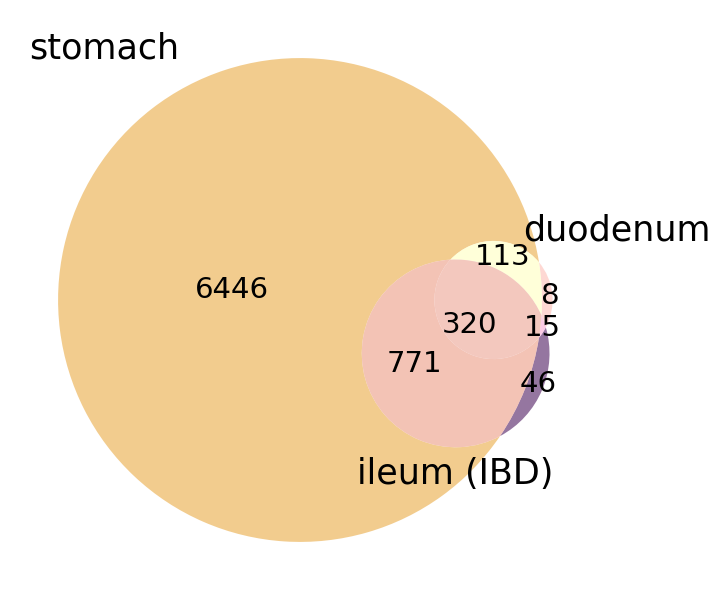

In [284]:
from matplotlib_venn import venn3
set1 = set(sto)
set2 = set(duo)
set3 = set(ibd)

venn3([set1, set2, set3], ('stomach', 'duodenum', 'ileum (IBD)'),set_colors=('#edb75f', '#fec8c1','#693C78'), alpha = 0.7)
plt.savefig('venn_MUC6_markers_test1.pdf')

plt.show()

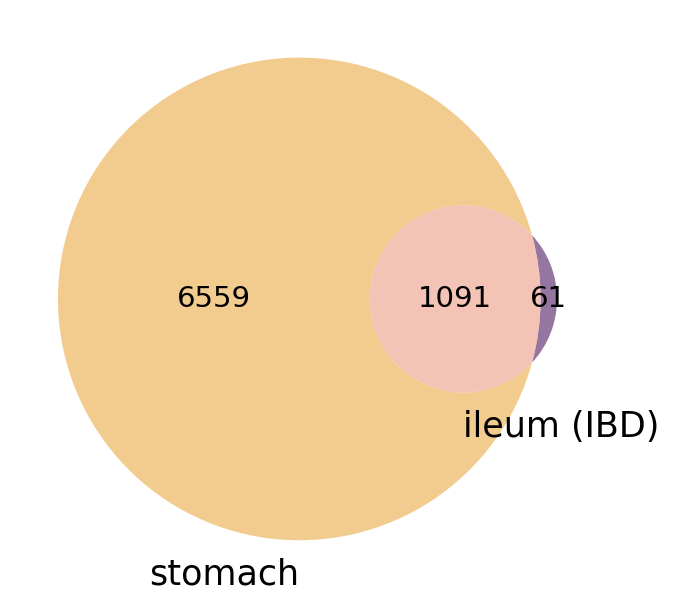

In [286]:
from matplotlib_venn import venn2
set1 = set(sto)
set2 = set(duo)
set3 = set(ibd)

venn2([set1, set3], ('stomach', 'ileum (IBD)'),set_colors=('#edb75f', '#693C78'), alpha = 0.7)

plt.show()

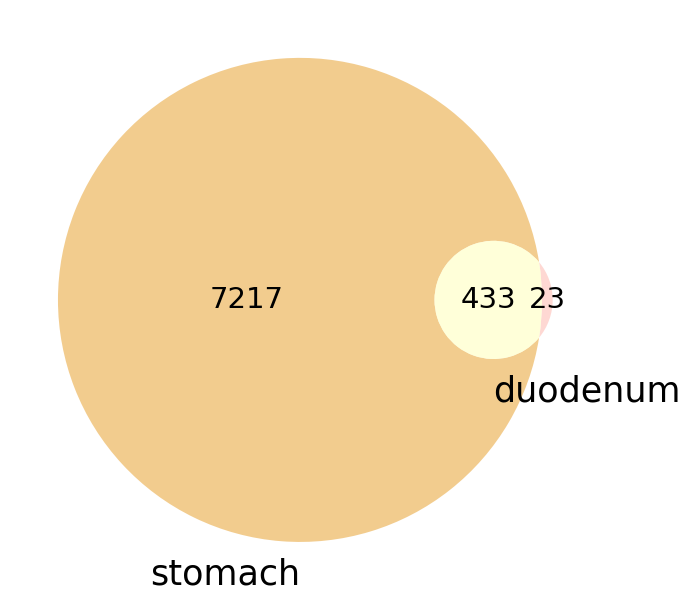

In [287]:
from matplotlib_venn import venn2
set1 = set(sto)
set2 = set(duo)
set3 = set(ibd)

venn2([set1, set2], ('stomach', 'duodenum'),set_colors=('#edb75f','#fec8c1'), alpha = 0.7)

plt.show()

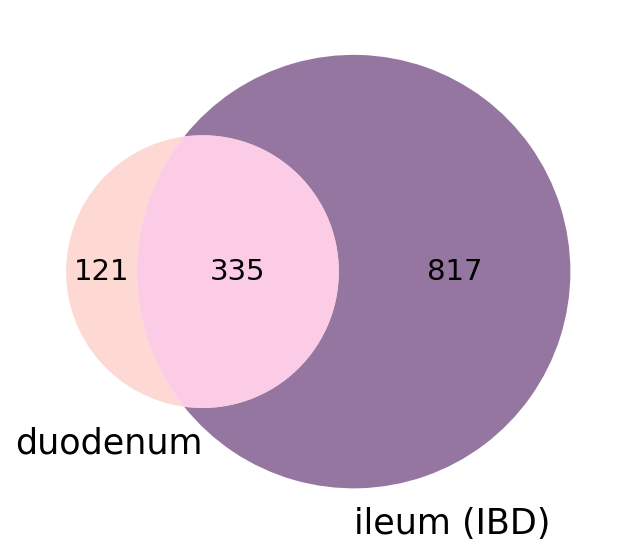

In [288]:
from matplotlib_venn import venn2
set1 = set(sto)
set2 = set(duo)
set3 = set(ibd)

venn2([ set2,set3], ('duodenum','ileum (IBD)'),set_colors=('#fec8c1', '#693C78'), alpha = 0.7)

plt.show()

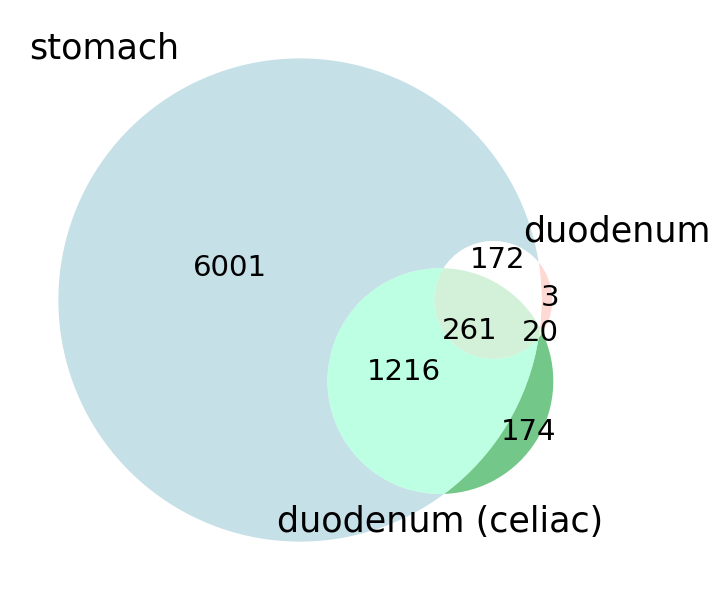

In [289]:
from matplotlib_venn import venn3
set1 = set(sto)
set2 = set(duo)
set4 = set(ced)

venn3([set1, set2, set4], ('stomach', 'duodenum', 'duodenum (celiac)'),set_colors=('#ADD3DD', '#fec8c1','#38B257'), alpha = 0.7)
plt.savefig('venn_MUC6_markers_test2.pdf')

plt.show()

#### Repeat but with downsampled per cell type per donor

In [317]:
#Prepare categories for downsampling (per donor_celltype combination)
epi_organ_age.obs['donor_celltype']=epi_organ_age.obs['donorID_unified'].astype(str)+'_'+epi_organ_age.obs['level_3_annot'].astype(str)
epi_organ_age.obs.donor_celltype.value_counts()

D207_Enterocyte                  22733
D207_TA                           9010
D168_Enterocyte                   8924
D11_Enterocyte                    6846
D216_Enterocyte                   5946
                                 ...  
D129_Enteroendocrine                 1
D206_Microfold                       1
D131_Gastric_fetal_epithelial        1
D131_Goblet                          1
D161_Mucous_gland_neck               1
Name: donor_celltype, Length: 1102, dtype: int64

In [323]:
epi_organ_age

AnnData object with n_obs × n_vars = 239431 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_sp

In [324]:
#function for downsampling
def downsample_mask(clustering, to_thin, n_cells=200):
    mask = np.array([i not in to_thin for i in clustering])
    numtemp = np.arange(len(clustering))
    for clus in to_thin:
        inds = set(numtemp[[i==clus for i in clustering]])
        keep = random.sample(inds, round(n_cells))
        mask[keep] = True
    return mask

In [328]:
#Downsample
vc=epi_organ_age.obs.donor_celltype.value_counts().loc[lambda x: x>100].reset_index()['index']
mask_p = downsample_mask(epi_organ_age.obs['donor_celltype'], vc.tolist(), n_cells=100)
epi_organ_age_downsample = epi_organ_age[mask_p]
epi_organ_age_downsample.obs.donor_celltype.value_counts()

D184_Goblet_cycling              100
D157_TA                          100
D157_Enterocyte                  100
D193_Goblet                      100
D112_Cycling                     100
                                ... 
D129_Enteroendocrine               1
D206_Microfold                     1
D131_Gastric_fetal_epithelial      1
D131_Goblet                        1
D161_Mucous_gland_neck             1
Name: donor_celltype, Length: 1102, dtype: int64

In [329]:
stomach = epi_organ_age_downsample[~epi_organ_age_downsample.obs.organ_disease_celltype.isin(['ileum_pediatric_IBD_Mucous_gland_neck','duodenum_celiac_active_Mucous_gland_neck','ileum_neighbouring_inflammed_Mucous_gland_neck',
                                                                       'duodenum_control_Mucous_gland_neck','ileum_crohns_disease_Mucous_gland_neck',
                                                                        'stomach_cancer_gastric_Mucous_gland_neck'])].copy()
duodenum = epi_organ_age_downsample[~epi_organ_age_downsample.obs.organ_disease_celltype.isin(['ileum_pediatric_IBD_Mucous_gland_neck','duodenum_celiac_active_Mucous_gland_neck','ileum_neighbouring_inflammed_Mucous_gland_neck',
                                                                       'ileum_crohns_disease_Mucous_gland_neck','stomach_control_Mucous_gland_neck',
                                                                        'stomach_cancer_gastric_Mucous_gland_neck','stomach_neighbouring_cancer_Mucous_gland_neck'])].copy()
IBD = epi_organ_age_downsample[~epi_organ_age_downsample.obs.organ_disease_celltype.isin(['duodenum_celiac_active_Mucous_gland_neck','ileum_neighbouring_inflammed_Mucous_gland_neck',
                                                                       'duodenum_control_Mucous_gland_neck','stomach_control_Mucous_gland_neck',
                                                                        'stomach_cancer_gastric_Mucous_gland_neck','stomach_neighbouring_cancer_Mucous_gland_neck'])].copy()
celiac = epi_organ_age_downsample[~epi_organ_age_downsample.obs.organ_disease_celltype.isin(['ileum_pediatric_IBD_Mucous_gland_neck','ileum_neighbouring_inflammed_Mucous_gland_neck',
                                                                       'duodenum_control_Mucous_gland_neck','ileum_crohns_disease_Mucous_gland_neck','stomach_control_Mucous_gland_neck',
                                                                        'stomach_cancer_gastric_Mucous_gland_neck','stomach_neighbouring_cancer_Mucous_gland_neck'])].copy()

In [330]:
#generate gene lists
sc.tl.rank_genes_groups(stomach,groupby='level_3_annot',method='wilcoxon')
sto = sc.get.rank_genes_groups_df(stomach, group='Mucous_gland_neck',  
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(sto))

6109


In [331]:
sto

['PGC',
 'LYZ',
 'MUC6',
 'CXCL17',
 'LTF',
 'MUC1',
 'RPS17',
 'CYSTM1',
 'CLU',
 'VSIG2',
 'CLDN18',
 'LCN2',
 'RPL17',
 'GLUL',
 'EEF1G',
 'LIPF',
 'CTSE',
 'ANXA10',
 'TESC',
 'ZG16B',
 'BPIFB1',
 'MIA',
 'KCNE2',
 'TFF2',
 'CA2',
 'NME2',
 'CD74',
 'AQP5',
 'HLA-DPB1',
 'C6orf58',
 'RPL36A',
 'GOLM1',
 'REG3A',
 'CD59',
 'AGR2',
 'PSCA',
 'MIF',
 'LDHB',
 'SLPI',
 'HLA-DRB1',
 'CFB',
 'HLA-DRA',
 'RPL31',
 'C16orf89',
 'CXCL3',
 'ATP6V1G1',
 'GABARAP',
 'FUT9',
 'FAM3D',
 'MSMB',
 'WFDC2',
 'A4GNT',
 'HLA-DMA',
 'RPL7',
 'ALDH3A1',
 'PSMA2',
 'SERPINA3',
 'CXCL2',
 'HLA-DPA1',
 'S100P',
 'RNASE4',
 'TM4SF1',
 'FMOD',
 'FOXQ1',
 'MMP1',
 'TMSB4X',
 'MECOM',
 'PDIA2',
 'COLCA1',
 'FXYD3',
 'ANKRD22',
 'SAT1',
 'GSTM3',
 'PIGR',
 'RPS19',
 'CST3',
 'ADAM28',
 'RPL18A',
 'CDC42EP1',
 'RPS27',
 'RPL34',
 'RPS18',
 'FXYD5',
 'MUC5AC',
 'EEF1D',
 'RPL15',
 'RPL36',
 'NDUFB8',
 'MRPS24',
 'NQO1',
 'RPL13A',
 'RPS20',
 'RPL27A',
 'TMEM97',
 'RNASEK',
 'LY6E',
 'RPS10',
 'RPL23',
 'TSPO',
 

In [332]:
#generate gene lists
sc.tl.rank_genes_groups(duodenum,groupby='level_3_annot',method='wilcoxon')
duo = sc.get.rank_genes_groups_df(duodenum, group='Mucous_gland_neck',  
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(duo))

581


In [333]:
duo

['MUC6',
 'PGC',
 'TFF2',
 'MT-ND4L',
 'MT-ATP8',
 'AQP5',
 'LYZ',
 'GP2',
 'C6orf58',
 'SOD3',
 'MT-ND6',
 'GOLM1',
 'ONECUT2',
 'MT-ND3',
 'MT-ND5',
 'PDIA2',
 'PKDCC',
 'FMOD',
 'MUC1',
 'BPIFB1',
 'NPDC1',
 'SPOCK2',
 'KCNN4',
 'FARP1',
 'CLDN2',
 'MEIS2',
 'MT-ND1',
 'MT-CYB',
 'MT-CO2',
 'TESC',
 'PMEPA1',
 'SCG5',
 'SYNE2',
 'CLDN10',
 'CA2',
 'AK4',
 'HSPG2',
 'PRR4',
 'C16orf89',
 'CFTR',
 'PAM',
 'MT-ATP6',
 'LINC00261',
 'HERPUD1',
 'NFIA',
 'FNDC3B',
 'CLU',
 'KCNE2',
 'IMPDH1',
 'HOMER2',
 'CRELD2',
 'RARRES2',
 'CCNL1',
 'SLC25A6',
 'NHSL1',
 'HEBP2',
 'BLVRB',
 'CAST',
 'SAT1',
 'SLC44A1',
 'EPS8L3',
 'ZFP36L1',
 'FXYD3',
 'CFDP1',
 'PLGRKT',
 'TSPAN8',
 'ALDH2',
 'TUBB4B',
 'EAPP',
 'RPL19',
 'CHMP3',
 'RPS4X',
 'NDUFA5',
 'SEC61G',
 'DEGS2',
 'CALR',
 'TMEM106C',
 'U2AF1',
 'PSMB4',
 'NEDD8',
 'DAZAP2',
 'RPL36A',
 'ARF1',
 'CHMP1B',
 'ATP6V0D1',
 'ISG15',
 'ACTR3',
 'ENPEP',
 'UQCRC1',
 'PSMD8',
 'CSTB',
 'ANP32B',
 'RBX1',
 'CEACAM5',
 'EIF4A2',
 'PHB',
 'PSMA5',
 'S

In [334]:
#generate gene lists
sc.tl.rank_genes_groups(IBD,groupby='level_3_annot',method='wilcoxon')
ibd = sc.get.rank_genes_groups_df(IBD, group='Mucous_gland_neck',  
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(ibd))

2195


In [335]:
ibd

['MUC6',
 'LYZ',
 'LCN2',
 'IFI6',
 'PGC',
 'ZG16B',
 'CXCL2',
 'SPINK1',
 'AGR2',
 'BPIFB1',
 'SLPI',
 'CLDN2',
 'TFF3',
 'AQP5',
 'TM4SF1',
 'HLA-DPA1',
 'TIMP1',
 'C6orf58',
 'LIPF',
 'HLA-DRA',
 'MTRNR2L10',
 'MIA',
 'CXCL3',
 'HLA-DPB1',
 'CD74',
 'WFDC2',
 'MUC1',
 'MUC5B',
 'PROM1',
 'ODAM',
 'MTRNR2L6',
 'HLA-DRB5',
 'MMP7',
 'IFI27',
 'TESC',
 'PRR4',
 'SOD3',
 'FMOD',
 'SERPINA3',
 'STAT1',
 'NNMT',
 'MSLN',
 'IFI44L',
 'HLA-DRB1',
 'NUPR1',
 'BST2',
 'TCN1',
 'PRSS23',
 'XIST',
 'PIGR',
 'CXCR4',
 'GABRP',
 'SCGB3A1',
 'GPRC5A',
 'LTF',
 'FGGY',
 'LEFTY1',
 'FAM3D',
 'RHOB',
 'ISG15',
 'CADM1',
 'RPL34',
 'BACE2',
 'A4GNT',
 'CRISP3',
 'RARRES2',
 'S100P',
 'GOLM1',
 'SMOC2',
 'C3',
 'SCG5',
 'OAS2',
 'HOXB8',
 'PART1',
 'SAA1',
 'SIK1',
 'VIM',
 'KLF2',
 'GDF15',
 'CDKN2B',
 'USP33',
 'SMC4',
 'GCLM',
 'UBTF',
 'TMF1',
 'EMC9',
 'DUS1L',
 'POLR2C',
 'NEAT1',
 'FGD5-AS1',
 'PTGER4',
 'LARP1',
 'RNF186',
 'CELF1',
 'BNIP3L',
 'EIF3B',
 'KATNBL1',
 'SPG7',
 'RPA3',
 'RBM23',
 

In [336]:
#generate gene lists
sc.tl.rank_genes_groups(celiac,groupby='level_3_annot',method='wilcoxon')
ced = sc.get.rank_genes_groups_df(celiac, group='Mucous_gland_neck',  
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(ced))

1191


In [337]:
ced

['MUC6',
 'CD74',
 'HLA-DPB1',
 'PGC',
 'GOLM1',
 'HLA-DPA1',
 'LYZ',
 'HLA-DRB1',
 'HLA-C',
 'CLU',
 'LY6E',
 'ZG16B',
 'NPDC1',
 'KCNE2',
 'HLA-B',
 'AQP5',
 'GP2',
 'MT-ATP8',
 'TFF2',
 'HLA-DRA',
 'HSPA1B',
 'AGR2',
 'HLA-DMA',
 'CYSTM1',
 'IFI6',
 'SSR4',
 'SLPI',
 'DNAJB1',
 'ZFP36',
 'TESC',
 'PPIB',
 'MUC1',
 'HSPA1A',
 'IFI27',
 'GPRC5C',
 'PDIA2',
 'UBB',
 'C6orf58',
 'B2M',
 'CST3',
 'LCN2',
 'TCN1',
 'HLA-A',
 'CA2',
 'MT-ND4L',
 'FMOD',
 'BST2',
 'HSPA8',
 'LGALS3BP',
 'LDHB',
 'KCNN4',
 'HLA-DRB5',
 'SAT1',
 'MIF',
 'SQSTM1',
 'UBC',
 'PPDPF',
 'PDIA3',
 'HSP90AA1',
 'SYNGR2',
 'ATP6V0C',
 'PRSS23',
 'RAMP1',
 'CXCL17',
 'FKBP2',
 'FAM3B',
 'RPN2',
 'ATP6V1G1',
 'JUN',
 'MLPH',
 'GSTM3',
 'CLDN2',
 'NFKBIZ',
 'HSP90AB1',
 'DNAJA1',
 'UBE2L6',
 'HERPUD1',
 'CALR',
 'VSIG2',
 'HLA-E',
 'S100A11',
 'ETV5',
 'GADD45B',
 'IER2',
 'NME2',
 'SPDEF',
 'ATF3',
 'HSPA5',
 'RHOB',
 'GABARAP',
 'ROMO1',
 'GMDS',
 'HSP90B1',
 'MAFF',
 'ERP29',
 'BACE2',
 'CXCL2',
 'IER3',
 'MSMB',
 'Q

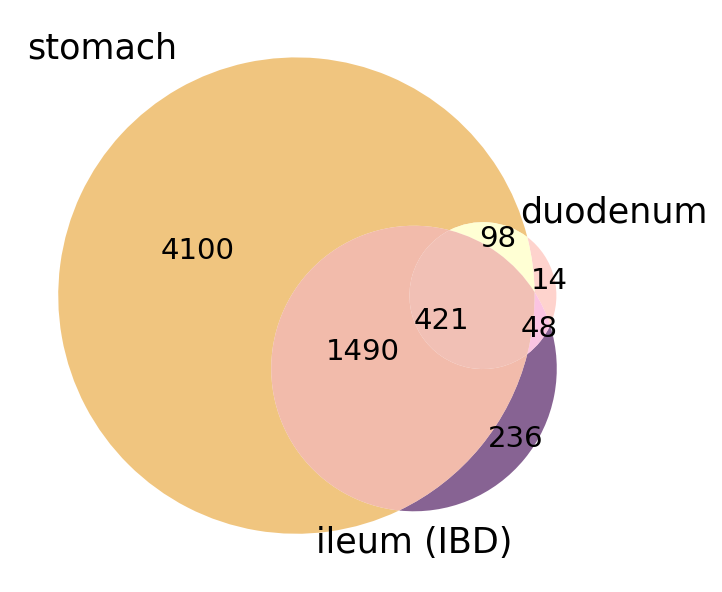

In [343]:
from matplotlib_venn import venn3
set1 = set(sto)
set2 = set(duo)
set3 = set(ibd)

venn3([set1, set2, set3], ('stomach', 'duodenum', 'ileum (IBD)'),set_colors=('#edb75f', '#fec8c1','#693C78'), alpha = 0.8)
plt.savefig('venn_MUC6_markers_test1.pdf')

plt.show()

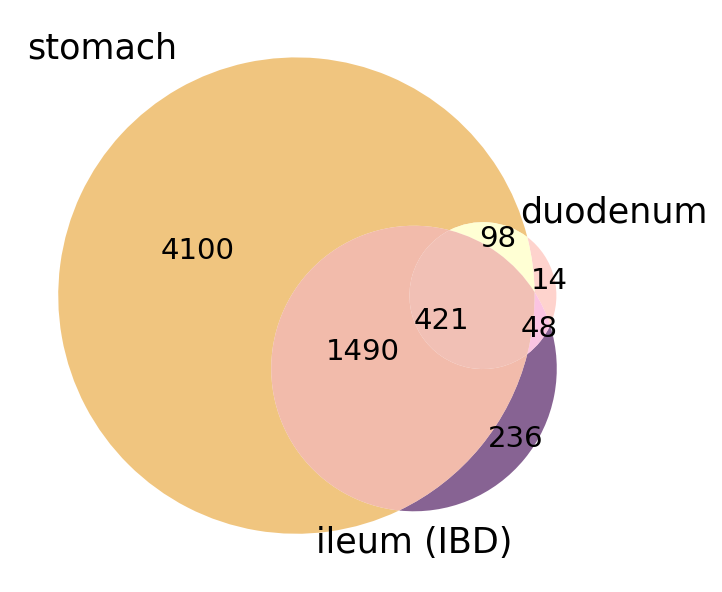

In [344]:
from matplotlib_venn import venn3
set1 = set(sto)
set2 = set(duo)
set3 = set(ibd)

venn3([set1, set2, set3], ('stomach', 'duodenum', 'ileum (IBD)'),set_colors=('#edb75f', '#fec8c1','#693C78'), alpha = 0.8)
plt.savefig('venn_MUC6_markers_test1.png')

plt.show()

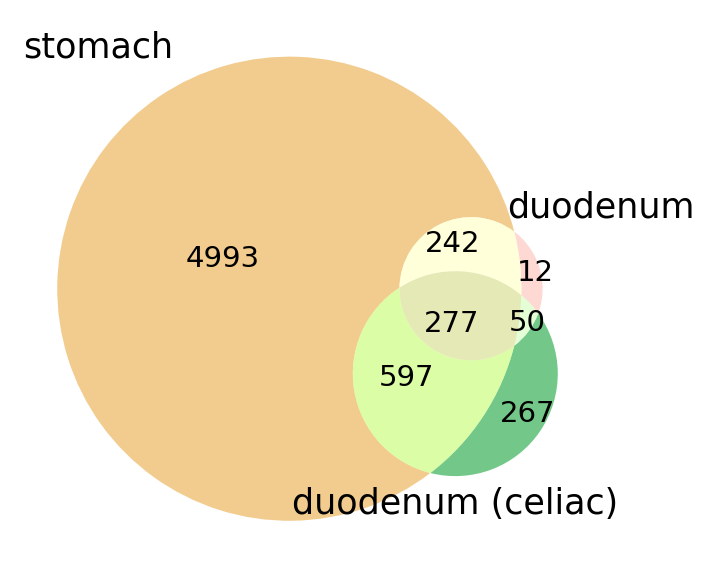

In [340]:
from matplotlib_venn import venn3
set1 = set(sto)
set2 = set(duo)
set4 = set(ced)

venn3([set1, set2, set4], ('stomach', 'duodenum', 'duodenum (celiac)'),set_colors=('#edb75f', '#fec8c1','#38B257'), alpha = 0.7)
plt.savefig('venn_MUC6_markers_test_downsampled.pdf')

plt.show()

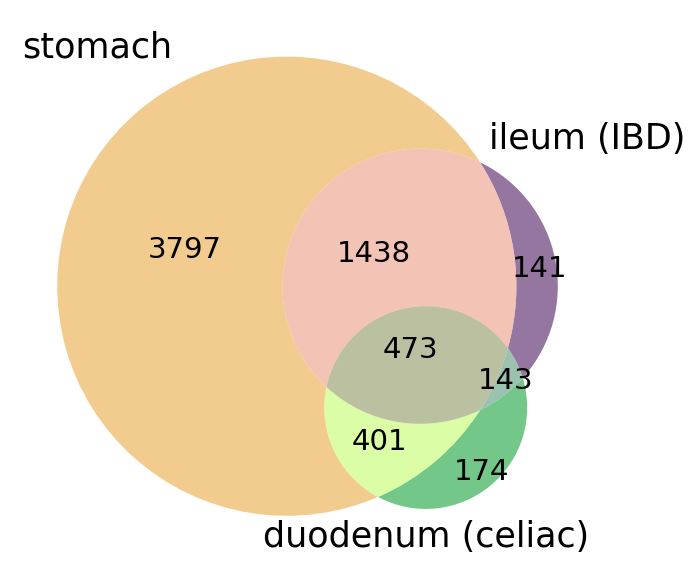

In [362]:
from matplotlib_venn import venn3
set1 = set(sto)
set3 = set(ibd)
set4 = set(ced)

venn3([set1, set3, set4], ('stomach', 'ileum (IBD)', 'duodenum (celiac)'),set_colors=('#edb75f', '#693C78','#38B257'), alpha = 0.7)
plt.savefig('venn_MUC6_markers_test_downsampled_ibd_celiac_sto.pdf')

plt.show()

In [345]:
#make overlapping gene lists

set1 = set(sto)
set2 = set(duo)
set3 = set(ibd)
#set4 = set(ced)

sto_vs_ibd = set1.intersection(set3)
print("Overlapping genes:", sto_vs_ibd)


Overlapping genes: {'SPEN', 'PSMB2', 'VIM', 'CMAS', 'STAU1', 'RPS3', 'PPP1R10', 'MT-CYB', 'PSMA3', 'DRAM2', 'KLF4', 'APOA4', 'BID', 'HIGD1A', 'CDKN1A', 'PUF60', 'KLF3', 'WAC', 'P4HTM', 'NUPR1', 'SEPHS2', 'KRTCAP3', 'ZG16', 'RPAIN', 'DHRS7', 'TMEM41A', 'RPLP0', 'TAX1BP1', 'DDX17', 'PTGR1', 'CD164', 'CHMP1A', 'CTSB', 'C3', 'XPNPEP1', 'MTRNR2L6', 'SEC23A', 'ARPC1A', 'ALYREF', 'COQ9', 'NUMA1', 'GCC2', 'TFF3', 'SOD1', 'YIPF3', 'VPS51', 'SPINT1', 'TIMM8B', 'RTN3', 'PLEK2', 'TMEM37', 'PNP', 'DHX15', 'BCAP31', 'ZBTB38', 'BAIAP2L2', 'ARL6IP4', 'PTMS', 'JAGN1', 'NDUFS4', 'IDH3G', 'ANAPC5', 'SORL1', 'BZW1', 'DNAJB6', 'HNRNPA3', 'RHOC', 'HNRNPA1', 'SLC35B1', 'HNRNPU', 'KRT19', 'LGALS3BP', 'NAP1L4', 'TNFRSF1A', 'EIF4B', 'GSS', 'C1QBP', 'FOXP1', 'MRPS6', 'CWC25', 'PSMB5', 'PPID', 'LPCAT3', 'HNRNPC', 'NFE2L2', 'MRPL28', 'SIK1', 'PDXDC1', 'TIMM44', 'CHCHD7', 'HINT1', 'TRIM14', 'HNRNPUL1', 'PSMB4', 'B3GALT5', 'ANPEP', 'MOGAT2', 'MAP7', 'SQSTM1', 'XRCC5', 'DCTN2', 'EIF3F', 'HIST1H4C', 'PXMP2', 'ELF3', '

In [346]:
all_common = set(sto_vs_ibd).intersection(set2)
print("Genes common across all MUC6 cells:", all_common)

Genes common across all MUC6 cells: {'RPL11', 'KRT8', 'A1CF', 'STAP2', 'ACSS2', 'BPIFB1', 'SUCLG1', 'CHCHD10', 'RPS3', 'LGALS4', 'MT-CYB', 'RAB25', 'KLF4', 'GSTO1', 'HIGD1A', 'CDKN1A', 'MUC2', 'CYP3A5', 'PSME2', 'GUCA2A', 'SNRPD3', 'RBM8A', 'ZG16', 'RPS24', 'PLAC8', 'MISP', 'GPA33', 'CLDN15', 'CD164', 'MT2A', 'ERBB3', 'AGPAT2', 'GUK1', 'RPL8', 'MDK', 'SOD1', 'FCGBP', 'TIMM8B', 'RPL7A', 'IL32', 'CBR1', 'ISG15', 'SRI', 'TMEM106C', 'ARL6IP4', 'NDUFB3', 'SOX4', 'HMGA1', 'HSP90AA1', 'CLCA1', 'HSPA1B', 'SRSF7', 'SNRPB', 'JUN', 'RHOC', 'HNRNPA1', 'GHITM', 'DEK', 'FCGRT', 'BUD31', 'ARPC5', 'KRT19', 'LGALS3BP', 'VPS28', 'RPL18', 'UBC', 'AOC1', 'EIF4A1', 'PSMA4', 'ETHE1', 'HADHB', 'TPM1', 'PLEKHJ1', 'HINT1', 'PSMB4', 'ACTB', 'TMBIM6', 'HLA-A', 'ATP6V0D1', 'DNAJA1', 'PRDX2', 'NDUFB10', 'NDUFS7', 'CLDN3', 'CLDN7', 'HIST1H4C', 'EIF6', 'ELF3', 'SERBP1', 'PTMA', 'TMEM54', 'IDH2', 'MT-ND4L', 'COX8A', 'RPL3', 'HLA-DRB1', 'EEF1B2', 'MRPL27', 'TXNDC17', 'PFDN5', 'RPL34', 'YWHAQ', 'YBX1', 'NDUFB11', 'DDC'

In [347]:
print(len(all_common))

421


In [348]:
genes_to_remove = set(all_common)
gene_list = list(filter(lambda gene: gene not in genes_to_remove, sto_vs_ibd))
print(gene_list)

['SPEN', 'PSMB2', 'VIM', 'CMAS', 'STAU1', 'PPP1R10', 'PSMA3', 'DRAM2', 'APOA4', 'BID', 'PUF60', 'KLF3', 'WAC', 'P4HTM', 'NUPR1', 'SEPHS2', 'KRTCAP3', 'RPAIN', 'DHRS7', 'TMEM41A', 'RPLP0', 'TAX1BP1', 'DDX17', 'PTGR1', 'CHMP1A', 'CTSB', 'C3', 'XPNPEP1', 'MTRNR2L6', 'SEC23A', 'ARPC1A', 'ALYREF', 'COQ9', 'NUMA1', 'GCC2', 'TFF3', 'YIPF3', 'VPS51', 'SPINT1', 'RTN3', 'PLEK2', 'TMEM37', 'PNP', 'DHX15', 'BCAP31', 'ZBTB38', 'BAIAP2L2', 'PTMS', 'JAGN1', 'NDUFS4', 'IDH3G', 'ANAPC5', 'SORL1', 'BZW1', 'DNAJB6', 'HNRNPA3', 'SLC35B1', 'HNRNPU', 'NAP1L4', 'TNFRSF1A', 'EIF4B', 'GSS', 'C1QBP', 'FOXP1', 'MRPS6', 'CWC25', 'PSMB5', 'PPID', 'LPCAT3', 'HNRNPC', 'NFE2L2', 'MRPL28', 'SIK1', 'PDXDC1', 'TIMM44', 'CHCHD7', 'TRIM14', 'HNRNPUL1', 'B3GALT5', 'ANPEP', 'MOGAT2', 'MAP7', 'SQSTM1', 'XRCC5', 'DCTN2', 'EIF3F', 'PXMP2', 'CLINT1', 'EFNB2', 'FAT1', 'BAZ2B', 'CASP4', 'TMEM208', 'YTHDF2', 'SNRPD2', 'HCCS', 'CKS2', 'PGP', 'TRABD2A', 'BAD', 'PAFAH1B3', 'BAK1', 'PAQR8', 'PFKL', 'RAB2A', 'RAD23B', 'TWF1', 'METRNL',

In [349]:
duo_vs_ibd = set2.intersection(set3)
print("Overlapping genes:", duo_vs_ibd)

Overlapping genes: {'RPL11', 'KRT8', 'A1CF', 'STAP2', 'ACSS2', 'BPIFB1', 'SUCLG1', 'CHCHD10', 'RPS3', 'LGALS4', 'MT-CYB', 'RAB25', 'EIF3K', 'KLF4', 'GSTO1', 'HIGD1A', 'CDKN1A', 'MUC2', 'CYP3A5', 'PSME2', 'GUCA2A', 'SNRPD3', 'RBM8A', 'ZG16', 'RPS24', 'PLAC8', 'MISP', 'GPA33', 'CLDN15', 'CD164', 'MT2A', 'ERBB3', 'AGPAT2', 'GUK1', 'RPL8', 'HNRNPA0', 'MDK', 'SOD1', 'FCGBP', 'TIMM8B', 'RPL7A', 'IL32', 'CBR1', 'ISG15', 'SRI', 'TMEM106C', 'ARL6IP4', 'NDUFB3', 'SOX4', 'HMGA1', 'HSP90AA1', 'CLCA1', 'HSPA1B', 'SRSF7', 'SNRPB', 'JUN', 'RHOC', 'HNRNPA1', 'GHITM', 'DEK', 'FCGRT', 'BUD31', 'ARPC5', 'KRT19', 'NDUFS8', 'LGALS3BP', 'PRDX5', 'VPS28', 'RPL18', 'UBC', 'AOC1', 'EIF4A1', 'PSMA4', 'ETHE1', 'HADHB', 'TPM1', 'PLEKHJ1', 'HINT1', 'PSMB4', 'ACTB', 'TMBIM6', 'HLA-A', 'ATP6V0D1', 'DNAJA1', 'PRDX2', 'NDUFB10', 'NDUFS7', 'CLDN3', 'CLDN7', 'HIST1H4C', 'NFKBIA', 'EIF6', 'ELF3', 'SERBP1', 'PTMA', 'TMEM54', 'IDH2', 'MT-ND4L', 'COX8A', 'RPL3', 'HLA-DRB1', 'EEF1B2', 'MRPL27', 'TXNDC17', 'PFDN5', 'RPL34', '

In [350]:
genes_to_remove = set(all_common)
gene_list = list(filter(lambda gene: gene not in genes_to_remove, duo_vs_ibd))
print(gene_list)

['EIF3K', 'HNRNPA0', 'NDUFS8', 'PRDX5', 'NFKBIA', 'SRP14', 'POMP', 'IFI27', 'TXN', 'UQCR10', 'NEDD8', 'PPA1', 'SLIRP', 'PFN1', 'EIF1', 'RAB11A', 'SCP2', 'DEGS2', 'PSMB3', 'NDUFA3', 'SOD3', 'BTG1', 'DDT', 'CLIC1', 'RPL30', 'TIMM13', 'NDUFA11', 'GPX2', 'NDUFS5', 'TMA7', 'CRIP1', 'FAU', 'CLTA', 'ALDH1A1', 'FTH1', 'UQCRH', 'FTL', 'RPL28', 'LAMTOR4', 'COX4I1', 'SF3B5', 'NDUFB2', 'PSMB6', 'SMIM22', 'SUB1', 'SKP1', 'CYB5A', 'UBB']


In [351]:
duo_vs_sto = set1.intersection(set2)
print("Overlapping genes:", duo_vs_sto)

Overlapping genes: {'RPL11', 'KRT8', 'A1CF', 'STAP2', 'MT-ND3', 'C16orf89', 'ACSS2', 'BPIFB1', 'RPS25', 'SUCLG1', 'CHCHD10', 'RPS3', 'LGALS4', 'RPS8', 'RPS16', 'MT-CYB', 'RAB25', 'KLF4', 'GSTO1', 'HIGD1A', 'CDKN1A', 'NFIA', 'MUC2', 'CYP3A5', 'PSME2', 'PAM', 'GUCA2A', 'SNRPD3', 'RBM8A', 'ZG16', 'RPS24', 'PLAC8', 'RPS28', 'MISP', 'GPA33', 'CLDN15', 'FKBP2', 'CD164', 'MT2A', 'ERBB3', 'RPL13A', 'AGPAT2', 'GUK1', 'NDUFB1', 'RPL39', 'RPL8', 'FNDC3B', 'MDK', 'ID2', 'SOD1', 'FCGBP', 'TIMM8B', 'RPL7A', 'CA2', 'RPL12', 'RPL7', 'IL32', 'CBR1', 'ISG15', 'SRI', 'TMEM106C', 'ARL6IP4', 'NDUFB3', 'SOX4', 'CTSS', 'HMGA1', 'HSP90AA1', 'RPL37A', 'CLCA1', 'HSPA1B', 'SRSF7', 'SNRPB', 'JUN', 'RHOC', 'HNRNPA1', 'GHITM', 'DEK', 'FCGRT', 'BUD31', 'ARPC5', 'KRT19', 'LGALS3BP', 'HOMER2', 'NDUFA4', 'VPS28', 'RPL18', 'NPDC1', 'GP2', 'UBC', 'AOC1', 'EIF4A1', 'PSMA4', 'ETHE1', 'HADHB', 'TPM1', 'PLEKHJ1', 'HINT1', 'PSMB4', 'ACTB', 'RPL27', 'TMBIM6', 'HLA-A', 'ATP6V0D1', 'DNAJA1', 'PRDX2', 'NDUFB10', 'NDUFS7', 'CLDN3'

In [352]:
genes_to_remove = set(all_common)
gene_list = list(filter(lambda gene: gene not in genes_to_remove, duo_vs_sto))
print(gene_list)

['MT-ND3', 'C16orf89', 'RPS25', 'RPS8', 'RPS16', 'NFIA', 'PAM', 'RPS28', 'FKBP2', 'RPL13A', 'NDUFB1', 'RPL39', 'FNDC3B', 'ID2', 'CA2', 'RPL12', 'RPL7', 'CTSS', 'RPL37A', 'HOMER2', 'NDUFA4', 'NPDC1', 'GP2', 'RPL27', 'SAT1', 'RPL27A', 'MT-ATP6', 'KCNN4', 'KCNE2', 'RPS13', 'ATF3', 'TFF2', 'IFI27L2', 'JUND', 'CRELD2', 'RPS14', 'SEC61G', 'ETS2', 'RPS15A', 'RPL9', 'RPL31', 'MT-ND1', 'HSPG2', 'CYBA', 'RPS4X', 'CLU', 'FARP1', 'HLA-F', 'ZFP36L1', 'MTRNR2L8', 'RPL32', 'HSPA1A', 'RPL21', 'PDIA2', 'RPS27A', 'CLDN10', 'RPS3A', 'RPS27', 'RPS23', 'RPS19', 'DUSP1', 'RPL23', 'ONECUT2', 'BTG2', 'PKDCC', 'TMSB4X', 'KLF6', 'RPL13', 'TSPAN8', 'RPL23A', 'HLA-E', 'CFTR', 'IRF1', 'RPL35A', 'RPL41', 'AGR3', 'RPS20', 'CALR', 'FXYD3', 'HLA-B', 'AK4', 'MCL1', 'RPL36A', 'RPL35', 'RPS6', 'SSR4', 'RPS18', 'RPL26', 'RPL10A', 'RPLP1', 'B2M', 'RPLP2', 'RPL22', 'RPS12', 'FOSB', 'MEIS2', 'IMPDH1', 'C4orf48']


In [353]:
set1 = set(sto)
genes_to_remove = set(duo)
gene_list = list(filter(lambda gene: gene not in genes_to_remove, set1))
genes_to_remove = set(ibd)
gene_list = list(filter(lambda gene: gene not in genes_to_remove, gene_list))
print(gene_list)

['MRPS10', 'TBK1', 'PHLDA2', 'RBP1', 'PHKB', 'MRPL38', 'ORC3', 'DAP', 'ZC3HAV1', 'CEP290', 'ADH6', 'HEATR5A', 'ARL14', 'MTR', 'ATP8A1', 'RAB11FIP3', 'AFAP1', 'AARS', 'STIM2', 'BTF3L4', 'TM9SF1', 'RFFL', 'LUC7L2', 'NUP85', 'DMXL1', 'RANGAP1', 'MED24', 'CACNA1A', 'RND3', 'WNK4', 'VWA5A', 'ASB8', 'YPEL5', 'APPBP2', 'GSTA2', 'CYB561A3', 'PRDM2', 'TPGS1', 'RSL24D1', 'ATN1', 'PRPSAP2', 'USP3', 'ZNF121', 'ZNF652', 'ALDH3A1', 'KIF4A', 'CKS1B', 'GRAMD4', 'FLVCR1', 'WDR55', 'TPP1', 'PCSK1N', 'NDC80', 'ZBTB44', 'MAOB', 'UPF1', 'ABHD5', 'MVD', 'CA8', 'LENG8', 'SCOC', 'TSEN34', 'MMP1', 'IER3', 'RPL17', 'GSK3B', 'YBEY', 'FBXO33', 'OGFR', 'ENPP2', 'CLIC5', 'POM121C', 'AP1AR', 'RNASEL', 'POLR2B', 'CIDEB', 'CDK1', 'CAPN12', 'CLCN3', 'MITF', 'PPIF', 'KIAA0355', 'CBX1', 'RAMP1', 'HYOU1', 'NDC1', 'GTF2H5', 'REPS1', 'UBE2J1', 'SUN2', 'MAP4', 'FAM13A', 'TRNP1', 'ETV6', 'RNF168', 'ZNF219', 'TMEM19', 'LHFPL2', 'RFX1', 'USP40', 'PCMTD1', 'MTHFR', 'ACHE', 'HBP1', 'SRRT', 'ERI3', 'ACSF3', 'SKIL', 'SARNP', 'STEAP

In [354]:
print(len(gene_list))

4100


In [355]:
set2 = set(duo)
genes_to_remove = set(sto)
gene_list = list(filter(lambda gene: gene not in genes_to_remove, set2))
genes_to_remove = set(ibd)
gene_list = list(filter(lambda gene: gene not in genes_to_remove, gene_list))
print(gene_list)

['ZFAS1', 'UQCRQ', 'UQCRB', 'ZFP36', 'SYNE2', 'TOMM7', 'PMEPA1', 'LINC00261', 'FOS', 'EGR1', 'HERPUD1', 'SPOCK2', 'RPS27L', 'COX7C']


In [356]:
set3 = set(ibd)
genes_to_remove = set(sto)
gene_list = list(filter(lambda gene: gene not in genes_to_remove, set3))
genes_to_remove = set(duo)
gene_list = list(filter(lambda gene: gene not in genes_to_remove, gene_list))
print(gene_list)

['TXN2', 'SUPT4H1', 'LRPAP1', 'MSLN', 'ADAM15', 'OXA1L', 'LEFTY1', 'SNRPG', 'SPCS1', 'VAPA', 'TMEM167A', 'HINT2', 'CCDC124', 'MRPS15', 'TMEM14B', 'LMAN2', 'PCNP', 'NAA10', 'SH3BGRL', 'DCTN3', 'SSBP1', 'SNRPD1', 'TOMM20', 'MRPL51', 'EIF2A', 'PRPF19', 'RFXANK', 'RAN', 'NAPA', 'MORF4L1', 'HID1', 'TSPAN15', 'OAS2', 'PROM1', 'ZNRD1', 'LEPROT', 'BST2', 'ABCC3', 'PCBP2', 'PFDN2', 'MRPL55', 'TMEM230', 'MRPL32', 'PLXNB2', 'EIF3M', 'MRPL52', 'COMT', 'COPZ1', 'PYURF', 'PIN4', 'TMEM256', 'PSMB7', 'LAMTOR5', 'EIF2S2', 'ETNK1', 'LTA4H', 'HSP90AB1', 'SLC44A4', 'DNPH1', 'EMC4', 'ANP32A', 'MRPL43', 'POLR2J', 'TXNL1', 'ZMAT2', 'MRPL22', 'ARL2', 'TIMM10', 'JOSD2', 'PSMG2', 'EIF3I', 'EIF3G', 'COTL1', 'TMEM134', 'APEX1', 'ATP6AP2', 'NT5DC1', 'CCS', 'DPY30', 'MAGOH', 'SUMO3', 'AP1M2', 'DDX39B', 'AKR7A3', 'APH1A', 'RPS4Y1', 'SARS', 'XIST', 'PSMA1', 'ANXA7', 'ANAPC11', 'MAL2', 'NDUFB5', 'SPAG7', 'TBCB', 'HDAC2', 'SUCLG2', 'IMP3', 'GDF15', 'ANXA4', 'SLC35A3', 'DRG1', 'PSMD9', 'CLPP', 'PRSS8', 'CDC37', 'YWHAE',

In [357]:
print(len(gene_list))

236


In [358]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=gene_list, # or "./tests/data/gene_list.txt", 
                 gene_sets=['MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Biological_Process_2018'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

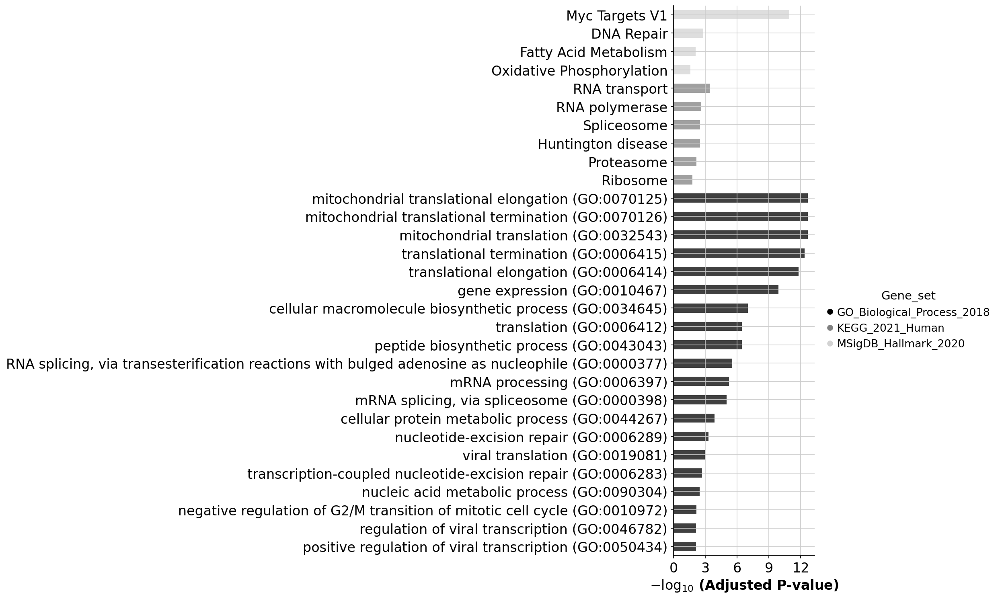

In [359]:
# categorical scatterplot
ax = barplot(enr.results, 
              column="Adjusted P-value", 
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10, 
              top_term=20,
              figsize=(3,12), 
              color=['black', 'grey','lightgrey'], # set colors for group
             )

try with all 4 categories???: https://github.com/tctianchi/pyvenn